In [ ]:
!pip install statsmodels
!pip install ruptures
!pip install ipdb
!pip install pwlf
import os
import ipdb
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima_process import ArmaProcess
from statsmodels.tsa.statespace.sarimax import SARIMAX
import statsmodels.api as sm
import random
import statsmodels.api as sm
from numpy.polynomial.polynomial import Polynomial
from statsmodels.tsa.filters.hp_filter import hpfilter
import pickle

!pip install arch
from arch import arch_model

### Data Generator Updated:

In [ ]:
class TimeSeriesGenerator:
    def __init__(self, length=None):
        self.length = length if length is not None else 400
        self.stationary_base_distributions = ['ar', 'ma', 'arma','white_noise']
        self.seasonal_base_distributions = ['sarma', 'sarima']
        self.volatile_base_distributions = ['arch', 'garch', 'egarch', 'aparch']
        self.stochastic_base_distributions = ['ari', 'ima', 'arima']
        self.characteristics = {'deterministic_trend_linear' : self.generate_deterministic_trend_linear,
        'deterministic_trend_cubic': self.generate_deterministic_trend_cubic,
        'deterministic_trend_quadratic': self.generate_deterministic_trend_quadratic,
        'deterministic_trend_exponential': self.generate_deterministic_trend_exponential,
        'deterministic_trend_damped': self.generate_deterministic_trend_damped,
        'stochastic_trend': self.generate_stochastic_trend,
        'single_seasonality': self.generate_single_seasonality,
        'multiple_seasonality': self.generate_multiple_seasonality,
        'single_point_anomaly' : self.generate_point_anomaly,
        'multiple_point_anomalies': self.generate_point_anomalies,
        'collective_anomalies': self.generate_collective_anomalies,
        'contextual_anomalies': self.generate_contextual_anomalies}
        self.structural_breaks = {'mean_shift': self.generate_mean_shift,
        'variance_shift': self.generate_variance_shift,
        'trend_shift': self.generate_trend_shift}

    #HELPER FUNCTIONS

    def z_normalize(self,series):
        return (series - np.mean(series)) / np.std(series)

    # Check if AR parameters lead to stationarity
    def is_stationary(self, ar_params):
        ar_poly = np.r_[1, -ar_params]
        roots = Polynomial(ar_poly).roots()
        return np.all(np.abs(roots) > 1)

    # Check if MA parameters lead to invertibility
    def is_invertible(self, ma_params):
        ma_poly = np.r_[1, ma_params]
        roots = Polynomial(ma_poly).roots()
        return np.all(np.abs(roots) > 1)

    def extract_seasonal_part(self,series, period):
        decomposition = seasonal_decompose(series, model='additive', period=period)
        seasonal = decomposition.seasonal
        return seasonal

    def generate_nonzero_coefs(self, order, low, high, exclusion_lower, exclusion_upper):
        coefs = []
        while len(coefs) < order:
            val = np.random.uniform(low, high)
            if abs(val) >= exclusion_lower and abs(val) <= exclusion_upper:
                coefs.append(val)
        return np.array(coefs)


    #BASE DISTRIBUTIONS

    def generate_ar_params(self, order_range=(1, 5), coef_range=(-0.9, 0.9)):
        while True:
            order = np.random.randint(order_range[0], order_range[1] + 1)
            coefs = np.random.uniform(coef_range[0], coef_range[1], order)
            ar = np.r_[1, -coefs]
            ma = np.array([1])
            arma_process = ArmaProcess(ar, ma)
            if arma_process.isstationary:
                break
        return order, coefs

    def generate_ar_series(self, length, noise_std = None):
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.1, 1.5)
        order,coefs = self.generate_ar_params()
        ar = np.r_[1, -np.array(coefs)]  # leading 1 and negate the coefficients
        ma = np.r_[1]  # MA coefficients are just [1] for a pure AR process
        ar_process = ArmaProcess(ar, ma)
        series = ar_process.generate_sample(nsample=length)
        series = series + np.random.normal(0,noise_std,length)
        series = self.z_normalize(series)
        return series

    def generate_ma_params(self, order_range=(1, 5), coef_range=(-0.9, 0.9)):
        while True:
            order = np.random.randint(order_range[0], order_range[1] + 1)
            coefs = np.random.uniform(coef_range[0], coef_range[1], order)
            ma = np.r_[1, coefs]
            ar = np.array([1])
            arma_process = ArmaProcess(ar, ma)
            if arma_process.isinvertible:
                break
        return order, coefs

    def generate_ma_series(self, length, noise_std = None):
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.1, 1.5)
        order,coefs = self.generate_ma_params()
        ar = np.r_[1]  # AR coefficients are just [1] for a pure MA process
        ma = np.r_[1, np.array(coefs)]  # leading 1 for the MA coefficients
        arma_process = ArmaProcess(ar, ma)
        series = arma_process.generate_sample(nsample=length)
        series = series + np.random.normal(0,noise_std,length)
        series = self.z_normalize(series)
        return series

    def generate_arma_params(self, order_range=(1, 5), coef_range=(-0.9, 0.9)):
        while True:
            ar_order = np.random.randint(order_range[0], order_range[1] + 1)
            ma_order = np.random.randint(order_range[0], order_range[1] + 1)
            ar_coefs = np.random.uniform(coef_range[0], coef_range[1], ar_order)
            ma_coefs = np.random.uniform(coef_range[0], coef_range[1], ma_order)
            ma = np.r_[1, ma_coefs]
            ar = np.r_[1, -ar_coefs]
            arma_process = ArmaProcess(ar, ma)
            if arma_process.isinvertible and arma_process.isstationary:
                break
        return ar_order, ma_order, ar_coefs, ma_coefs

    def generate_arma_series(self, length, noise_std = None):
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.1, 1.5)
        ar_order,ma_order,ar_coefs,ma_coefs = self.generate_arma_params()
        ar = np.r_[1, -np.array(ar_coefs)]
        ma = np.r_[1, np.array(ma_coefs)]
        arma_process = ArmaProcess(ar, ma)
        series = arma_process.generate_sample(nsample=length)
        series = series + np.random.normal(0,noise_std,length)
        series = self.z_normalize(series)
        return series

    def generate_arima_params(self, order_range=(1, 3), d_range=(1, 2), coef_range = (-0.9,0.9)):
        while True:
            p = np.random.randint(order_range[0], order_range[1] + 1)
            d = np.random.randint(d_range[0], d_range[1] + 1)
            q = np.random.randint(order_range[0], order_range[1] + 1)

            ar_coefs = self.generate_nonzero_coefs(p, coef_range[0], coef_range[1], exclusion_lower=0.2, exclusion_upper=0.8)
            ma_coefs = self.generate_nonzero_coefs(q, coef_range[0], coef_range[1], exclusion_lower=0.2, exclusion_upper=0.8)

            ar = np.r_[1, -ar_coefs]
            ma = np.r_[1, ma_coefs]

            arma_process = ArmaProcess(ar, ma)
            if arma_process.isstationary and arma_process.isinvertible:
                break

        return p, d, q, ar_coefs, ma_coefs

    def generate_arima_series(self, length, noise_std = None):
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.1, 1.5)
        p, d, q, ar_coefs, ma_coefs = self.generate_arima_params()

        ar = np.r_[1, -ar_coefs]
        ma = np.r_[1, ma_coefs]

        arma_process = ArmaProcess(ar, ma)
        arma_sample = arma_process.generate_sample(nsample=length)

        # Integrate (difference 'd' times)
        series = arma_sample
        for _ in range(d):
            series = np.cumsum(series)

        series = series + np.random.normal(0,noise_std,length)
        series = self.z_normalize(series)
        return series, p, d, q, ar_coefs, ma_coefs

    def generate_ari_params(self, order_range=(1, 3), d_range = (1, 2), coef_range = (-0.9,0.9)):
        while True:
            order = np.random.randint(order_range[0], order_range[1] + 1)
            coefs = self.generate_nonzero_coefs(order, coef_range[0], coef_range[1], exclusion_lower = 0.3, exclusion_upper = 0.6)
            d = np.random.randint(d_range[0], d_range[1] + 1)
            ar = np.r_[1, -coefs]
            ma = np.array([1])
            arma_process = ArmaProcess(ar, ma)
            if arma_process.isstationary:
                break
        return d, order, coefs

    def generate_ari_series(self, length, const=False, drift=None, noise_std = None):
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.1, 1.5)
        d, order, coefs = self.generate_ari_params()
        ar = np.r_[1, -coefs]
        ma = np.array([1])
        arma_process = ArmaProcess(ar, ma)
        series = arma_process.generate_sample(nsample=length)
        for _ in range(d):
            series = np.cumsum(series)
        if const:
            if drift is None:
                drift = np.random.uniform(0.01, 0.08)
            series += drift * np.arange(length)
        series = series + np.random.normal(0,noise_std,length)
        series = self.z_normalize(series)
        return series, order, d, 0, coefs

    def generate_ima_params(self, order_range=(1, 3), d_range = (1,2), coef_range = (-0.9,0.9)):
        while True:
            order = np.random.randint(order_range[0], order_range[1] + 1)
            coefs = self.generate_nonzero_coefs(order, coef_range[0], coef_range[1], exclusion_lower = 0.3, exclusion_upper = 0.6)
            d = np.random.randint(d_range[0], d_range[1] + 1)
            ar = np.array([1])
            ma = np.r_[1, coefs]
            arma_process = ArmaProcess(ar, ma)
            if arma_process.isinvertible:
                break
        return d, order, coefs

    def generate_ima_series(self, length, const=False, drift=None, noise_scale=0.5, noise_std = None):
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.1, 1.5)
        d, order, coefs = self.generate_ima_params()
        ar = np.array([1])
        ma = np.r_[1, coefs]
        arma_process = ArmaProcess(ar, ma)
        series = arma_process.generate_sample(nsample=length)
        for _ in range(d):
            series = np.cumsum(series)
        if const:
            if drift is None:
                drift = np.random.uniform(0.01, 0.8)
            series += drift * np.arange(length)
        series = series + np.random.normal(0,noise_std,length)
        series = self.z_normalize(series)
        return series, 0, d, order, coefs


    def generate_sarima_params(self, p_range=(1, 3), d_range=(0, 1), q_range=(1, 3), P_range=(1, 3), Q_range=(1, 3), D_range=(0,1), coef_range = (-0.9,0.9)):
        while True:
            p = np.random.randint(p_range[0], p_range[1] + 1)
            d = np.random.randint(d_range[0], d_range[1] + 1)
            q = np.random.randint(q_range[0], q_range[1] + 1)

            if d == 0:
                D = 1
            else:
                D = np.random.randint(D_range[0], D_range[1] + 1)

            P = np.random.randint(P_range[0], P_range[1] + 1)
            Q = np.random.randint(Q_range[0], Q_range[1] + 1)
            valid_periods = [s for s in [5, 7, 12, 24, 30, 52, 90, 180] if self.length // 12 <= s <= self.length // 6]
            if not valid_periods:
                continue
            s = random.choice(valid_periods)

            ar_params = self.generate_nonzero_coefs(p, coef_range[0], coef_range[1], exclusion_lower=0.3, exclusion_upper=0.6) if p > 0 else np.array([])
            ma_params = self.generate_nonzero_coefs(q, coef_range[0], coef_range[1], exclusion_lower=0.3, exclusion_upper=0.6) if q > 0 else np.array([])
            seasonal_ar_params = self.generate_nonzero_coefs(P, coef_range[0], coef_range[1], exclusion_lower=0.3, exclusion_upper=0.6) if P > 0 else np.array([])
            seasonal_ma_params = self.generate_nonzero_coefs(Q, coef_range[0], coef_range[1], exclusion_lower=0.3, exclusion_upper=0.6) if Q > 0 else np.array([])

            if (self.is_stationary(ar_params) and self.is_invertible(ma_params) and
                self.is_stationary(seasonal_ar_params) and self.is_invertible(seasonal_ma_params)):

                arma_params = np.concatenate([ar_params, ma_params, seasonal_ar_params, seasonal_ma_params])
                return (p, d, q), (P, D, Q, s), arma_params

    def generate_sarima_series(self, length, max_attempts=10, noise_std=None, noise_scale=0.3):
        self.length = length
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.1, 1.5)
        attempts = 0
        while attempts < max_attempts:
            try:
                order, seasonal_order, arma_params = self.generate_sarima_params()
                p, d, q = order
                P, D, Q, s = seasonal_order
                period = s
                warmup = max(3 * s, 50)

                # Skip overly complex models
                if (p + q + P + Q) > 6:
                    continue

                # Skip unstable or uninteresting coefficient sets
                if np.sum(np.abs(arma_params)) < 0.6 or np.max(np.abs(arma_params)) > 0.6:
                    continue

                endog = np.random.normal(scale=noise_scale, size=length + warmup)

                variance_param = np.array([1.0])
                full_params = np.concatenate([arma_params, variance_param])

                model = SARIMAX(
                    endog=endog,
                    order=order,
                    seasonal_order=seasonal_order,
                    enforce_stationarity=False,
                    enforce_invertibility=False)

                series = model.simulate(params=full_params, nsimulations=length + warmup)
                series = series[warmup:]

                if (np.std(series[-length//2:]) < 0.05 or np.max(np.abs(series)) < 0.3):
                    print("Flat or decaying series — discarded")
                    print(f"Order: {order}, Seasonal Order: {seasonal_order}")
                    print("Coefficients:", arma_params)
                    continue

                series += np.random.normal(0, noise_std * 0.2, length)
                series = self.z_normalize(series)
                return period, series

            except (ValueError, np.linalg.LinAlgError):
                attempts += 1
                print(f"Attempt {attempts}/{max_attempts} failed. Retrying...")

        print("SARIMA generation failed. Returning None.")
        return None

    def generate_sarma_params(self, p_range=(1, 3), q_range=(1, 3), P_range=(1, 3), Q_range=(1, 3), coef_range = (-0.9,0.9)):
        while True:
            p = np.random.randint(p_range[0], p_range[1] + 1)
            q = np.random.randint(q_range[0], q_range[1] + 1)
            d = 0

            P = np.random.randint(P_range[0], P_range[1] + 1)
            Q = np.random.randint(Q_range[0], Q_range[1] + 1)
            D = 0
            valid_periods = [s for s in [5, 7, 12, 24, 30, 52, 90, 180] if self.length // 12 <= s <= self.length // 6]
            if not valid_periods:
                continue
            s = random.choice(valid_periods)

            ar_params = self.generate_nonzero_coefs(p, coef_range[0], coef_range[1], exclusion_lower=0.3, exclusion_upper=0.6) if p > 0 else np.array([])
            ma_params = self.generate_nonzero_coefs(q, coef_range[0], coef_range[1], exclusion_lower=0.3, exclusion_upper=0.6) if q > 0 else np.array([])
            seasonal_ar_params = self.generate_nonzero_coefs(P, coef_range[0], coef_range[1], exclusion_lower=0.3, exclusion_upper=0.6) if P > 0 else np.array([])
            seasonal_ma_params = self.generate_nonzero_coefs(Q, coef_range[0], coef_range[1], exclusion_lower=0.3, exclusion_upper=0.6) if Q > 0 else np.array([])

            if (self.is_stationary(ar_params) and self.is_invertible(ma_params) and
                self.is_stationary(seasonal_ar_params) and self.is_invertible(seasonal_ma_params)):

                arma_params = np.concatenate([ar_params, ma_params, seasonal_ar_params, seasonal_ma_params])
                return (p, d, q), (P, D, Q, s), arma_params

    def generate_sarma_series(self, length, max_attempts=10, noise_std=None, noise_scale=0.3):
        self.length = length
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.1, 1.5)
        attempts = 0
        while attempts < max_attempts:
            try:
                order, seasonal_order, arma_params = self.generate_sarma_params()
                p, d, q = order
                P, D, Q, s = seasonal_order
                period = s
                warmup = max(3 * s, 50)

                # Skip overly complex models
                if (p + q + P + Q) > 6:
                    continue

                # Skip unstable or uninteresting coefficient sets
                if np.sum(np.abs(arma_params)) < 0.6 or np.max(np.abs(arma_params)) > 0.6:
                    continue

                # Generate longer endog to provide model with memory
                endog = np.random.normal(scale=noise_scale, size=length + warmup)

                variance_param = np.array([1.0])
                full_params = np.concatenate([arma_params, variance_param])

                model = SARIMAX(
                    endog=endog,
                    order=order,
                    seasonal_order=seasonal_order,
                    enforce_stationarity=False,
                    enforce_invertibility=False)

                series = model.simulate(params=full_params, nsimulations=length + warmup)
                series = series[warmup:]

                # Post-filter flat or unrealistic series
                if (np.std(series[-length//2:]) < 0.05 or np.max(np.abs(series)) < 0.3):
                    print("Flat or decaying series — discarded")
                    print(f"Order: {order}, Seasonal Order: {seasonal_order}")
                    print("Coefficients:", arma_params)
                    continue

                series += np.random.normal(0, noise_std * 0.2, length)
                series = self.z_normalize(series)
                return period, series

            except (ValueError, np.linalg.LinAlgError):
                attempts += 1
                print(f"Attempt {attempts}/{max_attempts} failed. Retrying...")

        print("SARMA generation failed. Returning None.")
        return None

    def generate_white_noise(self, length, noise_std = None):
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.1, 1.5)
        series = np.random.normal(0, 1, length)
        series = series + np.random.normal(0,noise_std,length)
        return series

    def generate_arch_series(self, length, alpha_range=(0.5, 0.9),omega_range=(0.1, 0.3),cumulative=False,scale_factor=1):
        alpha = np.random.uniform(*alpha_range)
        omega = np.random.uniform(*omega_range)

        am = arch_model(None, vol='ARCH', p=1, mean='Zero')
        sim = am.simulate([omega, alpha], nobs=length)

        series = sim['data'].values * scale_factor
        if cumulative:
            series = np.cumsum(series)

        return series, alpha, omega

    def generate_garch_series(self, length, alpha_range=(0.4, 0.6),beta_range=(0.2, 0.5),omega_range=(0.3, 0.6),cumulative=False,scale_factor=1):
        while True:
            alpha = np.random.uniform(*alpha_range)
            beta = np.random.uniform(*beta_range)
            omega = np.random.uniform(*omega_range)
            if alpha + beta < 1:
                break  # Ensure weak stationarity of the variance
                ##Pelin: parametreleri değiştirdim.


        am = arch_model(None, vol='GARCH', p=1, q=1, mean='Zero')
        sim = am.simulate([omega, alpha, beta], nobs=length)

        series = sim['data'].values * scale_factor
        if cumulative:
            series = np.cumsum(series)

        return series, alpha, beta, omega

    def generate_egarch_series(self, length, omega_range=(0.1, 0.3), alpha_range=(0.5, 0.9),
                           beta_range=(0.6, 0.9), gamma_range=(-0.5, 0.5), scale_factor=1, cumulative=False):
        omega = np.random.uniform(*omega_range)
        alpha = np.random.uniform(*alpha_range)
        beta = np.random.uniform(*beta_range)
        gamma = np.random.uniform(*gamma_range)

        am = arch_model(None, vol='EGARCH', p=1, q=1, mean='Zero', dist='normal')
        sim = am.simulate([omega, alpha, beta, gamma], nobs=length)

        series = sim['data'].values * scale_factor
        if cumulative:
            series = np.cumsum(series)
        return series, omega, alpha, gamma, beta  #pelin

    def generate_aparch_series(self, length,
                              omega_range=(0.1, 0.3),
                              alpha_range=(0.1, 0.3),
                              beta_range=(0.5, 0.8),
                              gamma_range=(-0.3, 0.3),
                              delta_range=(1.0, 2.0),
                              cumulative=False,
                              scale_factor=1):

        # Sadece alpha + beta kontrolü için döngü
        while True:
            alpha = np.random.uniform(*alpha_range)
            beta = np.random.uniform(*beta_range)
            if alpha + beta < 1:
                break

        gamma = np.random.uniform(*gamma_range)
        omega = np.random.uniform(*omega_range)
        delta = np.random.uniform(*delta_range)

        from arch import arch_model
        am = arch_model(None, vol='APARCH', p=1, o=1, q=1, mean='Zero', dist='normal')

        sim = am.simulate([omega, alpha, gamma, beta, delta], nobs=length)

        series = sim['data'].values * scale_factor
        if cumulative:
            series = np.cumsum(series)

        return series, omega, alpha, beta, gamma, delta

    def generate_stationary_base_series(self, distribution=None):
        if distribution is None:
            distribution = np.random.choice(self.base_distributions)
        if distribution == 'white_noise':
            series = self.generate_white_noise(self.length)
        elif distribution == 'ar':
            series = self.generate_ar_series(self.length)
        elif distribution == 'ma':
            series = self.generate_ma_series(self.length)
        elif distribution == 'arma':
            series = self.generate_arma_series(self.length)

        df = pd.DataFrame({
            'data': series,
            'stationary': (np.ones(self.length)).astype(int),
            'det_lin_up': (np.zeros(self.length)).astype(int),
            'det_lin_down': (np.zeros(self.length)).astype(int),
            'det_quad': (np.zeros(self.length)).astype(int),
            'det_cubic': (np.zeros(self.length)).astype(int),
            'det_exp': (np.zeros(self.length)).astype(int),
            'det_damped': (np.zeros(self.length)).astype(int),
            'stoc_trend': (np.zeros(self.length)).astype(int),
            'volatility': (np.zeros(self.length)).astype(int),
            'single_seas': (np.zeros(self.length)).astype(int),
            'multiple_seas': (np.zeros(self.length)).astype(int),
            'point_anom_single': (np.zeros(self.length)).astype(int),
            'point_anom_multi' : (np.zeros(self.length)).astype(int),
            'collect_anom': (np.zeros(self.length)).astype(int),
            'context_anom': (np.zeros(self.length)).astype(int),
            'volatility': (np.zeros(self.length)).astype(int),
            'mean_shift': (np.zeros(self.length)).astype(int),
            'var_shift': (np.zeros(self.length)).astype(int),
            'trend_shift': (np.zeros(self.length)).astype(int),})
        return df

    #ANOMALIES

    def generate_point_anomaly(self, df, location=None, scale_factor=1, is_spike=True, return_debug=False):
        series = df['data'].copy()
        n = len(series)
        num_anomalies = 1
        anomaly_info = []

        # Determine candidate indices based on location
        if location == "beginning":
            candidate_range = np.arange(int(0.1 * n), int(0.3 * n))
        elif location == "middle":
            candidate_range = np.arange(int(0.4 * n), int(0.6 * n))
        elif location == "end":
            candidate_range = np.arange(int(0.7 * n), int(0.9 * n))
        else:
            candidate_range = np.arange(int(0.1 * n), int(0.9 * n))  # Default safe zone

        if len(candidate_range) == 0:
            raise ValueError("No valid candidate indices found for the given location.")

        # Select point anomaly index
        anomaly_indices = np.random.choice(candidate_range, num_anomalies, replace=False)

        # Inject anomaly guaranteed to be dominant
        for idx in anomaly_indices:
            local_std = np.std(series[max(0, idx - int(n*0.5)):min(n, idx + int(n*0.5))])
            global_spike = np.max(np.abs(series - np.mean(series)))
            global_spike_factor = np.random.uniform(1.1,1.3)
            if is_spike:
                magnitude = global_spike_factor * global_spike * scale_factor
            else:
                magnitude = local_std * np.random.uniform(1.5, 2.5) * scale_factor
            direction = np.random.choice([-1, 1])
            series[idx] = np.mean(series) + direction * magnitude

        series = self.z_normalize(series)

        anomaly_info.append((num_anomalies, anomaly_indices, location))

        df.loc[:, 'data'] = series
        df.loc[:, 'stationary'] = 0
        df.loc[:, 'point_anom_single'] = 1
        df.loc[:, 'point_anom_count'] = num_anomalies
        df.loc[:, 'point_anom_location'] = location
        df.loc[:, 'point_anom_point'] = [anomaly_indices] * len(df)

        if return_debug:
            return df, anomaly_info
        return df


    def generate_point_anomalies(self, df, scale_factor=1,  return_debug=False):
        series = df['data'].copy()
        n = len(series)
        anomaly_info = []

        def compute_point_anomaly_count(length):
            min_anom = 2
            max_anom = min(40, int(length * 0.02))

            if max_anom <= min_anom:
                return min_anom
            return np.random.randint(min_anom, max_anom + 1)

        # Determine how many anomalies to inject
        num_anomalies = compute_point_anomaly_count(n)

        # Select point anomaly indices
        anomaly_indices = np.random.choice(n, num_anomalies, replace=False)
        anomaly_indices = np.sort(anomaly_indices)

        # Compute the max deviation from the mean — natural peak size
        global_spike = np.max(np.abs(series - np.mean(series)))
        for idx in anomaly_indices:
            local_window = series[max(0, idx - int(n*0.5)):min(n, idx + int(n*0.5))]
            local_std = np.std(local_window)

            # Choose base magnitude using local std with randomness
            base_mag = local_std * np.random.uniform(2, 3.5)

            # Enforce visibility: must be at least 1.1× natural spike
            global_spike_factor = np.random.uniform(0.5,1.2)
            min_visible_mag = global_spike_factor * global_spike
            magnitude = max(base_mag, min_visible_mag) * scale_factor

            # Add anomaly
            direction = np.random.choice([-1, 1])
            series[idx] = np.mean(series) + direction * magnitude

        series = self.z_normalize(series)

        anomaly_info.append((num_anomalies, anomaly_indices))

        df.loc[:, 'data'] = series
        df.loc[:, 'stationary'] = 0
        df.loc[:, 'point_anom_multi'] = 1
        df.loc[:, 'point_anom_count'] = num_anomalies
        df.loc[:, 'point_anom_location'] = [anomaly_indices] * len(df)

        if return_debug:
            return df, anomaly_info
        return df

    def generate_collective_anomalies(self, df, num_anomalies=1, location=None, scale_factor=1, return_debug=False):
        series = df['data'].copy()
        n = len(series)
        min_distance = int(0.1 * n)
        anomaly_info = []
        ends = []

        # Determine candidate start regions based on location
        if location == "beginning":
            candidate_range = np.arange(int(0.1 * n), int(0.3 * n))
        elif location == "middle":
            candidate_range = np.arange(int(0.4 * n), int(0.6 * n))
        elif location == "end":
            candidate_range = np.arange(int(0.7 * n), int(0.9 * n))
        else:
            candidate_range = np.arange(int(0.1 * n), int(0.85 * n))  # Safe zone

        # Select non-overlapping anomaly start points
        selected_starts = []
        candidates = candidate_range.copy()
        while len(selected_starts) < num_anomalies and len(candidates) > 0:
            start = np.random.choice(candidates)
            selected_starts.append(start)
            candidates = candidates[np.abs(candidates - start) >= min_distance]

        # Apply collective anomalies with controlled magnitude and internal noise
        for start in selected_starts:
            max_length = n - start - int(n * 0.05)  # Ensure it doesn't exceed series end
            anomaly_length = np.random.randint(int(n * 0.05), min(int(n * 0.09), max_length))
            end = min(n, start + anomaly_length)
            ends.append(end)

            local_std = np.std(series)
            magnitude = np.random.uniform(0.8, 1.5) * local_std * scale_factor
            shift = np.random.choice([-1, 1]) * magnitude
            #####internal_noise = np.random.normal(0, 0.1 * local_std, end - start)#####

            series[start:end] += shift
            anomaly_info.append(((start, end), location))

        series = self.z_normalize(series)

        # Sort and update DataFrame
        selected_starts = np.sort(selected_starts)
        ends = np.sort(ends)

        df.loc[:, 'data'] = series
        df.loc[:, 'stationary'] = 0
        df.loc[:, 'collect_anom'] = 1
        df.loc[:, 'collect_anom_count'] = len(selected_starts)
        df.loc[:, 'collect_anom_location'] = location
        df.loc[:, 'collect_anom_start'] = [selected_starts] * len(df)
        df.loc[:, 'collect_anom_end'] = [ends] * len(df)

        if return_debug:
            return df, anomaly_info
        return df

    def generate_contextual_anomalies(self, df, num_anomalies=1, location=None, scale_factor=1, anomaly_strength=1.0, return_debug=False, seasonal_period=None):
        series = df['data'].copy()
        n = len(series)
        min_distance = int(0.1 * n)
        anomaly_info = []
        selected_starts = []
        ends = []

        # Decide the seasonal period
        if seasonal_period is not None:
            period = seasonal_period
            generate_seasonality = False
        else:
            min_period = n // 12
            max_period = n // 6
            periods = [p for p in [5, 7, 12, 24, 30, 52, 90, 180] if min_period <= p <= max_period]
            if not periods:
                return df
            period = random.choice(periods)
            generate_seasonality = True

        # If no external seasonality, generate one internally
        if generate_seasonality:
            amplitude = np.std(series) * np.random.uniform(1.5, 3)
            seasonality = amplitude * np.sin(2 * np.pi * np.arange(n) / period)
            series += seasonality * scale_factor
        else:
            # Estimate a clean sine wave just to detect contextual peaks/valleys
            seasonality = np.sin(2 * np.pi * np.arange(n) / period)

        # Find contextual points from clean sine wave
        pure_seasonality = np.sin(2 * np.pi * np.arange(n) / period)
        peaks = np.where((pure_seasonality[1:-1] > pure_seasonality[:-2]) &
                         (pure_seasonality[1:-1] > pure_seasonality[2:]))[0] + 1
        valleys = np.where((pure_seasonality[1:-1] < pure_seasonality[:-2]) &
                           (pure_seasonality[1:-1] < pure_seasonality[2:]))[0] + 1
        candidate_indices = np.concatenate([peaks, valleys])

        # Location filtering
        if location == "beginning":
            candidate_range = np.arange(int(0.1 * n), int(0.3 * n))
        elif location == "middle":
            candidate_range = np.arange(int(0.4 * n), int(0.6 * n))
        elif location == "end":
            candidate_range = np.arange(int(0.7 * n), int(0.9 * n))
        else:
            candidate_range = np.arange(int(0.1 * n), int(0.85 * n))

        candidate_indices = np.array([i for i in candidate_indices if i in candidate_range])

        # Spaced selection
        candidates = candidate_indices.copy()
        while len(selected_starts) < num_anomalies and len(candidates) > 0:
            center = np.random.choice(candidates)
            selected_starts.append(center)
            candidates = candidates[np.abs(candidates - center) >= min_distance]

        # Apply contextual anomalies
        for center in selected_starts:
            anomaly_length = max(int(period * 0.5), 10)
            start = max(0, center - anomaly_length // 2)
            end = min(n, start + anomaly_length)
            ends.append(end)

            local_season = seasonality[start:end]
            series[start:end] -= 2 * local_season * anomaly_strength  # FLIP!

            anomaly_info.append(((start, end), location))

        # Labeling
        selected_starts = np.sort(selected_starts)
        ends = np.sort(ends)

        df.loc[:, 'data'] = series
        df.loc[:, 'stationary'] = 0
        df.loc[:, 'context_anom'] = 1
        df.loc[:, 'context_anom_count'] = len(selected_starts)
        df.loc[:, 'context_anom_location'] = location
        df.loc[:, 'context_anom_start'] = [selected_starts] * len(df)
        df.loc[:, 'context_anom_end'] = [ends] * len(df)

        if return_debug:
            return df, anomaly_info
        return df

    #TRENDS - DETERMINISTIC TRENDS

    def generate_deterministic_trend_linear(self, df, sign = None, slope= None, noise_std = None, intercept = 1, scale_factor = 1):
        series = df['data'].copy()
        sign = sign if sign is not None else np.random.choice([-1,1])
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.1, 1.5)
        slope = slope if slope is not None else sign * random.uniform(0.05, 0.5) / (len(series) / 100)
        trend = intercept + slope * np.arange(len(series)) + np.random.normal(0, noise_std, len(series))
        series += trend * scale_factor
        series = self.z_normalize(series)
        df.loc[:,'data'] = series
        df.loc[:,'stationary'] = 0
        if sign > 0:
            df.loc[:,'det_lin_up'] = 1
        else:
            df.loc[:,'det_lin_down'] = 1
        return df

    def generate_deterministic_trend_quadratic(self, df, sign=None, a=None, b=None, c=None,noise_std=None, scale_factor=1,asymmetric=False, location="center"):
        series = df['data'].copy()
        sign = sign if sign in [-1, 1] else random.choice([-1, 1])
        length = len(series)
        t = np.linspace(-1, 1, length)

        # Choose strength of curvature
        a = a if a is not None else sign * random.uniform(2.0, 5.0)

        # Compute linear term to move vertex
        if location == "center":
            b = 0
        elif location == "left":
            b = -2 * a * (-0.5)  # vertex at t = -0.5
        elif location == "right":
            b = -2 * a * (0.5)   # vertex at t = +0.5
        else:
            raise ValueError("location must be 'center', 'left', or 'right'")

        c = c if c is not None else 0

        trend = (a * t**2 + b * t + c) * scale_factor

        noise_std = noise_std if noise_std is not None else np.random.uniform(0.001, 0.01)
        noise = np.random.normal(0, noise_std, length)

        series += trend + noise
        df['data'] = series
        df['stationary'] = 0
        df['det_quad'] = 1
        return df

    def generate_deterministic_trend_cubic(self, df, sign=None, amplitude=10, noise_std=None,scale_factor=1, asymmetric=False, location="center"):
        series = df['data'].copy()
        sign = sign if sign in [-1, 1] else random.choice([-1, 1])
        length = len(series)
        t = np.linspace(-1, 1, length)

        a = 1.0  # fixed cubic term
        c = -1.0  # linear slope for S shape

        # Inflection point: t_i = -b / (3a) → solve for b
        if location == "center":
            b = 0
        elif location == "left":
            b = -3 * a * (-0.5)  # inflection at t = -0.5
        elif location == "right":
            b = -3 * a * (0.5)   # inflection at t = +0.5
        else:
            raise ValueError("location must be 'center', 'left', or 'right'")

        # If asymmetric override is also set, add to b
        if asymmetric:
            b += sign * random.uniform(0.5, 2.0)

        # Final trend
        trend = (a * t**3 + b * t**2 + c * t) * amplitude

        noise_std = noise_std if noise_std is not None else np.random.uniform(0.01, 0.05)
        noise = np.random.normal(0, noise_std, length)

        series += trend * scale_factor + noise
        series = self.z_normalize(series)

        df['data'] = series
        df['stationary'] = 0
        df['det_cubic'] = 1
        return df

    def generate_deterministic_trend_exponential(self, df, sign=None, a=None, b=None, noise_std=None, scale_factor=1):
        series = df['data'].copy()
        sign = sign if sign in [-1, 1] else random.choice([-1, 1])

        length = len(series)
        a = a if a is not None else random.uniform(1.0, 2.0)
        b = b if b is not None else random.uniform(1.5, 3.0)
        t = np.linspace(0, 2, len(series))

        if sign == 1:
            noise_std = noise_std if noise_std is not None else np.random.uniform(0.1, 0.5)
            trend = a * np.exp(b * t)
            scale_factor = 1
        else:
            noise_std = noise_std if noise_std is not None else np.random.uniform(0.01, 0.05)
            trend = a * np.exp(-b * t)
            scale_factor = 5

        trend *= scale_factor
        noise = np.random.normal(0, noise_std, length)

        series = trend + noise*3

        series = self.z_normalize(series)

        df['data'] = series
        df['stationary'] = 0
        df['det_exp'] = 1
        return df

    def generate_deterministic_trend_damped(self, df, sign=None, a=None, b=None,damping_rate=None, noise_std=None, scale_factor=5):
        series = df['data'].copy()
        sign = sign if sign in [-1, 1] else random.choice([-1, 1])
        length = len(series)
        t = np.linspace(0, 10, length)  # smoother damping over longer time

        # Damping rate
        damping_rate = damping_rate if damping_rate is not None else random.uniform(0.05, 0.3)
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.001, 0.005)

        a = a if a is not None else sign * random.uniform(1.0, 3.0)
        b = b if b is not None else random.uniform(0.5, 1.5)
        trend = (a * t + b) * np.exp(-damping_rate * t)

        # Add noise and scale
        raw_noise = np.random.normal(0, noise_std, length)
        noise = raw_noise * np.abs(trend)  # scaled noise fades with the trend
        trend *= scale_factor
        series += trend + noise

        # Normalize
        series = self.z_normalize(series)

        # Assign labels
        df.loc[:, 'data'] = series
        df.loc[:, 'stationary'] = 0
        df.loc[:, 'det_damped'] = 1
        return df

    #TRENDS - STOCHASTIC TRENDS

    def generate_stochastic_trend(self, kind='rw', const=False, drift=None, noise_std=1.0):
        t = np.arange(self.length)
        noise = np.random.normal(0, noise_std, self.length)

        p, d, q = 0, 0, 0
        coefs= [] ##pelin

        if kind == 'rw':
            series = np.cumsum(noise)
            series = self.z_normalize(series)

        elif kind == 'rwd':
            if drift is None:
                drift = np.random.uniform(0.01, 0.1)
            series = drift * t + np.cumsum(noise)
            series = self.z_normalize(series)

        elif kind == 'ari':
            series, p, d, q, coefs = self.generate_ari_series(length=self.length)

        elif kind == 'ima':
            series, p, d, q, coefs = self.generate_ima_series(length=self.length)

        elif kind == 'arima':
            series, p, d, q, ar_coefs, ma_coefs = self.generate_arima_series(length=self.length)
            coefs = np.concatenate([ar_coefs, ma_coefs]).tolist()

        else:
            raise ValueError("Invalid kind. Choose from 'rw', 'rwd', 'ari', 'ima', or 'arima'.")

        df = pd.DataFrame({
            'data': series,
            'stationary': (np.zeros(self.length)).astype(int),
            'det_lin_up': (np.zeros(self.length)).astype(int),
            'det_lin_down': (np.zeros(self.length)).astype(int),
            'det_quad': (np.zeros(self.length)).astype(int),
            'det_cubic': (np.zeros(self.length)).astype(int),
            'det_exp': (np.zeros(self.length)).astype(int),
            'det_damped': (np.zeros(self.length)).astype(int),
            'stoc_trend': (np.ones(self.length)).astype(int),
            'volatility': (np.zeros(self.length)).astype(int),
            'single_seas': (np.zeros(self.length)).astype(int),
            'multiple_seas': (np.zeros(self.length)).astype(int),
            'point_anom_single': (np.zeros(self.length)).astype(int),
            'point_anom_multi' : (np.zeros(self.length)).astype(int),
            'collect_anom': (np.zeros(self.length)).astype(int),
            'context_anom': (np.zeros(self.length)).astype(int),
            'volatility': (np.zeros(self.length)).astype(int),
            'mean_shift': (np.zeros(self.length)).astype(int),
            'var_shift': (np.zeros(self.length)).astype(int),
            'trend_shift': (np.zeros(self.length)).astype(int),})

        df.attrs["pdq"] = (p, d, q)
        df.attrs["coefs"] = coefs

        return df

    #SEASONALITY

    def generate_single_seasonality(self, df, period=None, amplitude=None, noise_std=None, scale_factor = 3):
        series = df['data'].copy()
        series = np.random.normal(loc=0.0, scale=0.2, size=len(series))
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.01, 0.05)
        min_period = 5
        max_period = len(series) // 6  # Ensure at least 6 cycles
        periods = [p for p in [5, 7, 12, 24, 30, 52, 90, 180] if min_period <= p <= max_period]
        period = period if period is not None else random.choice(periods)
        amplitude = amplitude if amplitude is not None else np.std(series) * np.random.uniform(0.5, 2.5)
        seasonality = (amplitude * np.sin(2 * np.pi * np.arange(len(series)) / period) + np.random.normal(0, noise_std, size = len(series)))
        series += seasonality * scale_factor
        series = self.z_normalize(series)
        df.loc[:,'data'] = series
        df.loc[:,'stationary'] = 0
        df.loc[:,'single_seas'] = 1
        return period, df

    def generate_multiple_seasonality(self, df, num_components=2, periods=None, amplitudes=None, noise_std=None, scale_factor=3):
        series = df['data'].copy()
        series = np.random.normal(loc=0.0, scale=0.2, size=len(series))
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.01, 0.05)
        min_period = 5
        max_period = len(series) // 6
        valid_periods = [p for p in [5, 7, 12, 24, 30, 52, 90, 180] if min_period <= p <= max_period]

        if periods is None:
            periods = random.sample(valid_periods, min(num_components, len(valid_periods)))

        if amplitudes is None:
            base_std = np.std(series)
            amplitudes = [base_std * np.random.uniform(0.5, 2.0) for _ in periods]

        for period, amplitude in zip(periods, amplitudes):
            seasonal_component = amplitude * np.sin(2 * np.pi * np.arange(len(series)) / period)
            seasonal_component += np.random.normal(0, noise_std, size=len(series))
            series += seasonal_component * scale_factor
            series = self.z_normalize(series)

        df.loc[:, 'data'] = series
        df.loc[:, 'multiple_seas'] = 1
        df.loc[:,'stationary'] = 0
        return periods, df

    def generate_seasonality_from_base_series(self, kind = None):
        df = pd.DataFrame({
            'data': np.ones(self.length),
            'stationary': (np.zeros(self.length)).astype(int),
            'det_lin_up': (np.zeros(self.length)).astype(int),
            'det_lin_down': (np.zeros(self.length)).astype(int),
            'det_quad': (np.zeros(self.length)).astype(int),
            'det_cubic': (np.zeros(self.length)).astype(int),
            'det_exp': (np.zeros(self.length)).astype(int),
            'det_damped': (np.zeros(self.length)).astype(int),
            'stoc_trend': (np.zeros(self.length)).astype(int),
            'volatility': (np.zeros(self.length)).astype(int),
            'single_seas': (np.ones(self.length)).astype(int),
            'multiple_seas': (np.zeros(self.length)).astype(int),
            'seasonal_base': (np.zeros(self.length)).astype(int),
            'point_anom_single': (np.zeros(self.length)).astype(int),
            'point_anom_multi' : (np.zeros(self.length)).astype(int),
            'collect_anom': (np.zeros(self.length)).astype(int),
            'context_anom': (np.zeros(self.length)).astype(int),
            'volatility': (np.zeros(self.length)).astype(int),
            'mean_shift': (np.zeros(self.length)).astype(int),
            'var_shift': (np.zeros(self.length)).astype(int),
            'trend_shift': (np.zeros(self.length)).astype(int),
            'seas_shift': (np.zeros(self.length)).astype(int),})

        if kind == 'single':
            period,df = self.generate_single_seasonality(df)
        if kind == 'multiple':
            period,df = self.generate_multiple_seasonality(df)
        if kind == 'sarma':
            period,series = self.generate_sarma_series(self.length)
            series = self.z_normalize(series)
            df.loc[:, 'data'] = series
            df.loc[:, 'seasonal_base'] = 1
        if kind == 'sarima':
            period,series = self.generate_sarima_series(self.length)
            series = self.z_normalize(series)
            df.loc[:, 'data'] = series
            df.loc[:, 'seasonal_base'] = 1

        return period,df

    #VOLATILITY

    def generate_volatility(self, kind = None):
        if kind == 'arch':
            series, alpha, omega = self.generate_arch_series(self.length)
            series = self.z_normalize(series)
            vol_params = [alpha, omega]

        elif kind == 'garch':
            series, alpha, beta, omega = self.generate_garch_series(self.length)
            series = self.z_normalize(series)
            vol_params = [alpha, beta, omega]
        elif kind == 'egarch':
            series, omega, alpha, gamma, beta = self.generate_egarch_series(self.length)
            series = self.z_normalize(series)
            vol_params = [omega, alpha, gamma, beta]
        elif kind == 'aparch':
            series, omega, alpha, beta, gamma, delta = self.generate_aparch_series(self.length)
            series = self.z_normalize(series)
            vol_params = [omega, alpha, beta,  gamma,  delta]

        df = pd.DataFrame({
            'data': series,
            'stationary': (np.zeros(self.length)).astype(int),
            'det_lin_up': (np.zeros(self.length)).astype(int),
            'det_lin_down': (np.zeros(self.length)).astype(int),
            'det_quad': (np.zeros(self.length)).astype(int),
            'det_cubic': (np.zeros(self.length)).astype(int),
            'det_exp': (np.zeros(self.length)).astype(int),
            'det_damped': (np.zeros(self.length)).astype(int),
            'stoc_trend': (np.zeros(self.length)).astype(int),
            'volatility': (np.zeros(self.length)).astype(int),
            'single_seas': (np.zeros(self.length)).astype(int),
            'multiple_seas': (np.zeros(self.length)).astype(int),
            'point_anom_single': (np.zeros(self.length)).astype(int),
            'point_anom_multi' : (np.zeros(self.length)).astype(int),
            'collect_anom': (np.zeros(self.length)).astype(int),
            'context_anom': (np.zeros(self.length)).astype(int),
            'volatility': (np.ones(self.length)).astype(int),
            'mean_shift': (np.zeros(self.length)).astype(int),
            'var_shift': (np.zeros(self.length)).astype(int),
            'trend_shift': (np.zeros(self.length)).astype(int),
            'seas_shift': (np.zeros(self.length)).astype(int),})

        df.attrs['coefs'] = vol_params #pelin
        return df


    #STRUCTURAL BREAKS

    def generate_mean_shift(self, df, signs=None, location=None, num_breaks=None, noise_std = None, scale_factor=1, return_debug=False):
        series = df['data'].copy()
        n = len(series)
        residuals, trend = hpfilter(series, lamb=11000)
        noise_std = noise_std if noise_std is not None else np.random.uniform(0.01, 0.05)
        min_distance = 0.1 * n
        created_breaks = []
        shifts_info = []
        magnitudes=[] #pelin

        # Decide break points
        if num_breaks == 1 and location in ["beginning", "middle", "end"]:
            if location == "beginning":
                break_points = [np.random.randint(int(0.1 * n), int(0.3 * n))]
            elif location == "middle":
                break_points = [np.random.randint(int(0.4 * n), int(0.6 * n))]
            elif location == "end":
                break_points = [np.random.randint(int(0.7 * n), int(0.9 * n))]
        else:
            candidates = np.arange(int(0.1 * n), int(0.9 * n))
            break_points = []
            while len(break_points) < num_breaks and len(candidates) > 0:
                point = np.random.choice(candidates)
                break_points.append(point)
                candidates = candidates[np.abs(candidates - point) >= min_distance]
            break_points = sorted(break_points)

        # Apply shifts
        for i, break_point in enumerate(break_points):
            magnitude = np.random.uniform(0.3, 1.5)
            level_shift = signs[i] * magnitude

            trend[break_point:] += level_shift * scale_factor
            created_breaks.append(break_point)
            shifts_info.append((num_breaks, break_points, location))
            magnitudes.append(level_shift)  # pelin

        # Reconstruct series
        noise = np.random.normal(0, noise_std, n)
        series = residuals + trend + noise
        series = self.z_normalize(series)
        df.loc[:,'data'] = series
        df.loc[:,'stationary'] = 0
        df.loc[:,'mean_shift'] = 1
        df.loc[:,'mean_shift_count'] = num_breaks
        df.loc[:, 'mean_shift_location'] = location

        #pelin
        df['mean_shift_point'] = [[int(x) for x in break_points]] * len(df)
        df['mean_shift_magnitude'] = [[float(x) for x in magnitudes]] * len(df)

        if return_debug:
            return df, shifts_info
        return df

    def generate_variance_shift(self, df, signs=None, location=None, num_breaks=None, scale_factor=1, seasonal_period=None, return_debug=False):
        series = df['data'].copy()
        n = len(series)
        min_distance = 0.1 * n
        residuals, trend = hpfilter(series, lamb=11000)
        created_breaks = []
        shifts_info = []

        #pelin
        magnitudes=[]

        if num_breaks == 1 and location in ["beginning", "middle", "end"]:
            if location == "beginning":
                break_points = [np.random.randint(int(0.1 * n), int(0.3 * n))]
            elif location == "middle":
                break_points = [np.random.randint(int(0.4 * n), int(0.6 * n))]
            elif location == "end":
                break_points = [np.random.randint(int(0.7 * n), int(0.9 * n))]
        else:
            candidates = np.arange(int(0.1 * n), int(0.9 * n))
            break_points = []
            while len(break_points) < num_breaks and len(candidates) > 0:
                point = np.random.choice(candidates)
                break_points.append(point)
                candidates = candidates[np.abs(candidates - point) >= min_distance]
            break_points = sorted(break_points)

        for i, break_point in enumerate(break_points):
            variance_factor = np.random.uniform(1.5, 3)
            magnitudes.append(variance_factor)  # pelin


            if signs[i] > 0:
                residuals[break_point:] *= variance_factor * scale_factor
            elif signs[i] < 0:
                residuals[break_point:] /= variance_factor * scale_factor

            created_breaks.append((break_point))
            shifts_info.append((num_breaks, break_points, location))

        series = residuals + trend
        series = self.z_normalize(series)

        df.loc[:,'data'] = series
        df.loc[:,'stationary'] = 0
        df.loc[:, 'variance_shift'] = 1
        df.loc[:, 'variance_shift_count'] = num_breaks
        df.loc[:, 'variance_shift_location'] = location

        df['variance_shift_points'] = [[int(x) for x in break_points]] * len(df)
        df['variance_shift_magnitude'] = [[float(x) for x in magnitudes]] * len(df)
        if return_debug:
            return df, shifts_info
        return df

    def generate_trend_shift(self, df, sign=None, location=None, num_breaks=None, change_types=None,
                             seasonal_period=None, scale_factor=1, noise_std=None, return_debug=False):
        series = df['data'].copy()
        n = len(series)
        min_distance = 0.1 * n
        residuals, trend = hpfilter(series, lamb=11000)
        noise_std = noise_std if noise_std is not None else np.random.uniform(5, 15)
        created_breaks = []
        shifts_info = []

        if seasonal_period:
            seasonality = np.sin(2 * np.pi * np.arange(n) / seasonal_period)
        else:
            seasonality = np.zeros(n)

        # Decide break points
        if num_breaks == 1 and location in ["beginning", "middle", "end"]:
            if location == "beginning":
                break_points = [np.random.randint(int(0.1 * n), int(0.3 * n))]
            elif location == "middle":
                break_points = [np.random.randint(int(0.4 * n), int(0.6 * n))]
            elif location == "end":
                break_points = [np.random.randint(int(0.7 * n), int(0.9 * n))]
        else:
            candidates = np.arange(int(0.1 * n), int(0.9 * n))
            break_points = []
            while len(break_points) < num_breaks and len(candidates) > 0:
                point = np.random.choice(candidates)
                if seasonal_period:
                    phase = point % seasonal_period
                    point -= phase
                break_points.append(point)
                candidates = candidates[np.abs(candidates - point) >= min_distance]
            break_points = sorted(break_points)

        # Validate change_types input
        if change_types is None or len(change_types) != len(break_points):
            raise ValueError("change_types must be a list with the same length as the number of breaks.")

        # Initialize trend array
        current_slope = np.random.uniform(0.1, 0.9) * sign
        current_level = 0
        prev_point = 0

        for i, break_point in enumerate(break_points + [n]):  # Include end of series
            slope_change_factor = np.random.uniform(1.5, 4.5)
            segment_length = break_point - prev_point
            segment_trend = current_level + current_slope * np.arange(segment_length)
            trend[prev_point:break_point] = segment_trend
            current_level = segment_trend[-1]

            if break_point == n:
                break

            change_type = change_types[i]

            if change_type == 'direction_change':
                current_slope = -current_slope
            elif change_type == 'magnitude_change':
                current_slope = current_slope * slope_change_factor
            elif change_type == 'direction_and_magnitude_change':
                current_slope = -current_slope * slope_change_factor
            else:
                raise ValueError("Invalid change_type: " + str(change_type))

            created_breaks.append((break_point, n))
            shifts_info.append((break_point, current_slope, change_type))
            prev_point = break_point

        # Final series
        seasonal_factor = np.random.uniform(30, 45)
        series = trend + residuals + seasonality * seasonal_factor + np.random.normal(0, noise_std, size=n)
        series = self.z_normalize(series)

        # Update dataframe
        df.loc[:, 'data'] = series
        df.loc[:, 'stationary'] = 0
        df.loc[:, 'trend_shift'] = 1
        df.loc[:, 'trend_shift_count'] = num_breaks
        df.loc[:, 'trend_shift_location'] = location
        df.loc[:, 'trend_shift_points'] = [[int(x) for x in break_points]] * len(df)
        if return_debug:
            return df, shifts_info
        return df


    def save_data(dataframes, filename):
        saved_data = [a.astype({
            'data': np.float32,
            "mean_shift": bool,
            "variance_shift": bool,
            "trend_shift": bool,
            "anomaly": bool,
        }) for a in dataframes]

        with open(filename, "wb") as f:
            pickle.dump(saved_data, f)

### Meta Data Record:

In [ ]:
def create_metadata_record(
    filename,
    length,
    label,

    base_series=0,
    order=0,
    base_coefs=0,

    linear_trend_up=0,
    linear_trend_down=0,
    quadratic_trend=0,
    cubic_trend=0,
    exponential_trend=0,
    damped_trend=0,

    stochastic_trend=0,

    seasonality=0,
    multiple_seasonality=0,
    seasonality_from_base=0,
    seasonality_frequency=0,

    volatility=0,

    mean_shift_increase= 0,
    mean_shift_decrease=0,
    multi_mean_shift=0,

    variance_shift_increase= 0,
    variance_shift_decrease=0,
    multi_variance_shift=0,

    trend_shift_slope=0,
    trend_shift_intercept=0,
    multi_trend_shift=0,

    point_anomaly=0,
    collective_anomaly=0,
    contextual_anomaly=0,

    multi_point_anomaly=0,
    multi_collective_anomaly=0,
    multi_contextual_anomaly=0,

    location_point=0,
    location_collective=0,
    location_mean_shift=0,
    location_variance_shift=0,
    location_trend_shift=0,
    location_contextual=0,

    location_point_pts=0,
    location_collective_pts=0,
    location_mean_pts=0, # magnitude da ekliycez tuple olarak
    location_contextual_pts=0,
    location_variance_pts=0, # magnitude da ekliycez tuple olarak
    location_trend_pts=0, # magnitude da ekliycez tuple olarak
    ):
    return {
        # General
        "filename": filename,
        "length": length,
        "label": label,

        # Base stochastic process
        "base_series": base_series,
        "order": order,
        "base_coefs": base_coefs,

        # Deterministic trends
        "linear_trend_up": linear_trend_up,
        "linear_trend_down": linear_trend_down,
        "quadratic_trend": quadratic_trend,
        "cubic_trend": cubic_trend,
        "exponential_trend": exponential_trend,
        "damped_trend": damped_trend,

        # Stochastic trend
        "stochastic_trend": stochastic_trend,

        # Seasonality
        "seasonality": seasonality,
        "multiple_seasonality": multiple_seasonality,
        "seasonality_from_base": seasonality_from_base,
        "seasonality_frequency": seasonality_frequency,

        # Volatility
        "volatility": volatility,

        # Mean shift
        "mean_shift_increase": mean_shift_increase,
        "mean_shift_decrease": mean_shift_decrease,
        "multi_mean_shift": multi_mean_shift,

        # Variance shift
        "variance_shift_increase": variance_shift_increase,
        "variance_shift_decrease": variance_shift_decrease,
        "multi_variance_shift": multi_variance_shift,

        # Trend shift
        "trend_shift_slope": trend_shift_slope,
        "trend_shift_intercept": trend_shift_intercept,
        "multi_trend_shift": multi_trend_shift,

        # Anomaly types
        "point_anomaly": point_anomaly,
        "collective_anomaly": collective_anomaly,
        "contextual_anomaly": contextual_anomaly,
        "multi_point_anomaly": multi_point_anomaly,
        "multi_collective_anomaly": multi_collective_anomaly,
        "multi_contextual_anomaly": multi_contextual_anomaly,

        # Anomaly locations
        "location_point": location_point,
        "location_collective": location_collective,
        "location_mean_shift": location_mean_shift,
        "location_variance_shift": location_variance_shift,
        "location_trend_shift": location_trend_shift,
        "location_contextual": location_contextual,

        # Anomaly location points/magnitude info
        "location_point_pts": location_point_pts,
        "location_collective_pts": location_collective_pts,
        "location_mean_pts": location_mean_pts,
        "location_contextual_pts": location_contextual_pts,
        "location_variance_pts": location_variance_pts,
        "location_trend_pts": location_trend_pts
    }

In [ ]:
import json
def make_json_serializable(obj):
    if isinstance(obj, (np.integer, np.int_, np.int64, np.int32)):
        return int(obj)
    elif isinstance(obj, (np.floating, np.float64, np.float32)):
        return float(obj)
    elif isinstance(obj, np.ndarray):
        return obj.tolist()
    elif isinstance(obj, set):
        return list(obj)
    return str(obj)  # fallback

### Stationary Series:


#### WN:

In [ ]:
def generate_wn_dataset(folder, count=20, length_range=(50, 100)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_stationary_base_series(distribution='white_noise')

        p, d, q = 0, 0, 0
        coefs = []

        filename = f"wn_{i+1}.csv"
        df["label"] = "wn"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="wn",
            base_series="wn",
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            stochastic_trend=0,  # durağan
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} white-noise series saved in '{folder}' with metadata.")

In [ ]:
generate_wn_dataset("wn_short", count=23000, length_range=(50, 100))
generate_wn_dataset("wn_medium", count=23000, length_range=(300, 500))
generate_wn_dataset("wn_long", count=23000, length_range=(1000, 10000))

23000 white-noise series saved in 'wn_short' with metadata.
23000 white-noise series saved in 'wn_medium' with metadata.
23000 white-noise series saved in 'wn_long' with metadata.


In [ ]:
def plot_stationary_examples(folder, n=10):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()  # In case of stray spaces
        if 'data' in df.columns:
            plt.subplot(n, 1, i + 1)
            plt.plot(df['data'])
            plt.title(fname)
    plt.tight_layout()
    plt.show()

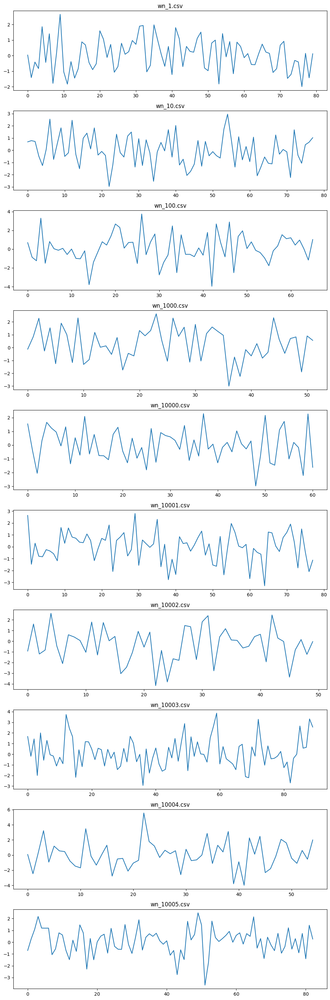

In [ ]:
plot_stationary_examples("wn_short")

In [ ]:
import shutil
from google.colab import files

folders = ["wn_short", "wn_medium", "wn_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### AR:

In [ ]:
def generate_ar_dataset(folder, count=20, length_range=(50, 100)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_stationary_base_series(distribution='ar')

        p, coefs = generator.generate_ar_params()
        d, q = 0, 0

        filename = f"ar_{i+1}.csv"
        df['label'] = "ar"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="ar",
            base_series="ar",
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            stochastic_trend=0,
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} AR series saved in '{folder}' with metadata.")

In [ ]:
generate_ar_dataset("ar_short", count=23000, length_range=(50, 100))
generate_ar_dataset("ar_medium", count=23000, length_range=(300, 500))
generate_ar_dataset("ar_long", count=23000, length_range=(1000, 10000))


23000 AR series saved in 'ar_short' with metadata.
23000 AR series saved in 'ar_medium' with metadata.
23000 AR series saved in 'ar_long' with metadata.


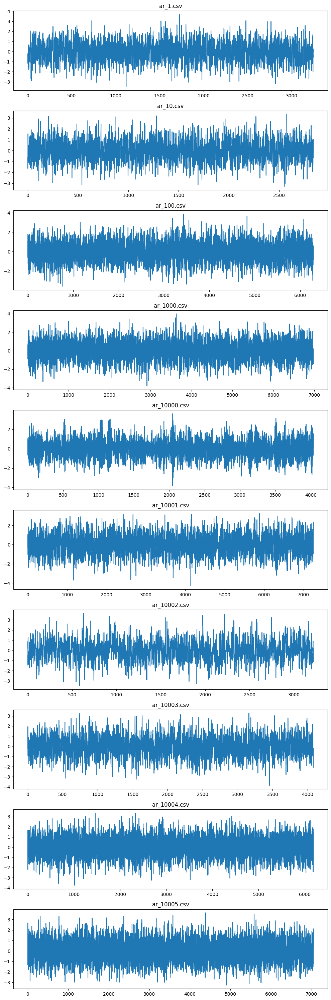

In [ ]:
plot_stationary_examples("ar_long")

In [ ]:
import shutil
from google.colab import files

folders = ["ar_short", "ar_medium", "ar_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### MA:

In [ ]:
def generate_ma_dataset(folder, count=20, length_range=(50, 100)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_stationary_base_series(distribution='ma')


        q, coefs = generator.generate_ma_params()
        p, d = 0, 0

        filename = f"ma_{i+1}.csv"
        df["label"] = "ma"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="ma",
            base_series="ma",
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            stochastic_trend=0
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} MA series saved in '{folder}' with metadata.")

In [ ]:
generate_ma_dataset("ma_short", count=23000, length_range=(50, 100))
generate_ma_dataset("ma_medium", count=23000, length_range=(300, 500))
generate_ma_dataset("ma_long", count=23000, length_range=(1000, 10000))

23000 MA series saved in 'ma_short' with metadata.
23000 MA series saved in 'ma_medium' with metadata.
23000 MA series saved in 'ma_long' with metadata.


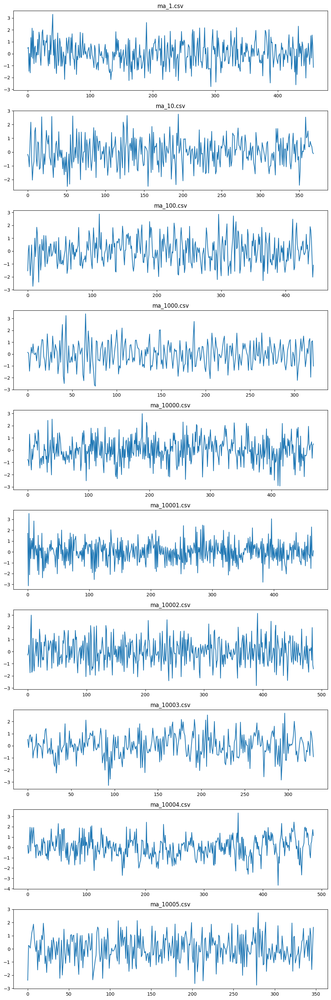

In [ ]:
plot_stationary_examples("ma_medium")

In [ ]:
import shutil
from google.colab import files

folders = ["ma_short", "ma_medium", "ma_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### ARMA:

In [ ]:
def generate_arma_dataset(folder, count=40, length_range=(300, 500)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_stationary_base_series(distribution='arma')
        df['label'] = "arma"

        ar_order, ma_order, ar_coefs, ma_coefs = generator.generate_arma_params()
        p, d, q = ar_order, 0, ma_order
        coefs = [*ar_coefs, *ma_coefs]
        coefs_str = "[" + " ".join(map(str, coefs)) + "]"

        filename = f"arma_{i+1}.csv"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="arma",
            base_series="arma",
            order=f"({p},{d},{q})",
            base_coefs=coefs_str,
            stochastic_trend=0
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} ARMA series saved in '{folder}' with metadata.")

In [ ]:
generate_arma_dataset("arma_short", count=23000, length_range=(50, 100))
generate_arma_dataset("arma_medium", count=23000, length_range=(300, 500))
generate_arma_dataset("arma_long", count=23000, length_range=(1000, 10000))

23000 ARMA series saved in 'arma_short' with metadata.
23000 ARMA series saved in 'arma_medium' with metadata.
23000 ARMA series saved in 'arma_long' with metadata.


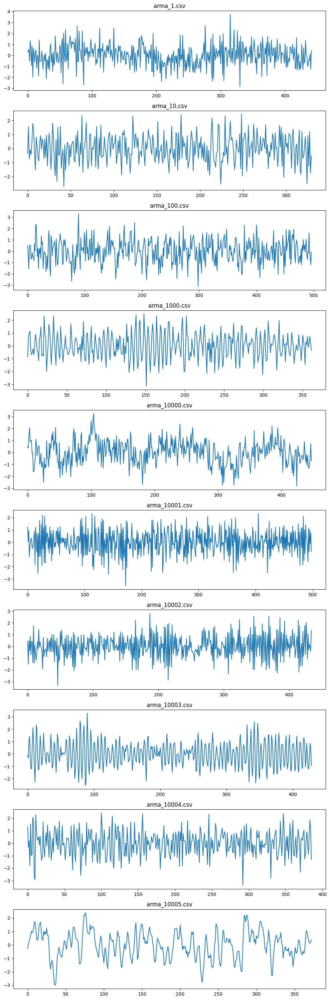

In [ ]:
plot_stationary_examples("arma_medium")

In [ ]:
import shutil
from google.colab import files

folders = ["arma_short", "arma_medium", "arma_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Stochastic Trend:

#### Random Walk:

In [ ]:
import os
import numpy as np
import pandas as pd
import pickle
import json

def generate_random_walk_dataset(folder, count=20, length_range=(50, 100)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_stochastic_trend(kind='rw')
        p, d, q = df.attrs.get("pdq", (0, 0, 0))
        coefs = df.attrs.get("coefs", [])



        filename = f"random_walk_{i+1}.csv"
        df['label'] = "random_walk"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="random_walk",
            base_series="rw",
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            stochastic_trend=1,

        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} random walk series saved in '{folder}' with metadata.")

In [ ]:
generate_random_walk_dataset("stochastic_rw_short", count=1000, length_range=(50, 100))
generate_random_walk_dataset("stochastic_rw_medium", count=1000, length_range=(300, 500))
generate_random_walk_dataset("stochastic_rw_long", count=1000, length_range=(1000, 10000))

1000 random walk series saved in 'stochastic_rw_short' with metadata.
1000 random walk series saved in 'stochastic_rw_medium' with metadata.
1000 random walk series saved in 'stochastic_rw_long' with metadata.


In [ ]:
def plot_random_walk_examples(folder, n=10):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()  # In case of stray spaces
        if 'data' in df.columns:
            plt.subplot(n, 1, i + 1)
            plt.plot(df['data'])
            plt.title(fname)
    plt.tight_layout()
    plt.show()

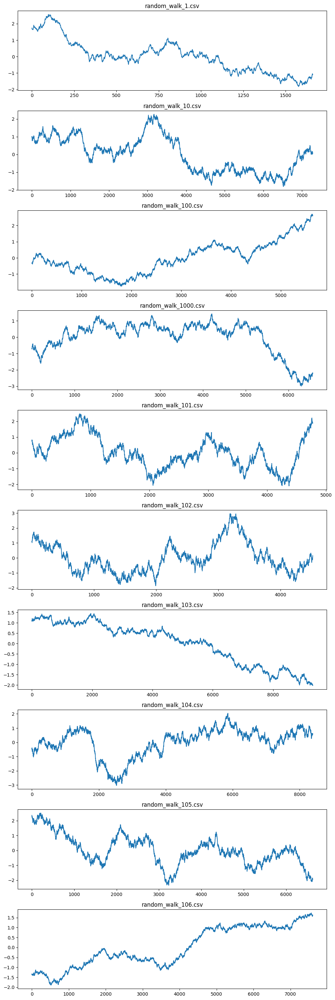

In [ ]:
plot_random_walk_examples("stochastic_rw_long")

In [ ]:
metadata_path = "stochastic_rw_medium/metadata.csv"
metadata_df = pd.read_csv(metadata_path)
metadata_df.head()

,filename,length,label,base_series,order,base_coefs,linear_trend_up,linear_trend_down,quadratic_trend,cubic_trend,...,location_mean_shift,location_variance_shift,location_trend_shift,location_contextual,location_point_pts,location_collective_pts,location_mean_pts,location_contextual_pts,location_variance_pts,location_trend_pts
0,random_walk_1.csv,348,random_walk,rw,"(0,0,0)",[],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,random_walk_2.csv,383,random_walk,rw,"(0,0,0)",[],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,random_walk_3.csv,377,random_walk,rw,"(0,0,0)",[],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,random_walk_4.csv,301,random_walk,rw,"(0,0,0)",[],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,random_walk_5.csv,300,random_walk,rw,"(0,0,0)",[],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
import shutil
from google.colab import files

folders = ["stochastic_rw_short", "stochastic_rw_medium", "stochastic_rw_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### Random Walk with Drift:

In [ ]:
def generate_random_walk_with_drift_dataset(folder, count=40, length_range=(300, 500)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_stochastic_trend(kind='rwd')
        p, d, q = df.attrs.get("pdq", (0, 0, 0))
        coefs = df.attrs.get("coefs", [])

        filename = f"random_walk_drift_{i+1}.csv"
        df['label'] = "random_walk_drift"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="random_walk_drift",
            base_series="rwd",
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            stochastic_trend=1
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} random walk with drift series saved in '{folder}' with metadata.")

In [ ]:
generate_random_walk_with_drift_dataset("stochastic_rwd_short", count=1000, length_range=(50, 100))
generate_random_walk_with_drift_dataset("stochastic_rwd_medium", count=1000, length_range=(300, 500))
generate_random_walk_with_drift_dataset("stochastic_rwd_long", count=1000, length_range=(1000, 10000))

1000 random walk with drift series saved in 'stochastic_rwd_short' with metadata.
1000 random walk with drift series saved in 'stochastic_rwd_medium' with metadata.
1000 random walk with drift series saved in 'stochastic_rwd_long' with metadata.


In [ ]:
def plot_random_walk_drift_examples(folder, n=10):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()
        if 'data' in df.columns:
            plt.subplot(n, 1, i + 1)
            plt.plot(df['data'])
            plt.title(fname)
    plt.tight_layout()
    plt.show()

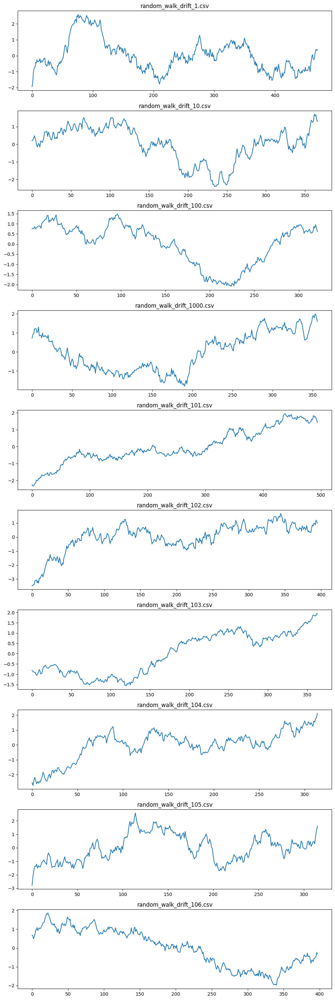

In [ ]:
plot_random_walk_drift_examples("stochastic_rwd_medium")

In [ ]:
metadata_path = "stochastic_rwd_medium/metadata.csv"
metadata_df = pd.read_csv(metadata_path)
metadata_df.head()

,filename,length,label,base_series,order,base_coefs,linear_trend_up,linear_trend_down,quadratic_trend,cubic_trend,...,location_mean_shift,location_variance_shift,location_trend_shift,location_contextual,location_point_pts,location_collective_pts,location_mean_pts,location_contextual_pts,location_variance_pts,location_trend_pts
0,random_walk_drift_1.csv,471,random_walk_drift,rwd,"(0,0,0)",[],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,random_walk_drift_2.csv,485,random_walk_drift,rwd,"(0,0,0)",[],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,random_walk_drift_3.csv,461,random_walk_drift,rwd,"(0,0,0)",[],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,random_walk_drift_4.csv,305,random_walk_drift,rwd,"(0,0,0)",[],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,random_walk_drift_5.csv,426,random_walk_drift,rwd,"(0,0,0)",[],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
import shutil
from google.colab import files

folders = ["stochastic_rwd_short", "stochastic_rwd_medium", "stochastic_rwd_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### IMA(d,q):

In [ ]:
def generate_ima_dataset(folder, count=40, length_range=(300, 500)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_stochastic_trend(kind='ima')
        p, d, q = df.attrs.get("pdq", (0, 0, 0))
        coefs = df.attrs.get("coefs", [])

        filename = f"ima_{i+1}.csv"
        df['label'] = "ima"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="ima",
            base_series="ima",
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            stochastic_trend=1
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} IMA series saved in '{folder}' with metadata.")

In [ ]:
generate_ima_dataset("stochastic_ima_short", count=1000, length_range=(50, 100))
generate_ima_dataset("stochastic_ima_medium", count=1000, length_range=(300, 500))
generate_ima_dataset("stochastic_ima_long", count=1000, length_range=(1000, 10000))

1000 IMA series saved in 'stochastic_ima_short' with metadata.
1000 IMA series saved in 'stochastic_ima_medium' with metadata.
1000 IMA series saved in 'stochastic_ima_long' with metadata.


In [ ]:
def plot_ima_examples(folder, n=10):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()
        if 'data' in df.columns:
            plt.subplot(n, 1, i + 1)
            plt.plot(df['data'])
            plt.title(fname)
    plt.tight_layout()
    plt.show()

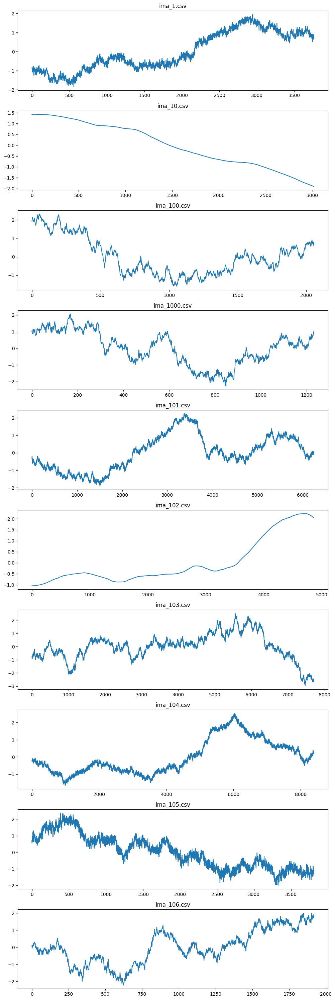

In [ ]:
plot_ima_examples("stochastic_ima_long")

In [ ]:
metadata_path = "stochastic_ima_medium/metadata.csv"
metadata_df = pd.read_csv(metadata_path)
metadata_df

,filename,length,label,base_series,order,base_coefs,linear_trend_up,linear_trend_down,quadratic_trend,cubic_trend,...,location_mean_shift,location_variance_shift,location_trend_shift,location_contextual,location_point_pts,location_collective_pts,location_mean_pts,location_contextual_pts,location_variance_pts,location_trend_pts
0,ima_1.csv,406,ima,ima,"(0,2,2)",[-0.45313487 0.42523869],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,ima_2.csv,315,ima,ima,"(0,1,3)",[0.43697399 0.36486045 0.3156197 ],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,ima_3.csv,332,ima,ima,"(0,1,3)",[ 0.5366247 0.41039668 -0.46888337],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,ima_4.csv,455,ima,ima,"(0,1,3)",[0.47616304 0.44622201 0.51955733],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,ima_5.csv,364,ima,ima,"(0,2,3)",[ 0.56880407 -0.46984669 -0.51580319],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,ima_996.csv,488,ima,ima,"(0,2,2)",[-0.50324506 0.4805286 ],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
996,ima_997.csv,449,ima,ima,"(0,1,3)",[0.38431811 0.40614565 0.5642767 ],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
997,ima_998.csv,334,ima,ima,"(0,2,3)",[-0.31328928 0.35253794 0.49064268],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
998,ima_999.csv,428,ima,ima,"(0,1,1)",[0.55748144],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
import shutil
from google.colab import files

folders = ["stochastic_ima_short", "stochastic_ima_medium", "stochastic_ima_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### ARI(p,d):

In [ ]:
def generate_ari_dataset(folder, count=40, length_range=(300, 500)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_stochastic_trend(kind='ari')
        p, d, q = df.attrs.get("pdq", (0, 0, 0))
        coefs = df.attrs.get("coefs", [])

        filename = f"ari_{i+1}.csv"
        df['label'] = "ari"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="ari",
            base_series="ari",
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            stochastic_trend=1
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} ARI series saved in '{folder}' with metadata.")

In [ ]:
generate_ari_dataset("stochastic_ari_short", count=1000, length_range=(50, 100))
generate_ari_dataset("stochastic_ari_medium", count=1000, length_range=(300, 500))
generate_ari_dataset("stochastic_ari_long", count=1000, length_range=(1000, 10000))


1000 ARI series saved in 'stochastic_ari_short' with metadata.
1000 ARI series saved in 'stochastic_ari_medium' with metadata.
1000 ARI series saved in 'stochastic_ari_long' with metadata.


In [ ]:
def plot_ari_examples(folder, n=5):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()
        if 'data' in df.columns:
            plt.subplot(n, 1, i + 1)
            plt.plot(df['data'])
            plt.title(fname)
    plt.tight_layout()
    plt.show()

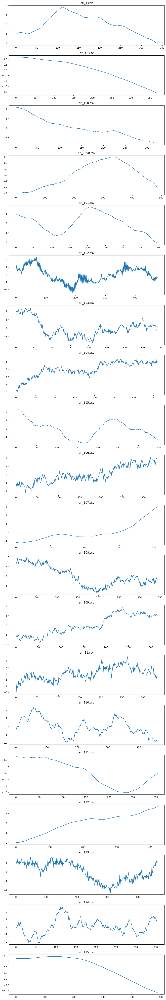

In [ ]:
plot_ari_examples("stochastic_ari_medium",20)

In [ ]:
metadata_path = "stochastic_ari_medium/metadata.csv"
metadata_df = pd.read_csv(metadata_path)
metadata_df

,filename,length,label,base_series,order,base_coefs,linear_trend_up,linear_trend_down,quadratic_trend,cubic_trend,...,location_mean_shift,location_variance_shift,location_trend_shift,location_contextual,location_point_pts,location_collective_pts,location_mean_pts,location_contextual_pts,location_variance_pts,location_trend_pts
0,ari_1.csv,339,ari,ari,"(1,2,0)",[-0.33261746],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,ari_2.csv,358,ari,ari,"(1,2,0)",[-0.56363754],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,ari_3.csv,413,ari,ari,"(2,1,0)",[-0.57480656 0.35115764],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,ari_4.csv,348,ari,ari,"(1,1,0)",[0.58034043],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,ari_5.csv,307,ari,ari,"(1,2,0)",[-0.41728662],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,ari_996.csv,467,ari,ari,"(3,1,0)",[-0.54694785 -0.34781572 0.40175833],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
996,ari_997.csv,379,ari,ari,"(1,1,0)",[-0.43918327],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
997,ari_998.csv,348,ari,ari,"(3,2,0)",[-0.50421946 0.315649 0.58115759],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
998,ari_999.csv,439,ari,ari,"(2,1,0)",[-0.55152707 0.31292201],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
import shutil
from google.colab import files

folders = ["stochastic_ari_short", "stochastic_ari_medium", "stochastic_ari_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### ARIMA(p,d,q):

In [ ]:
def generate_arima_dataset(folder, count=40, length_range=(300, 500)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_stochastic_trend(kind='arima')
        p, d, q = df.attrs.get("pdq", (0, 0, 0))
        coefs = df.attrs.get("coefs", [])

        filename = f"arima_{i+1}.csv"
        df['label'] = "arima"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="arima",
            base_series="arima",
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            stochastic_trend=1
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} ARIMA series saved in '{folder}' with metadata.")

In [ ]:
generate_arima_dataset("stochastic_arima_short", count=1000, length_range=(50, 100))
generate_arima_dataset("stochastic_arima_medium", count=1000, length_range=(300, 500))
generate_arima_dataset("stochastic_arima_long", count=1000, length_range=(1000, 10000))

1000 ARIMA series saved in 'stochastic_arima_short' with metadata.
1000 ARIMA series saved in 'stochastic_arima_medium' with metadata.
1000 ARIMA series saved in 'stochastic_arima_long' with metadata.


In [ ]:
def plot_arima_examples(folder, n=20):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()
        if 'data' in df.columns:
            plt.subplot(n, 1, i + 1)
            plt.plot(df['data'])
            plt.title(fname)
    plt.tight_layout()
    plt.show()

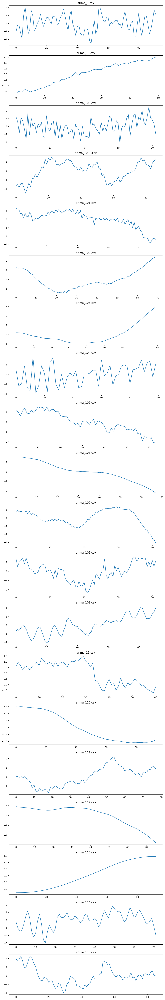

In [ ]:
plot_arima_examples("stochastic_arima_short")

In [ ]:
metadata_path = "stochastic_arima_medium/metadata.csv"
metadata_df = pd.read_csv(metadata_path)
metadata_df

,filename,length,label,base_series,order,base_coefs,linear_trend_up,linear_trend_down,quadratic_trend,cubic_trend,...,location_mean_shift,location_variance_shift,location_trend_shift,location_contextual,location_point_pts,location_collective_pts,location_mean_pts,location_contextual_pts,location_variance_pts,location_trend_pts
0,arima_1.csv,419,arima,arima,"(1,2,1)","[-0.46043294862261286, 0.7806303752504963]",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,arima_2.csv,446,arima,arima,"(2,1,2)","[0.2716775693211394, -0.29917095372683644, -0....",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,arima_3.csv,304,arima,arima,"(1,1,1)","[-0.7912769708454772, 0.5318827206830438]",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,arima_4.csv,335,arima,arima,"(1,2,1)","[0.5487838981555543, -0.7135928873162987]",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,arima_5.csv,455,arima,arima,"(3,2,1)","[0.7866888188217639, 0.36701190160431196, -0.3...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,arima_996.csv,422,arima,arima,"(2,2,1)","[0.26555589693514114, -0.2055789958494596, -0....",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
996,arima_997.csv,450,arima,arima,"(2,1,1)","[0.6022909219643463, -0.7976023719536377, 0.49...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
997,arima_998.csv,441,arima,arima,"(3,1,3)","[-0.4865307676282495, -0.405103064674225, -0.5...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
998,arima_999.csv,339,arima,arima,"(1,1,2)","[0.5653484287339797, 0.2052552590982123, -0.58...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
import shutil
from google.colab import files

folders = ["stochastic_arima_short", "stochastic_arima_medium", "stochastic_arima_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Volatility:

#### ARCH(1):

In [ ]:
def generate_arch_dataset(folder, count=40, length_range=(300, 500)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_volatility(kind='arch')
        vol_params = df.attrs.get("vol_params", [])

        filename = f"arch_{i+1}.csv"
        df['label'] = "arch"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="arch",
            base_series="arch",
            base_coefs=str(vol_params),
            volatility=1,
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} ARCH(1) series saved in '{folder}' with metadata.")

In [ ]:
generate_arch_dataset("volatility_arch_short", count=1000, length_range=(50, 100))
generate_arch_dataset("volatility_arch_medium", count=1000, length_range=(300, 500))
generate_arch_dataset("volatility_arch_long", count=1000, length_range=(1000, 10000))

1000 ARCH(1) series saved in 'volatility_arch_short' with metadata.
1000 ARCH(1) series saved in 'volatility_arch_medium' with metadata.
1000 ARCH(1) series saved in 'volatility_arch_long' with metadata.


In [ ]:
def plot_arch_examples(folder, n=10):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()
        if 'data' in df.columns:
            plt.subplot(n, 1, i + 1)
            plt.plot(df['data'])
            plt.title(fname)
    plt.tight_layout()
    plt.show()

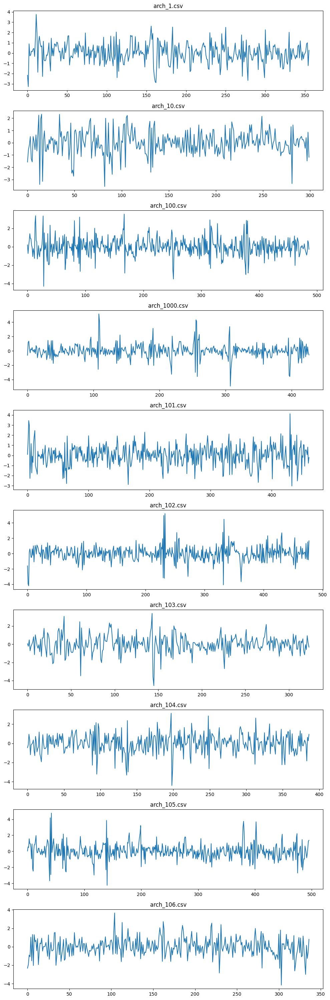

In [ ]:
plot_arch_examples("volatility_arch_medium")

In [ ]:
metadata_path = "volatility_arch_medium/metadata.csv"
metadata_df = pd.read_csv(metadata_path)
metadata_df

,filename,length,label,base_series,order,base_coefs,linear_trend_up,linear_trend_down,quadratic_trend,cubic_trend,...,location_mean_shift,location_variance_shift,location_trend_shift,location_contextual,location_point_pts,location_collective_pts,location_mean_pts,location_contextual_pts,location_variance_pts,location_trend_pts
0,arch_1.csv,356,arch,arch,0,"[0.6746665322525651, 0.19456100513072527]",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,arch_2.csv,467,arch,arch,0,"[0.7243690639113538, 0.2976307937429011]",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,arch_3.csv,446,arch,arch,0,"[0.5703992009607923, 0.22445108715496995]",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,arch_4.csv,310,arch,arch,0,"[0.6176272799927947, 0.26483597407069537]",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,arch_5.csv,384,arch,arch,0,"[0.6831882840624511, 0.13788204973189705]",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,arch_996.csv,398,arch,arch,0,"[0.8671249057040827, 0.1311107744317515]",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
996,arch_997.csv,463,arch,arch,0,"[0.5811825765674911, 0.16387443427265774]",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
997,arch_998.csv,327,arch,arch,0,"[0.6786462726336573, 0.2823662351429608]",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
998,arch_999.csv,394,arch,arch,0,"[0.6542776386918564, 0.13173866364124975]",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
import shutil
from google.colab import files

folders = ["volatility_arch_short", "volatility_arch_medium", "volatility_arch_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### GARCH(1,1):

In [ ]:
def generate_garch_dataset(folder, count=40, length_range=(300, 500)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_volatility(kind='garch')
        vol_params = df.attrs.get("vol_params", {})

        filename = f"garch_{i+1}.csv"
        df['label'] = "garch"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="garch",
            base_series="garch",
            base_coefs=str(vol_params),
            volatility=1,
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} GARCH(1,1) series saved in '{folder}' with metadata.")


In [ ]:
generate_garch_dataset("volatility_garch_short", count=1000, length_range=(50, 100))
generate_garch_dataset("volatility_garch_medium", count=1000, length_range=(300, 500))
generate_garch_dataset("volatility_garch_long", count=1000, length_range=(1000, 10000))

1000 GARCH(1,1) series saved in 'volatility_garch_short' with metadata.
1000 GARCH(1,1) series saved in 'volatility_garch_medium' with metadata.
1000 GARCH(1,1) series saved in 'volatility_garch_long' with metadata.


In [ ]:
def plot_garch_examples(folder, n=10):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()
        if 'data' in df.columns:
            plt.subplot(n, 1, i + 1)
            plt.plot(df['data'])
            plt.title(fname)
    plt.tight_layout()
    plt.show()

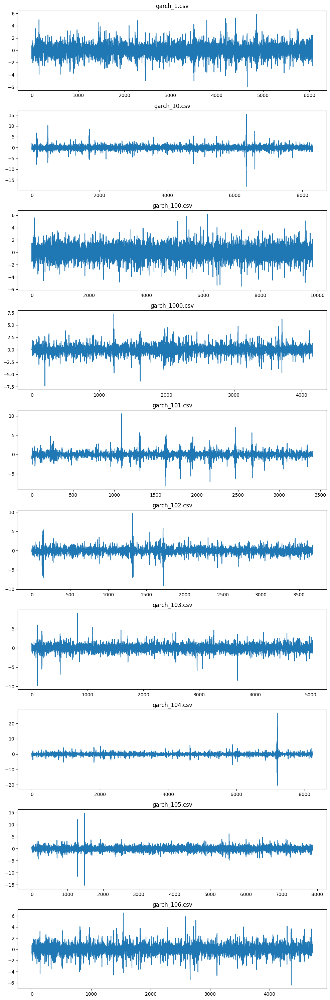

In [ ]:
plot_garch_examples("volatility_garch_long")

In [ ]:
metadata_path = "volatility_garch_medium/metadata.csv"
metadata_df = pd.read_csv(metadata_path)
metadata_df.head()

,filename,length,label,base_series,order,base_coefs,linear_trend_up,linear_trend_down,quadratic_trend,cubic_trend,...,location_mean_shift,location_variance_shift,location_trend_shift,location_contextual,location_point_pts,location_collective_pts,location_mean_pts,location_contextual_pts,location_variance_pts,location_trend_pts
0,garch_1.csv,453,garch,garch,0,"[0.4810829342491584, 0.2268751247001424, 0.305...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,garch_2.csv,431,garch,garch,0,"[0.499801352086105, 0.44174532119172566, 0.491...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,garch_3.csv,407,garch,garch,0,"[0.561034969574388, 0.3124130188629326, 0.4789...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,garch_4.csv,322,garch,garch,0,"[0.593800078457556, 0.37961713446552614, 0.550...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,garch_5.csv,423,garch,garch,0,"[0.5705650610185753, 0.3439747863962882, 0.383...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
import shutil
from google.colab import files

folders = ["volatility_garch_short", "volatility_garch_medium", "volatility_garch_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### EGARCH(1,1):

In [ ]:
def generate_egarch_dataset(folder, count=40, length_range=(300, 500)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_volatility(kind='egarch')
        vol_params = df.attrs.get("vol_params", {})

        filename = f"egarch_{i+1}.csv"
        df['label'] = "egarch"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="egarch",
            base_series="egarch",
            base_coefs=str(vol_params),
            volatility=1,
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} EGARCH(1,1) series saved in '{folder}' with metadata.")

In [ ]:
generate_egarch_dataset("volatility_egarch_short", count=1000, length_range=(50, 100))
generate_egarch_dataset("volatility_egarch_medium", count=1000, length_range=(300, 500))
generate_egarch_dataset("volatility_egarch_long", count=1000, length_range=(1000, 10000))

1000 EGARCH(1,1) series saved in 'volatility_egarch_short' with metadata.
1000 EGARCH(1,1) series saved in 'volatility_egarch_medium' with metadata.
1000 EGARCH(1,1) series saved in 'volatility_egarch_long' with metadata.


In [ ]:
def plot_egarch_examples(folder, n=10):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()
        if 'data' in df.columns:
            plt.subplot(n, 1, i + 1)
            plt.plot(df['data'])
            plt.title(fname)
    plt.tight_layout()
    plt.show()

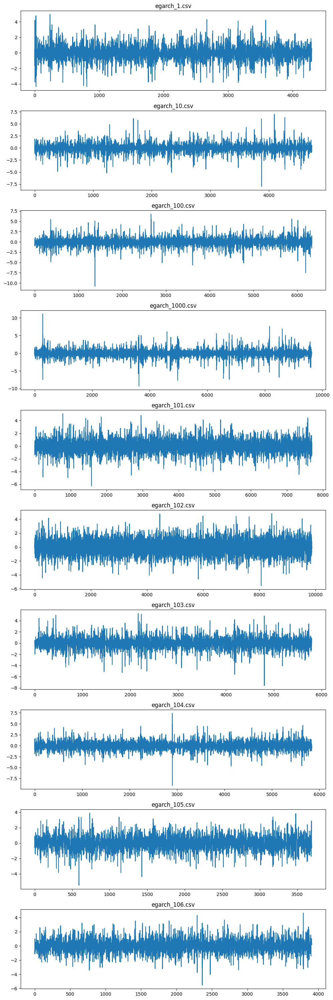

In [ ]:
plot_egarch_examples("volatility_egarch_long")

In [ ]:
metadata_path = "volatility_egarch_medium/metadata.csv"
metadata_df = pd.read_csv(metadata_path)
metadata_df

,filename,length,label,base_series,order,base_coefs,linear_trend_up,linear_trend_down,quadratic_trend,cubic_trend,...,location_mean_shift,location_variance_shift,location_trend_shift,location_contextual,location_point_pts,location_collective_pts,location_mean_pts,location_contextual_pts,location_variance_pts,location_trend_pts
0,egarch_1.csv,315,egarch,egarch,0,"[0.1862416708930565, 0.865285865995945, 0.4266...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,egarch_2.csv,471,egarch,egarch,0,"[0.23320157677470987, 0.537191945220865, -0.45...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,egarch_3.csv,397,egarch,egarch,0,"[0.1955275543498643, 0.7450166038354785, -0.24...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,egarch_4.csv,449,egarch,egarch,0,"[0.22411598112250714, 0.6164529652403943, 0.39...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,egarch_5.csv,303,egarch,egarch,0,"[0.10116953332942354, 0.8711728033871922, 0.20...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,egarch_996.csv,445,egarch,egarch,0,"[0.10422716750443117, 0.5918516964101951, -0.1...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
996,egarch_997.csv,497,egarch,egarch,0,"[0.2770005636074714, 0.863224926950243, 0.4668...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
997,egarch_998.csv,495,egarch,egarch,0,"[0.26106422110244176, 0.7142233318078882, 0.14...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
998,egarch_999.csv,497,egarch,egarch,0,"[0.15329497165455594, 0.5796046096528704, -0.1...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
import shutil
from google.colab import files

folders = ["volatility_egarch_short", "volatility_egarch_medium", "volatility_egarch_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### apARCH(1,1):

In [ ]:
def generate_aparch_dataset(folder, count=40, length_range=(300, 500)):
    os.makedirs(folder, exist_ok=True)
    generator = TimeSeriesGenerator()
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        generator.length = length

        df = generator.generate_volatility(kind='aparch')
        vol_params = df.attrs.get("vol_params", {})

        filename = f"aparch_{i+1}.csv"
        df['label'] = "aparch"
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label="aparch",
            base_series="aparch",
            base_coefs=str(vol_params),
            volatility=1,
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} APARCH(1,1) series saved in '{folder}' with metadata.")

In [ ]:
generate_aparch_dataset("volatility_aparch_short", count=1000, length_range=(50, 100))
generate_aparch_dataset("volatility_aparch_medium", count=1000, length_range=(300, 500))
generate_aparch_dataset("volatility_aparch_long", count=1000, length_range=(1000, 10000))

1000 APARCH(1,1) series saved in 'volatility_aparch_short' with metadata.
1000 APARCH(1,1) series saved in 'volatility_aparch_medium' with metadata.
1000 APARCH(1,1) series saved in 'volatility_aparch_long' with metadata.


In [ ]:
def plot_aparch_examples(folder, n=5):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()
        if 'data' in df.columns:
            plt.subplot(n, 1, i + 1)
            plt.plot(df['data'])
            plt.title(fname)
    plt.tight_layout()
    plt.show()

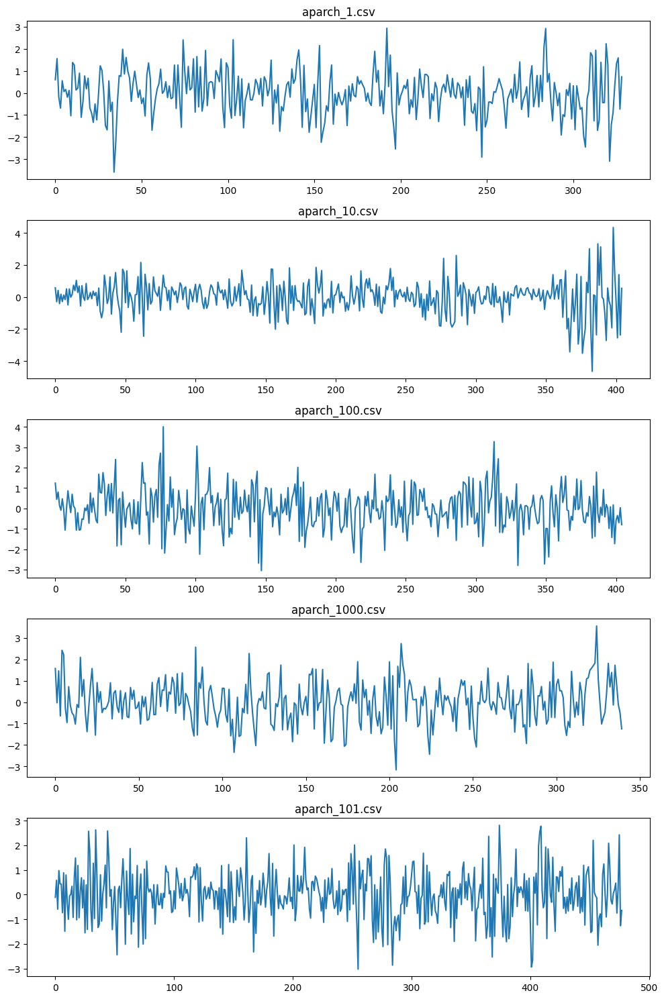

In [ ]:
plot_aparch_examples("volatility_aparch_medium")

In [ ]:
metadata_path = "volatility_aparch_medium/metadata.csv"
metadata_df = pd.read_csv(metadata_path)
metadata_df

,filename,length,label,base_series,order,base_coefs,linear_trend_up,linear_trend_down,quadratic_trend,cubic_trend,...,location_mean_shift,location_variance_shift,location_trend_shift,location_contextual,location_point_pts,location_collective_pts,location_mean_pts,location_contextual_pts,location_variance_pts,location_trend_pts
0,aparch_1.csv,329,aparch,aparch,0,"[0.19831299402408353, 0.14918484259345838, 0.7...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,aparch_2.csv,495,aparch,aparch,0,"[0.2212208191490005, 0.28575640975177724, 0.69...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,aparch_3.csv,438,aparch,aparch,0,"[0.1482602149844982, 0.15304762267279512, 0.63...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,aparch_4.csv,431,aparch,aparch,0,"[0.14952807746970292, 0.10230030443793243, 0.6...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,aparch_5.csv,300,aparch,aparch,0,"[0.11777719807581147, 0.15839258811346837, 0.7...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,aparch_996.csv,489,aparch,aparch,0,"[0.22350194395267237, 0.22395770217037803, 0.6...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
996,aparch_997.csv,365,aparch,aparch,0,"[0.18159271561907536, 0.11248102765349002, 0.5...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
997,aparch_998.csv,429,aparch,aparch,0,"[0.2096802153697926, 0.21573497718294005, 0.60...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
998,aparch_999.csv,347,aparch,aparch,0,"[0.10959713703774066, 0.2846823796401202, 0.61...",0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
import shutil
from google.colab import files

folders = ["volatility_aparch_short", "volatility_aparch_medium", "volatility_aparch_long"]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## COMBINATIONS:

In [ ]:
def plot_combinations(folder, n=5):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()
        if 'data' in df.columns:
            plt.subplot(n, 1, i + 1)
            plt.plot(df['data'])
            plt.title(fname)
    plt.tight_layout()
    plt.show()

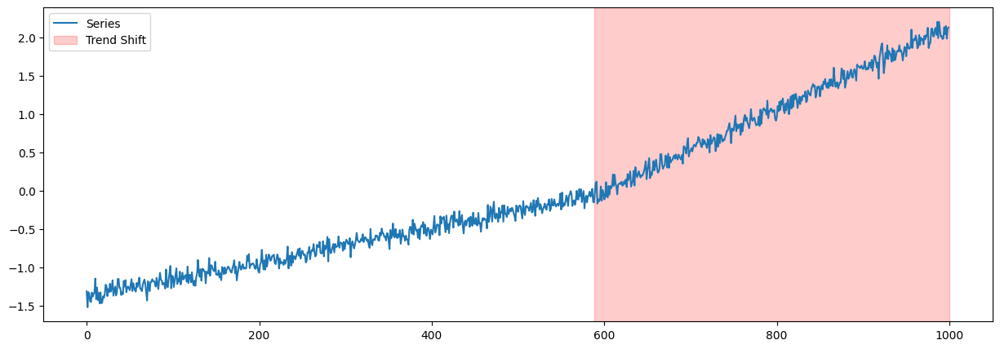

In [ ]:
# Trend shift
ts = TimeSeriesGenerator(length=1000)
series = ts.generate_stochastic_trend('arima')

# change_types bir liste olmalı
series_single_trend, info = ts.generate_trend_shift(
    series,
    sign=1,
    num_breaks=1,
    location='middle',
    change_types=['magnitude_change'],  # <-- DÜZELTİLDİ
    return_debug=True
)

# info: [(break_point, slope, change_type), ...]
starts = [x[0] for x in info]  # break points
ends = [len(series)] * len(starts)

plt.figure(figsize=(15, 5))
plt.plot(series_single_trend['data'], label='Series')
for s, e in zip(starts, ends):
    plt.axvspan(s, e, color='red', alpha=0.2, label='Trend Shift')
plt.legend()
plt.show()

## Stochastic Trend + ...

### Stochastic Trend + Point Anomaly:

In [ ]:
import os
import numpy as np
import pandas as pd
import json

def generate_stochastic_with_point_anomaly_dataset(
    folder,
    kind='rw',
    count=5,
    length_range=(300, 500),
    anomaly_type='single',
    location="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)

        base_df = ts.generate_stochastic_trend(kind=kind)
        p, d, q = base_df.attrs.get("pdq", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        if anomaly_type == 'single':
            loc = location if location else np.random.choice(['beginning', 'middle', 'end'])
            df = ts.generate_point_anomaly(base_df, location=loc)
            label = f"{kind}_single_point_anomaly_{loc}"
            location_point = loc
            point_anomaly=1
            multi_point_anomaly = 0
            val = df['point_anom_point'].iloc[0]
            if isinstance(val, (list, np.ndarray)):
                location_point_pts = [int(val[0])]
            else:
                location_point_pts = [int(val)]


        elif anomaly_type == 'multiple':
            df = ts.generate_point_anomalies(base_df)
            label = f"{kind}_multiple_point_anomalies"
            location_point = 0  # bilinmiyor ya da çoklu
            point_anomaly = 0
            multi_point_anomaly = 1
            location_point_pts = [int(x) for x in df['point_anom_location'].iloc[0]]
        else:
            raise ValueError("Invalid anomaly_type. Must be 'single' or 'multiple'.")

        filename = f"{label}_{i+1}.csv"
        df['label'] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,

            base_series=kind,
            base_coefs=str(coefs),
            order=f"({p},{d},{q})",
            stochastic_trend=1,

            point_anomaly=point_anomaly,
            multi_point_anomaly=multi_point_anomaly,
            location_point=location_point,
            location_point_pts=location_point_pts
        )
        metadata.append(record)

    # Save CSV metadata
    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")

In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
types = ['rw', 'rwd', 'ari', 'ima', 'arima']

for kind in types:
    for size_label, length_range in length_ranges.items():
        for loc in locations:
            folder = f"{kind}_point_single_{loc}_{size_label}"
            generate_stochastic_with_point_anomaly_dataset(
                folder=folder,
                kind=kind,
                count=1000,
                length_range=length_range,
                anomaly_type='single',
                location=loc
            )

        folder = f"{kind}_point_multi_{size_label}"
        generate_stochastic_with_point_anomaly_dataset(
            folder=folder,
            kind=kind,
            count=1000,
            length_range=length_range,
            anomaly_type='multiple'
        )

1000 'rw_single_point_anomaly_beginning' series saved in 'rw_point_single_beginning_short' with metadata.
1000 'rw_single_point_anomaly_middle' series saved in 'rw_point_single_middle_short' with metadata.
1000 'rw_single_point_anomaly_end' series saved in 'rw_point_single_end_short' with metadata.
1000 'rw_multiple_point_anomalies' series saved in 'rw_point_multi_short' with metadata.
1000 'rw_single_point_anomaly_beginning' series saved in 'rw_point_single_beginning_medium' with metadata.
1000 'rw_single_point_anomaly_middle' series saved in 'rw_point_single_middle_medium' with metadata.
1000 'rw_single_point_anomaly_end' series saved in 'rw_point_single_end_medium' with metadata.
1000 'rw_multiple_point_anomalies' series saved in 'rw_point_multi_medium' with metadata.
1000 'rw_single_point_anomaly_beginning' series saved in 'rw_point_single_beginning_long' with metadata.
1000 'rw_single_point_anomaly_middle' series saved in 'rw_point_single_middle_long' with metadata.
1000 'rw_singl

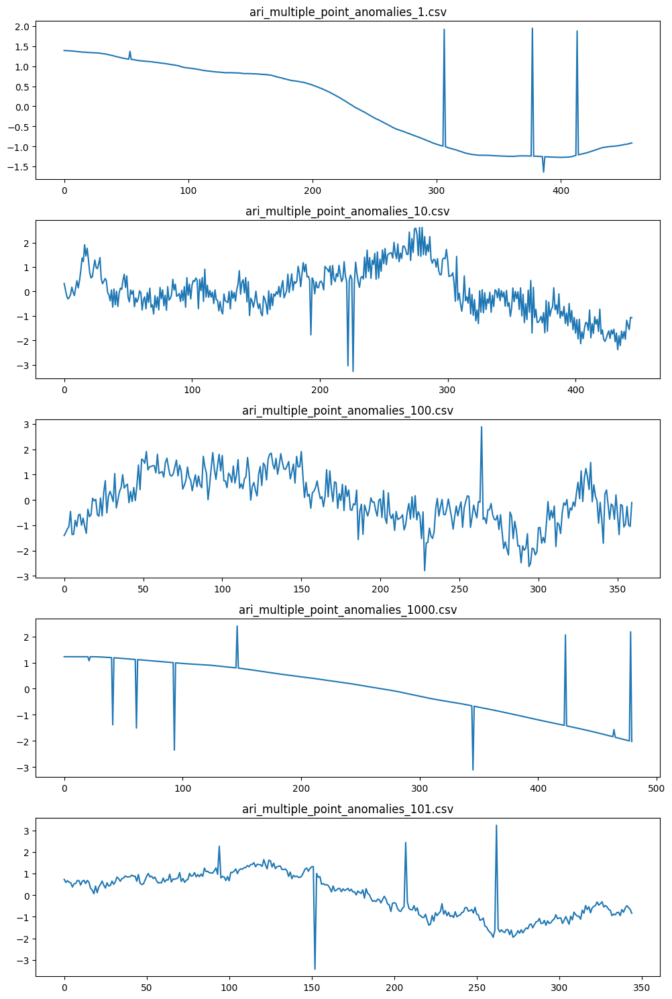

In [ ]:
plot_combinations("ari_point_multi_medium")

In [ ]:
import shutil
from google.colab import files
import os
import glob
folders = [f for f in glob.glob("arima_point*") if os.path.isdir(f)]

print(f"{len(folders)} klasör bulundu ve zipleniyor...")

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

12 klasör bulundu ve zipleniyor...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Stochastic Trend + Collective Anomaly:

In [ ]:
def generate_stochastic_with_collective_anomaly_dataset(
    folder,
    kind='rw',
    count=5,
    length_range=(300, 500),
    anomaly_type='single',
    location="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_stochastic_trend(kind=kind)
        p, d, q = base_df.attrs.get("pdq", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        if anomaly_type == 'single':
            loc = location if location else np.random.choice(['beginning', 'middle', 'end'])
            df = ts.generate_collective_anomalies(base_df, location=loc)
            label = f"{kind}_single_collective_anomaly_{loc}"
            location_collective = loc
            collective_anomaly = 1
            multi_collective_anomaly = 0

        elif anomaly_type == 'multiple':
            num_anomalies = np.random.randint(2, 5)
            df = ts.generate_collective_anomalies(base_df, num_anomalies=num_anomalies)
            label = f"{kind}_multiple_collective_anomalies"
            location_collective = 0
            collective_anomaly = 0
            multi_collective_anomaly = 1
        else:
            raise ValueError("Invalid anomaly_type. Must be 'single' or 'multiple'.")

        starts = df['collect_anom_start'].iloc[0]
        ends = df['collect_anom_end'].iloc[0]
        start_end_pairs = list(zip(map(int, starts), map(int, ends)))

        filename = f"{label}_{i+1}.csv"
        df['label'] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            base_series=kind,
            base_coefs=str(coefs),
            order=f"({p},{d},{q})",
            stochastic_trend=1,
            collective_anomaly=collective_anomaly,
            multi_collective_anomaly=multi_collective_anomaly,
            location_collective=location_collective,
            location_collective_pts=start_end_pairs
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")

In [ ]:

length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
types = ['rw', 'rwd', 'ari', 'ima', 'arima']

for kind in types:
    for size_label, length_range in length_ranges.items():
        for loc in locations:
            folder = f"{kind}_collective_single_{loc}_{size_label}"
            generate_stochastic_with_collective_anomaly_dataset(
                folder=folder,
                kind=kind,
                count=1000,
                length_range=length_range,
                anomaly_type='single',
                location=loc
            )

        folder = f"{kind}_collective_multi_{size_label}"
        generate_stochastic_with_collective_anomaly_dataset(
            folder=folder,
            kind=kind,
            count=1000,
            length_range=length_range,
            anomaly_type='multiple'
        )


KeyboardInterrupt: 

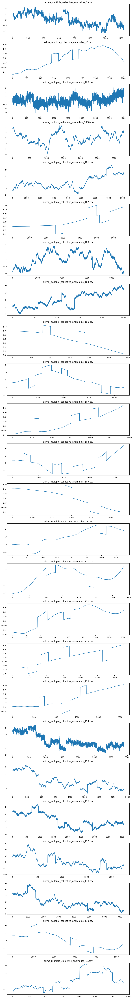

In [ ]:
plot_combinations("arima_collective_multi_long", 25)

In [ ]:
import shutil
folder_ari_collective_single_end_long= "ari_collective_single_end_long"
shutil.make_archive(folder_ari_collective_single_end_long, 'zip', folder_ari_collective_single_end_long)
from google.colab import files
files.download("ari_collective_single_end_long.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import shutil
from google.colab import files
import os
import glob
folders = [f for f in glob.glob("arima_collective*") if os.path.isdir(f)]

print(f"{len(folders)} klasör bulundu ve zipleniyor...")

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

12 klasör bulundu ve zipleniyor...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Stochastic Trend + Mean Shift:

In [ ]:
def generate_stochastic_with_mean_shift_anomaly_dataset(
    folder,
    kind='rw',
    count=5,
    length_range=(300, 500),
    anomaly_type='single',
    shift_type="increase",
    location="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_stochastic_trend(kind=kind)
        p, d, q = base_df.attrs.get("pdq", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        if anomaly_type == 'single':
            sign = 1 if shift_type == 'increase' else -1
            df, _ = ts.generate_mean_shift(base_df, signs=[sign], location=location, num_breaks=1, return_debug=True)
            label = f"{kind}_single_mean_shift_{shift_type}_{location}"
            loc = location
        elif anomaly_type == 'multiple':
            num_breaks = np.random.randint(2, 4)
            random_signs = list(np.random.choice([-1, 1], size=num_breaks))
            df, _ = ts.generate_mean_shift(base_df, num_breaks=num_breaks, signs=random_signs, return_debug=True)
            label = f"{kind}_multiple_mean_shifts"
            loc = 0
        else:
            raise ValueError("Invalid anomaly_type")

        # NumPy türlerini temizle
        break_points = df['mean_shift_point'].iloc[0]
        magnitudes = df['mean_shift_magnitude'].iloc[0]

        break_points = list(map(int, break_points)) if isinstance(break_points, (list, np.ndarray)) else [int(break_points)]
        magnitudes = list(map(float, magnitudes)) if isinstance(magnitudes, (list, np.ndarray)) else [float(magnitudes)]

        location_mean_pts = list(zip(break_points, magnitudes))

        df["label"] = label
        df.to_csv(os.path.join(folder, f"{label}_{i+1}.csv"), index=False)

        record = create_metadata_record(
            filename=f"{label}_{i+1}.csv",
            length=length,
            label=label,
            base_series=kind,
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            stochastic_trend=1,
            mean_shift_increase=1 if anomaly_type == 'single' and shift_type == 'increase' else 0,
            mean_shift_decrease=1 if anomaly_type == 'single' and shift_type == 'decrease' else 0,
            multi_mean_shift=1 if anomaly_type == 'multiple' else 0,
            location_mean_shift=loc,
            location_mean_pts=location_mean_pts
        )
        metadata.append(record)

    # Metadata kayıt
    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")

In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}

locations = ['beginning', 'middle', 'end']
shift_types = ['increase', 'decrease']
trend_types = ['rw', 'rwd', 'ari', 'ima', 'arima']

for kind in trend_types:
    for size_label, length_range in length_ranges.items():
        for loc in locations:
            for shift in shift_types:
                folder = f"{kind}_mean_shift_single_{shift}_{loc}_{size_label}"
                generate_stochastic_with_mean_shift_anomaly_dataset(
                    folder=folder,
                    kind=kind,
                    count=1000,
                    length_range=length_range,
                    anomaly_type='single',
                    shift_type=shift,
                    location=loc
                )

        folder = f"{kind}_mean_shift_multi_{size_label}"
        generate_stochastic_with_mean_shift_anomaly_dataset(
            folder=folder,
            kind=kind,
            count=1000,
            length_range=length_range,
            anomaly_type='multiple'
        )

1000 'rw_single_mean_shift_increase_beginning' series saved in 'rw_mean_shift_single_increase_beginning_short' with metadata.
1000 'rw_single_mean_shift_decrease_beginning' series saved in 'rw_mean_shift_single_decrease_beginning_short' with metadata.
1000 'rw_single_mean_shift_increase_middle' series saved in 'rw_mean_shift_single_increase_middle_short' with metadata.
1000 'rw_single_mean_shift_decrease_middle' series saved in 'rw_mean_shift_single_decrease_middle_short' with metadata.
1000 'rw_single_mean_shift_increase_end' series saved in 'rw_mean_shift_single_increase_end_short' with metadata.
1000 'rw_single_mean_shift_decrease_end' series saved in 'rw_mean_shift_single_decrease_end_short' with metadata.
1000 'rw_multiple_mean_shifts' series saved in 'rw_mean_shift_multi_short' with metadata.
1000 'rw_single_mean_shift_increase_beginning' series saved in 'rw_mean_shift_single_increase_beginning_medium' with metadata.
1000 'rw_single_mean_shift_decrease_beginning' series saved in 

In [ ]:
import warnings
warnings.simplefilter("ignore")

In [ ]:


length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}

trend_types = ['ari', 'ima', 'arima', 'rw', 'rwd']

for kind in trend_types:
    for size_label, length_range in length_ranges.items():
        folder = f"{kind}_mean_shift_multi_{size_label}"
        generate_stochastic_with_mean_shift_anomaly_dataset(
            folder=folder,
            kind=kind,
            count=1000,
            length_range=length_range,
            anomaly_type="multiple"
        )

1000 'ari_multiple_mean_shifts' series saved in 'ari_mean_shift_multi_short' with metadata.
1000 'ari_multiple_mean_shifts' series saved in 'ari_mean_shift_multi_medium' with metadata.
1000 'ari_multiple_mean_shifts' series saved in 'ari_mean_shift_multi_long' with metadata.
1000 'ima_multiple_mean_shifts' series saved in 'ima_mean_shift_multi_short' with metadata.
1000 'ima_multiple_mean_shifts' series saved in 'ima_mean_shift_multi_medium' with metadata.
1000 'ima_multiple_mean_shifts' series saved in 'ima_mean_shift_multi_long' with metadata.
1000 'arima_multiple_mean_shifts' series saved in 'arima_mean_shift_multi_short' with metadata.
1000 'arima_multiple_mean_shifts' series saved in 'arima_mean_shift_multi_medium' with metadata.
1000 'arima_multiple_mean_shifts' series saved in 'arima_mean_shift_multi_long' with metadata.
1000 'rw_multiple_mean_shifts' series saved in 'rw_mean_shift_multi_short' with metadata.
1000 'rw_multiple_mean_shifts' series saved in 'rw_mean_shift_multi_me

In [ ]:
import shutil
from google.colab import files

folders = [
    "ari_mean_shift_multi_short",
    "ari_mean_shift_multi_medium",
    "ari_mean_shift_multi_long",
    "ima_mean_shift_multi_short",
    "ima_mean_shift_multi_medium",
    "ima_mean_shift_multi_long",
    "arima_mean_shift_multi_short",
    "arima_mean_shift_multi_medium",
    "arima_mean_shift_multi_long",
    "rw_mean_shift_multi_short",
    "rw_mean_shift_multi_medium",
    "rw_mean_shift_multi_long",
    "rwd_mean_shift_multi_short",
    "rwd_mean_shift_multi_medium",
    "rwd_mean_shift_multi_long"
]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

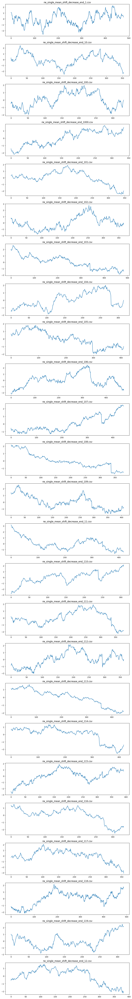

In [ ]:
plot_combinations("rw_mean_shift_single_decrease_end_medium",25)

In [ ]:
metadata_path = "ima_mean_shift_single_decrease_beginning_medium/metadata.csv"
metadata_df = pd.read_csv(metadata_path)
metadata_df

,filename,length,label,base_series,order,base_coefs,linear_trend_up,linear_trend_down,quadratic_trend,cubic_trend,...,location_mean_shift,location_variance_shift,location_trend_shift,location_contextual,location_point_pts,location_collective_pts,location_mean_pts,location_contextual_pts,location_variance_pts,location_trend_pts
0,ima_single_mean_shift_decrease_beginning_1.csv,478,ima_single_mean_shift_decrease_beginning,ima,"(0,2,1)",[-0.51981795],0,0,0,0,...,beginning,0,0,0,0,0,"[(53, -1.0538105960806672)]",0,0,0
1,ima_single_mean_shift_decrease_beginning_2.csv,361,ima_single_mean_shift_decrease_beginning,ima,"(0,2,3)",[-0.47640376 0.45756101 -0.45443089],0,0,0,0,...,beginning,0,0,0,0,0,"[(96, -1.4552435243936424)]",0,0,0
2,ima_single_mean_shift_decrease_beginning_3.csv,472,ima_single_mean_shift_decrease_beginning,ima,"(0,1,3)",[-0.59600235 0.39540533 0.5107677 ],0,0,0,0,...,beginning,0,0,0,0,0,"[(129, -1.0505899068140439)]",0,0,0
3,ima_single_mean_shift_decrease_beginning_4.csv,345,ima_single_mean_shift_decrease_beginning,ima,"(0,2,3)",[ 0.38389722 0.52446111 -0.39529276],0,0,0,0,...,beginning,0,0,0,0,0,"[(36, -1.155899302514721)]",0,0,0
4,ima_single_mean_shift_decrease_beginning_5.csv,489,ima_single_mean_shift_decrease_beginning,ima,"(0,2,1)",[-0.30582069],0,0,0,0,...,beginning,0,0,0,0,0,"[(73, -0.37105379243055836)]",0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,ima_single_mean_shift_decrease_beginning_996.csv,478,ima_single_mean_shift_decrease_beginning,ima,"(0,1,1)",[-0.40384755],0,0,0,0,...,beginning,0,0,0,0,0,"[(118, -0.8981280979733957)]",0,0,0
996,ima_single_mean_shift_decrease_beginning_997.csv,462,ima_single_mean_shift_decrease_beginning,ima,"(0,2,2)",[0.36789831 0.55471398],0,0,0,0,...,beginning,0,0,0,0,0,"[(132, -1.4423049660064744)]",0,0,0
997,ima_single_mean_shift_decrease_beginning_998.csv,303,ima_single_mean_shift_decrease_beginning,ima,"(0,1,2)",[ 0.48830779 -0.3409897 ],0,0,0,0,...,beginning,0,0,0,0,0,"[(88, -0.870090969500418)]",0,0,0
998,ima_single_mean_shift_decrease_beginning_999.csv,401,ima_single_mean_shift_decrease_beginning,ima,"(0,1,3)",[ 0.48464943 0.38537757 -0.44686387],0,0,0,0,...,beginning,0,0,0,0,0,"[(59, -1.0329515052137448)]",0,0,0


In [ ]:
import shutil
from google.colab import files
import os
import glob
folders = [f for f in glob.glob("arima_mean_shift*") if os.path.isdir(f)]

print(f"{len(folders)} klasör bulundu ve zipleniyor...")

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

21 klasör bulundu ve zipleniyor...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Stochastic Trend + Variance Shift:

In [ ]:
def generate_stochastic_with_variance_shift_dataset(
    folder,
    model='rw',
    count=5,
    length_range=(300, 500),
    anomaly_type='single',
    location="middle",
    direction=None
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_stochastic_trend(kind=model)
        p, d, q = base_df.attrs.get("pdq", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        if anomaly_type == 'single':
            sign = 1 if direction == 'increase' else -1
            df, _ = ts.generate_variance_shift(
                base_df, signs=[sign], location=location, num_breaks=1, return_debug=True
            )
            label = f"{model}_single_variance_shift_{direction}_{location}"
            loc = location
        elif anomaly_type == 'multiple':
            num_breaks = np.random.randint(2, 4)
            random_signs = list(np.random.choice([-1, 1], size=num_breaks))
            df, _ = ts.generate_variance_shift(
                base_df, num_breaks=num_breaks, signs=random_signs, return_debug=True
            )
            label = f"{model}_multiple_variance_shifts"
            loc = 0
        else:
            raise ValueError("Invalid anomaly_type")

        df["label"] = label
        filename = f"{label}_{i+1}.csv"
        df.to_csv(os.path.join(folder, filename), index=False)

        break_points = df['variance_shift_points'].iloc[0]
        magnitudes = df['variance_shift_magnitude'].iloc[0]
        if isinstance(magnitudes, (float, int)):
            location_variance_pts = [(int(break_points[0]), float(magnitudes))]
        else:
            location_variance_pts = [(int(bp), float(mag)) for bp, mag in zip(break_points, magnitudes)]

        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            base_series=model,
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            stochastic_trend=1,
            variance_shift_increase=1 if anomaly_type == 'single' and direction == 'increase' else 0,
            variance_shift_decrease=1 if anomaly_type == 'single' and direction == 'decrease' else 0,
            multi_variance_shift=1 if anomaly_type == 'multiple' else 0,
            location_variance_shift=loc,
            location_variance_pts=location_variance_pts
        )
        metadata.append(record)

    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")


In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}

trend_types = ['ari', 'ima', 'arima', 'rw', 'rwd']

for kind in trend_types:
    for size_label, length_range in length_ranges.items():
        folder = f"{kind}_variance_shift_multi_{size_label}"
        generate_stochastic_with_variance_shift_dataset(
            folder=folder,
            model=kind,
            count=1000,
            length_range=length_range,
            anomaly_type="multiple"
        )

1000 'ari_multiple_variance_shifts' series saved in 'ari_variance_shift_multi_short' with metadata.
1000 'ari_multiple_variance_shifts' series saved in 'ari_variance_shift_multi_medium' with metadata.
1000 'ari_multiple_variance_shifts' series saved in 'ari_variance_shift_multi_long' with metadata.
1000 'ima_multiple_variance_shifts' series saved in 'ima_variance_shift_multi_short' with metadata.
1000 'ima_multiple_variance_shifts' series saved in 'ima_variance_shift_multi_medium' with metadata.
1000 'ima_multiple_variance_shifts' series saved in 'ima_variance_shift_multi_long' with metadata.
1000 'arima_multiple_variance_shifts' series saved in 'arima_variance_shift_multi_short' with metadata.
1000 'arima_multiple_variance_shifts' series saved in 'arima_variance_shift_multi_medium' with metadata.
1000 'arima_multiple_variance_shifts' series saved in 'arima_variance_shift_multi_long' with metadata.
1000 'rw_multiple_variance_shifts' series saved in 'rw_variance_shift_multi_short' with 

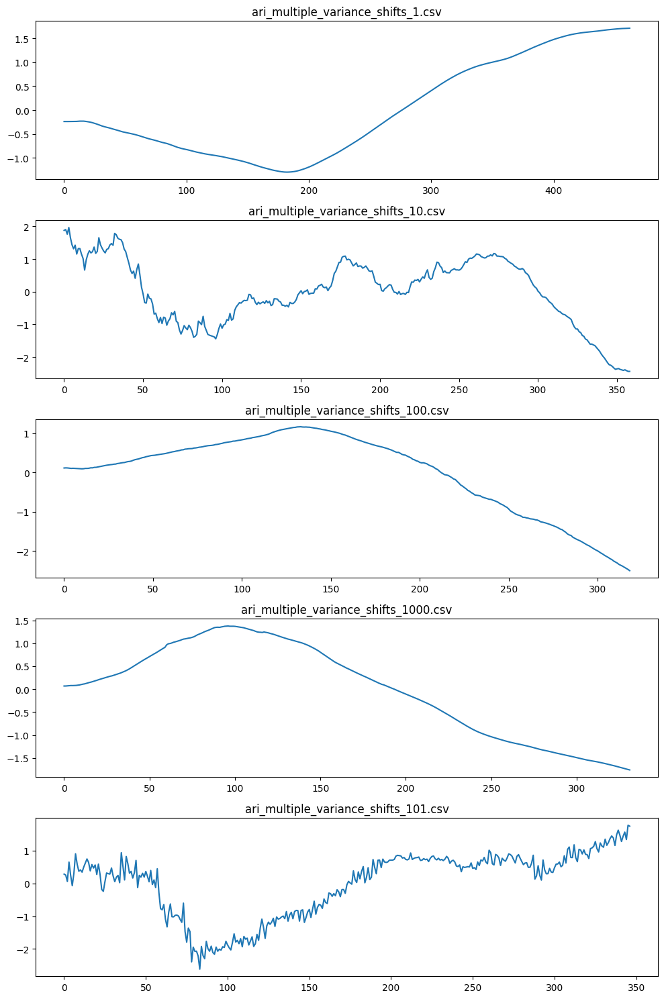

In [ ]:
plot_combinations("ari_variance_shift_multi_medium")

In [ ]:
import shutil
from google.colab import files

folders = [
    "ari_variance_shift_multi_short",
    "ari_variance_shift_multi_medium",
    "ari_variance_shift_multi_long",
    "ima_variance_shift_multi_short",
    "ima_variance_shift_multi_medium",
    "ima_variance_shift_multi_long",
    "arima_variance_shift_multi_short",
    "arima_variance_shift_multi_medium",
    "arima_variance_shift_multi_long",
    "rw_variance_shift_multi_short",
    "rw_variance_shift_multi_medium",
    "rw_variance_shift_multi_long",
    "rwd_variance_shift_multi_short",
    "rwd_variance_shift_multi_medium",
    "rwd_variance_shift_multi_long"
]

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Stochastic Trend + Trend Shift:

In [ ]:
import os
import numpy as np
import pandas as pd
import json

def generate_stochastic_with_trend_shift_dataset(
    folder,
    kind='rw',
    count=5,
    length_range=(300, 500),
    anomaly_type='single',
    location="middle",
    change_types=None  # ['direction_change'] veya ['direction_change','magnitude_change', ...]
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    for i in range(count):
        # --- 1. Stochastic base series ---
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_stochastic_trend(kind=kind)
        p, d, q = base_df.attrs.get("pdq", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        # --- 2. Trend shift ekleme ---
        if anomaly_type == 'single':
            sign = np.random.choice([-1, 1])
            if change_types is None:
                change_types = ["direction_change"]  # Default tekli
            df, _ = ts.generate_trend_shift(
                base_df,
                sign=sign,
                location=location,
                num_breaks=1,
                change_types=change_types,
                return_debug=True
            )
            label = f"{kind}_single_trend_shift_{change_types[0]}_{location}"
            loc = location

        elif anomaly_type == 'multiple':
            num_breaks = np.random.randint(2, 4)
            sign = np.random.choice([-1, 1])
            # Her break için rastgele change_type seç
            random_change_types = np.random.choice(
                ["direction_change", "magnitude_change", "direction_and_magnitude_change"],
                size=num_breaks
            ).tolist()
            df, _ = ts.generate_trend_shift(
                base_df,
                sign=sign,
                num_breaks=num_breaks,
                change_types=random_change_types,
                return_debug=True
            )
            label = f"{kind}_multiple_trend_shifts"
            loc = 0

        else:
            raise ValueError("Invalid anomaly_type")

        # --- 3. Break points ---
        break_points = df['trend_shift_points'].iloc[0]
        location_trend_pts = [int(bp) for bp in break_points]

        # --- 4. Flags ---
        slope_flag = 1 if ("magnitude_change" in change_types or "direction_and_magnitude_change" in change_types) else 0
        intercept_flag = 1 if ("direction_change" in change_types or "direction_and_magnitude_change" in change_types) else 0
        multi_flag = 1 if anomaly_type == 'multiple' else 0

        # --- 5. CSV kaydet ---
        df["label"] = label
        filename = f"{label}_{i+1}.csv"
        df.to_csv(os.path.join(folder, filename), index=False)

        # --- 6. Metadata kaydet ---
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            base_series=kind,
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            stochastic_trend=1,
            trend_shift_slope=slope_flag,
            trend_shift_intercept=intercept_flag,
            multi_trend_shift=multi_flag,
            location_trend_shift=loc,
            location_trend_pts=location_trend_pts
        )
        metadata.append(record)

    # --- 7. Metadata dosyaları ---
    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")


In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}

locations = ['beginning', 'middle', 'end']
trend_types = ['rw', 'rwd', 'ari', 'ima', 'arima']
change_types = ['direction_change', 'magnitude_change', 'direction_and_magnitude_change']

for kind in trend_types:
    for size_label, length_range in length_ranges.items():
        for loc in locations:
            for change in change_types:
                folder = f"{kind}_trend_shift_single_{change}_{loc}_{size_label}"
                generate_stochastic_with_trend_shift_dataset(
                    folder=folder,
                    kind=kind,
                    count=5,
                    length_range=length_range,
                    anomaly_type='single',
                    change_types=[change],   # ← string yerine liste
                    location=loc
                )

        folder = f"{kind}_trend_shift_multi_{size_label}"
        generate_stochastic_with_trend_shift_dataset(
            folder=folder,
            kind=kind,
            count=5,
            length_range=length_range,
            anomaly_type='multiple',
            change_types=["direction_and_magnitude_change"]  # default multiple için
        )

5 'rw_single_trend_shift_direction_change_beginning' series saved in 'rw_trend_shift_single_direction_change_beginning_short' with metadata.
5 'rw_single_trend_shift_magnitude_change_beginning' series saved in 'rw_trend_shift_single_magnitude_change_beginning_short' with metadata.
5 'rw_single_trend_shift_direction_and_magnitude_change_beginning' series saved in 'rw_trend_shift_single_direction_and_magnitude_change_beginning_short' with metadata.
5 'rw_single_trend_shift_direction_change_middle' series saved in 'rw_trend_shift_single_direction_change_middle_short' with metadata.
5 'rw_single_trend_shift_magnitude_change_middle' series saved in 'rw_trend_shift_single_magnitude_change_middle_short' with metadata.
5 'rw_single_trend_shift_direction_and_magnitude_change_middle' series saved in 'rw_trend_shift_single_direction_and_magnitude_change_middle_short' with metadata.
5 'rw_single_trend_shift_direction_change_end' series saved in 'rw_trend_shift_single_direction_change_end_short' wi

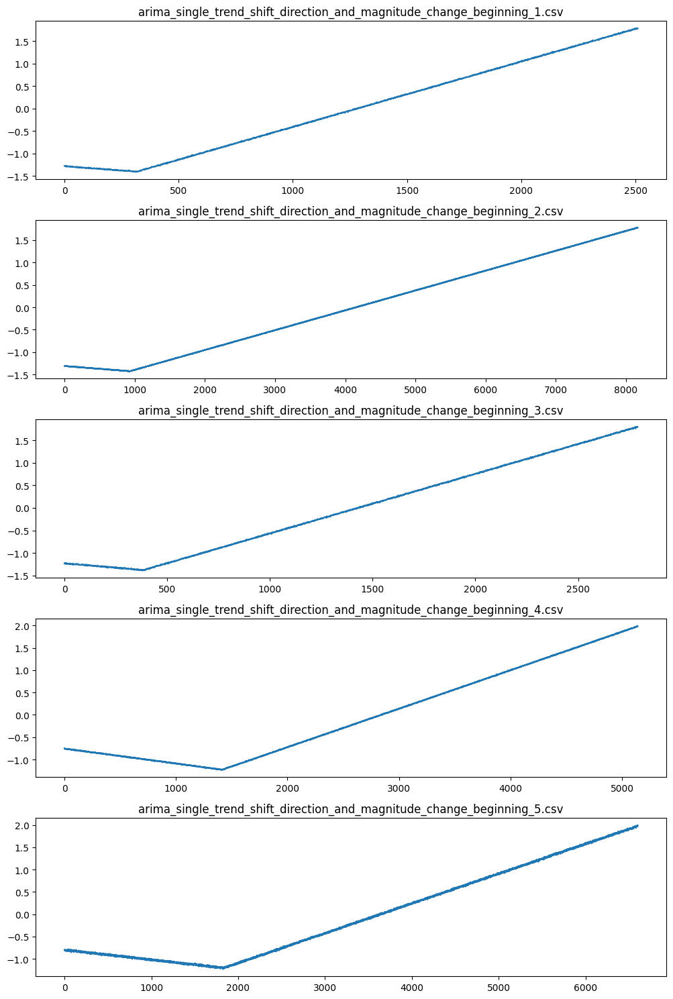

In [ ]:
plot_combinations("arima_trend_shift_single_direction_and_magnitude_change_beginning_long")

In [ ]:
import shutil
folder_arima_trend_shift_multi_short= "arima_trend_shift_multi_short"
shutil.make_archive(folder_arima_trend_shift_multi_short, 'zip', folder_arima_trend_shift_multi_short)
from google.colab import files
files.download("arima_trend_shift_multi_short.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Volatility + ...

### Volatility + Point Anomaly:

In [ ]:
def generate_volatility_with_point_anomaly_dataset(
    folder,
    model='arch',
    count=5,
    length_range=(300, 500),
    anomaly_type='single',
    location="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)

        # Volatility trend üret
        base_df = ts.generate_volatility(kind=model)
        p, d, q = base_df.attrs.get("order", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        if anomaly_type == 'single':
            loc = location if location else np.random.choice(['beginning', 'middle', 'end'])
            df = ts.generate_point_anomaly(base_df, location=loc)
            label = f"{model}_single_point_anomaly_{loc}"
            location_point = loc
            point_anomaly = 1
            multi_point_anomaly = 0

            val = df['point_anom_point'].iloc[0]
            if isinstance(val, (list, np.ndarray)):
                location_point_pts = [int(val[0])]
            else:
                location_point_pts = [int(val)]

        elif anomaly_type == 'multiple':
            df = ts.generate_point_anomalies(base_df)
            label = f"{model}_multiple_point_anomalies"
            location_point = 0
            point_anomaly = 0
            multi_point_anomaly = 1
            location_point_pts = [int(x) for x in df['point_anom_location'].iloc[0]]
        else:
            raise ValueError("Invalid anomaly_type. Must be 'single' or 'multiple'.")

        filename = f"{label}_{i+1}.csv"
        df['label'] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,

            base_series=model,
            base_coefs=str(coefs),
            order=f"({p},{d},{q})",
            volatility=1,

            point_anomaly=point_anomaly,
            multi_point_anomaly=multi_point_anomaly,
            location_point=location_point,
            location_point_pts=location_point_pts
        )
        metadata.append(record)

    # Metadata'yı kaydet
    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)

    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")

In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
volatility_models = ['arch', 'garch', 'egarch', 'aparch']

for model in volatility_models:
    for size_label, length_range in length_ranges.items():
        # Single anomaly için: her lokasyon için ayrı üret
        for loc in locations:
            folder = f"{model}_point_single_{loc}_{size_label}"
            generate_volatility_with_point_anomaly_dataset(
                folder=folder,
                model=model,
                count=1000,
                length_range=length_range,
                anomaly_type='single',
                location=loc
            )

        # Multiple anomaly için: lokasyonsuz üret
        folder = f"{model}_point_multi_{size_label}"
        generate_volatility_with_point_anomaly_dataset(
            folder=folder,
            model=model,
            count=1000,
            length_range=length_range,
            anomaly_type='multiple'
        )

1000 'arch_single_point_anomaly_beginning' series saved in 'arch_point_single_beginning_short' with metadata.
1000 'arch_single_point_anomaly_middle' series saved in 'arch_point_single_middle_short' with metadata.
1000 'arch_single_point_anomaly_end' series saved in 'arch_point_single_end_short' with metadata.
1000 'arch_multiple_point_anomalies' series saved in 'arch_point_multi_short' with metadata.
1000 'arch_single_point_anomaly_beginning' series saved in 'arch_point_single_beginning_medium' with metadata.
1000 'arch_single_point_anomaly_middle' series saved in 'arch_point_single_middle_medium' with metadata.
1000 'arch_single_point_anomaly_end' series saved in 'arch_point_single_end_medium' with metadata.
1000 'arch_multiple_point_anomalies' series saved in 'arch_point_multi_medium' with metadata.
1000 'arch_single_point_anomaly_beginning' series saved in 'arch_point_single_beginning_long' with metadata.
1000 'arch_single_point_anomaly_middle' series saved in 'arch_point_single_mi

In [ ]:
generate_volatility_with_point_anomaly_dataset(
    folder="garch_point_single_middle_medium",
    model="garch",
    count=1000,
    length_range=(300, 500),
    anomaly_type='single',
    location='middle'
)

1000 'garch_single_point_anomaly_middle' series saved in 'garch_point_single_middle_medium' with metadata.


In [ ]:
import shutil
folder_garch_point_single_middle_medium= "garch_point_single_middle_medium"
shutil.make_archive(folder_garch_point_single_middle_medium, 'zip', folder_garch_point_single_middle_medium)
from google.colab import files
files.download("garch_point_single_middle_medium.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

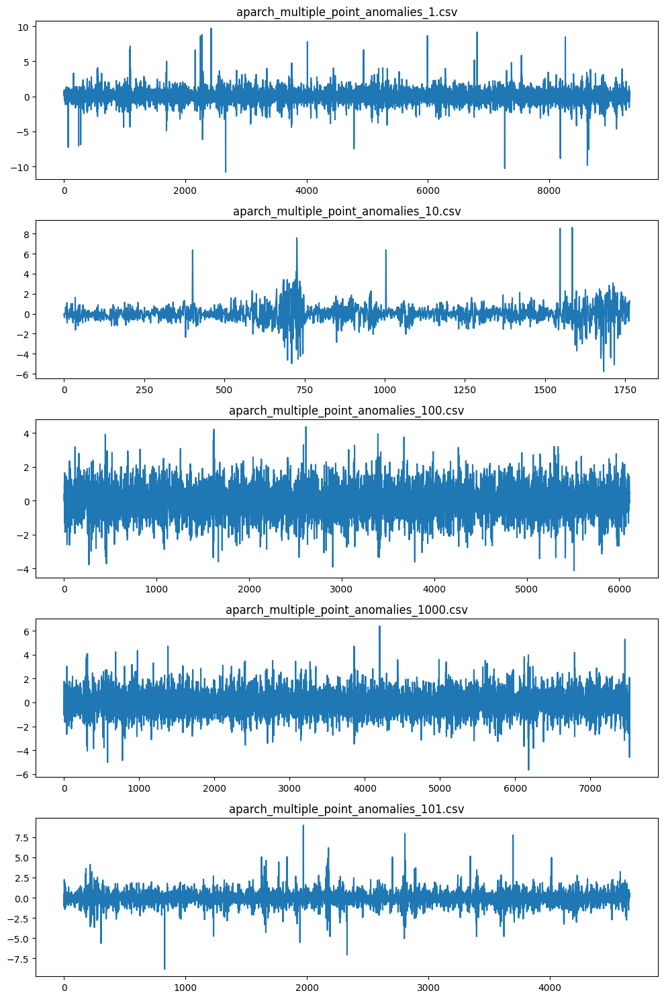

In [ ]:
plot_combinations("aparch_point_multi_long")

In [ ]:
import shutil
from google.colab import files
import os
import glob
folders = [f for f in glob.glob("egarch_point*") if os.path.isdir(f)]

print(f"{len(folders)} klasör bulundu ve zipleniyor...")

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

12 klasör bulundu ve zipleniyor...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Volatility + Collective Anomaly:

In [ ]:
def generate_volatility_with_collective_anomaly_dataset(
    folder,
    model='arch',
    count=5,
    length_range=(300, 500),
    anomaly_type='single',
    location="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)

        base_df = ts.generate_volatility(kind=model)
        p, d, q = base_df.attrs.get("order", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        if anomaly_type == 'single':
            loc = location if location else np.random.choice(['beginning', 'middle', 'end'])
            df = ts.generate_collective_anomalies(base_df, location=loc)
            label = f"{model}_single_collective_anomaly_{loc}"
            location_collective = loc
            collective_anomaly = 1
            multi_collective_anomaly = 0
        elif anomaly_type == 'multiple':
            num_anomalies = np.random.randint(2, 5)
            df = ts.generate_collective_anomalies(base_df, num_anomalies=num_anomalies)
            label = f"{model}_multiple_collective_anomalies"
            location_collective = 0
            collective_anomaly = 0
            multi_collective_anomaly = 1
        else:
            raise ValueError("Invalid anomaly_type. Must be 'single' or 'multiple'.")

        # 3. Başlangıç ve bitiş noktalarını al
        starts = df['collect_anom_start'].iloc[0]
        ends = df['collect_anom_end'].iloc[0]
        location_collective_pts = list(zip(map(int, starts), map(int, ends)))

        # 4. Dosya kaydet
        filename = f"{label}_{i+1}.csv"
        df['label'] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        # 5. Metadata kaydı
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,

            base_series=model,
            base_coefs=str(coefs),
            order=f"({p},{d},{q})",
            volatility=1,

            collective_anomaly=collective_anomaly,
            multi_collective_anomaly=multi_collective_anomaly,
            location_collective=location_collective,
            location_collective_pts=location_collective_pts
        )
        metadata.append(record)

    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4, default=make_json_serializable)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")


In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
volatility_types = ['arch', 'garch', 'egarch', 'aparch']

for kind in volatility_types:
    for size_label, length_range in length_ranges.items():
        for loc in locations:
            folder = f"{kind}_collective_single_{loc}_{size_label}"
            generate_volatility_with_collective_anomaly_dataset(
                folder=folder,
                model=kind,
                count=1000,
                length_range=length_range,
                anomaly_type='single',
                location=loc
            )

        folder = f"{kind}_collective_multi_{size_label}"
        generate_volatility_with_collective_anomaly_dataset(
            folder=folder,
            model=kind,
            count=1000,
            length_range=length_range,
            anomaly_type='multiple'
        )


1000 'arch_single_collective_anomaly_beginning' series saved in 'arch_collective_single_beginning_short' with metadata.
1000 'arch_single_collective_anomaly_middle' series saved in 'arch_collective_single_middle_short' with metadata.
1000 'arch_single_collective_anomaly_end' series saved in 'arch_collective_single_end_short' with metadata.
1000 'arch_multiple_collective_anomalies' series saved in 'arch_collective_multi_short' with metadata.
1000 'arch_single_collective_anomaly_beginning' series saved in 'arch_collective_single_beginning_medium' with metadata.
1000 'arch_single_collective_anomaly_middle' series saved in 'arch_collective_single_middle_medium' with metadata.
1000 'arch_single_collective_anomaly_end' series saved in 'arch_collective_single_end_medium' with metadata.
1000 'arch_multiple_collective_anomalies' series saved in 'arch_collective_multi_medium' with metadata.
1000 'arch_single_collective_anomaly_beginning' series saved in 'arch_collective_single_beginning_long' wi

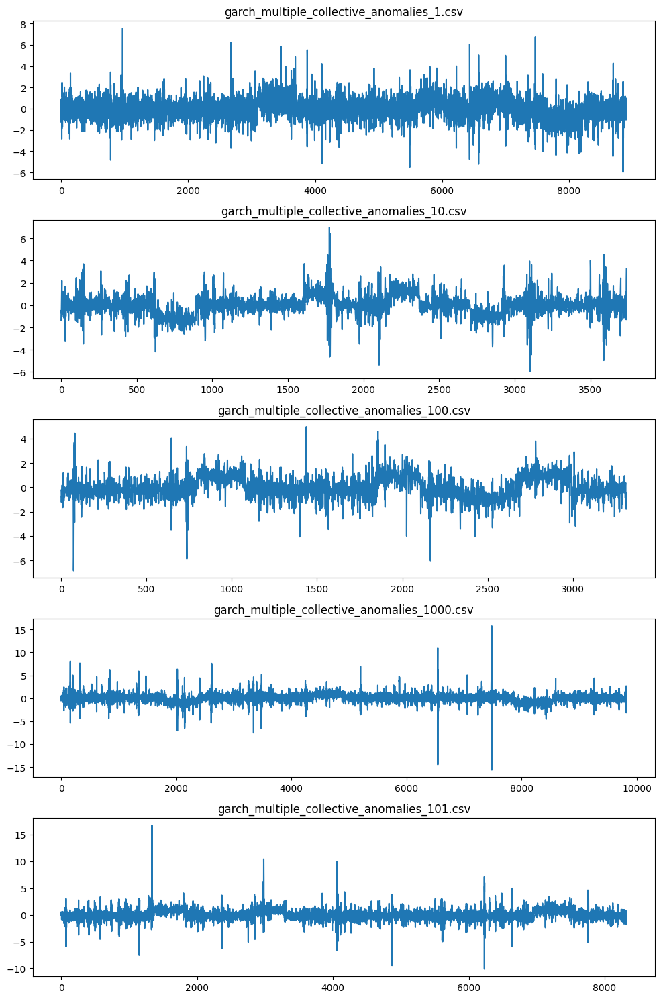

In [ ]:
plot_combinations("garch_collective_multi_long")

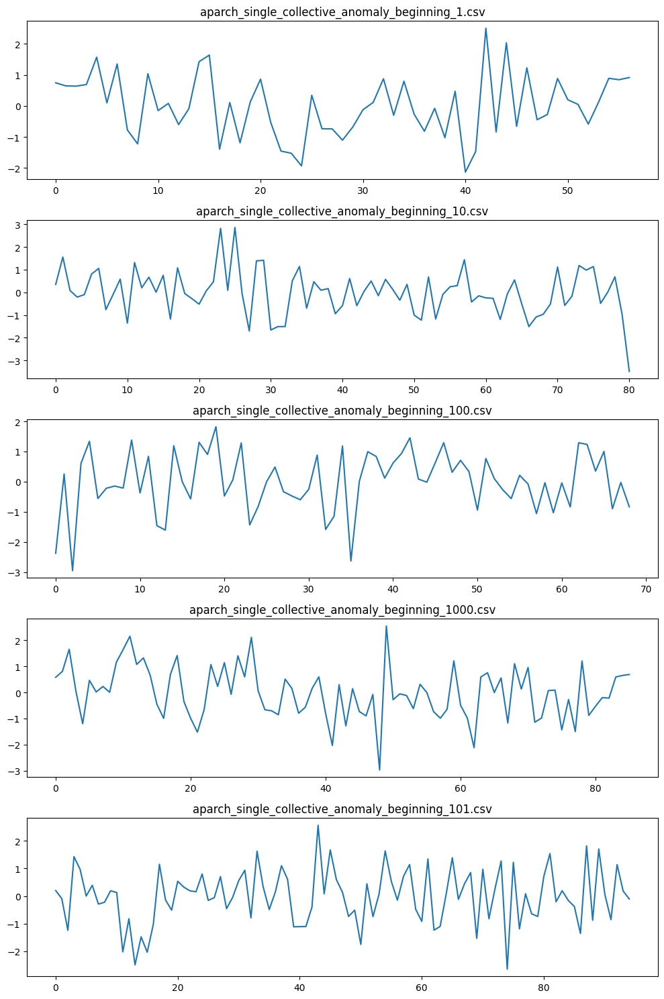

In [ ]:
plot_combinations("aparch_collective_single_beginning_short")

In [ ]:
import shutil
from google.colab import files
import os
import glob
folders = [f for f in glob.glob("aparch_collective*") if os.path.isdir(f)]

print(f"{len(folders)} klasör bulundu ve zipleniyor...")

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

12 klasör bulundu ve zipleniyor...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Volatility + Mean Shift:

In [ ]:
def generate_volatility_with_mean_shift_anomaly_dataset(
    folder,
    model='garch',
    count=5,
    length_range=(300, 500),
    anomaly_type='single',
    shift_type="increase",
    location="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_volatility(kind=model)
        p, d, q = base_df.attrs.get("order", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        if anomaly_type == 'single':
            sign = 1 if shift_type == 'increase' else -1
            df, _ = ts.generate_mean_shift(
                base_df, signs=[sign], location=location, num_breaks=1, return_debug=True
            )
            label = f"{model}_single_mean_shift_{shift_type}_{location}"
            loc = location
        elif anomaly_type == 'multiple':
            num_breaks = np.random.randint(2, 4)
            random_signs = list(np.random.choice([-1, 1], size=num_breaks))
            df, _ = ts.generate_mean_shift(
                base_df, num_breaks=num_breaks, signs=random_signs, return_debug=True
            )
            label = f"{model}_multiple_mean_shifts"
            loc = 0
        else:
            raise ValueError("Invalid anomaly_type")

        # NumPy türlerini temizle
        break_points = df['mean_shift_point'].iloc[0]
        magnitudes = df['mean_shift_magnitude'].iloc[0]

        break_points = list(map(int, break_points)) if isinstance(break_points, (list, np.ndarray)) else [int(break_points)]
        magnitudes = list(map(float, magnitudes)) if isinstance(magnitudes, (list, np.ndarray)) else [float(magnitudes)]

        location_mean_pts = list(zip(break_points, magnitudes))

        df["label"] = label
        df.to_csv(os.path.join(folder, f"{label}_{i+1}.csv"), index=False)

        record = create_metadata_record(
            filename=f"{label}_{i+1}.csv",
            length=length,
            label=label,
            base_series=model,
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            volatility=1,
            mean_shift_increase=1 if anomaly_type == 'single' and shift_type == 'increase' else 0,
            mean_shift_decrease=1 if anomaly_type == 'single' and shift_type == 'decrease' else 0,
            multi_mean_shift=1 if anomaly_type == 'multiple' else 0,
            location_mean_shift=loc,
            location_mean_pts=location_mean_pts
        )
        metadata.append(record)

    # Metadata kayıt
    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")

In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}

locations = ['beginning', 'middle', 'end']
shift_types = ['increase', 'decrease']
vol_models = ['arch', 'garch', 'egarch', 'aparch']

for model in vol_models:
    for size_label, length_range in length_ranges.items():

        for loc in locations:
            for shift in shift_types:
                folder = f"{model}_mean_shift_single_{shift}_{loc}_{size_label}"
                generate_volatility_with_mean_shift_anomaly_dataset(
                    folder=folder,
                    model=model,
                    count=1000,
                    length_range=length_range,
                    anomaly_type='single',
                    shift_type=shift,
                    location=loc
                )

        folder = f"{model}_mean_shift_multi_{size_label}"
        generate_volatility_with_mean_shift_anomaly_dataset(
            folder=folder,
            model=model,
            count=1000,
            length_range=length_range,
            anomaly_type='multiple'
        )

1000 'arch_single_mean_shift_increase_beginning' series saved in 'arch_mean_shift_single_increase_beginning_short' with metadata.
1000 'arch_single_mean_shift_decrease_beginning' series saved in 'arch_mean_shift_single_decrease_beginning_short' with metadata.
1000 'arch_single_mean_shift_increase_middle' series saved in 'arch_mean_shift_single_increase_middle_short' with metadata.
1000 'arch_single_mean_shift_decrease_middle' series saved in 'arch_mean_shift_single_decrease_middle_short' with metadata.
1000 'arch_single_mean_shift_increase_end' series saved in 'arch_mean_shift_single_increase_end_short' with metadata.
1000 'arch_single_mean_shift_decrease_end' series saved in 'arch_mean_shift_single_decrease_end_short' with metadata.
1000 'arch_multiple_mean_shifts' series saved in 'arch_mean_shift_multi_short' with metadata.
1000 'arch_single_mean_shift_increase_beginning' series saved in 'arch_mean_shift_single_increase_beginning_medium' with metadata.
1000 'arch_single_mean_shift_de

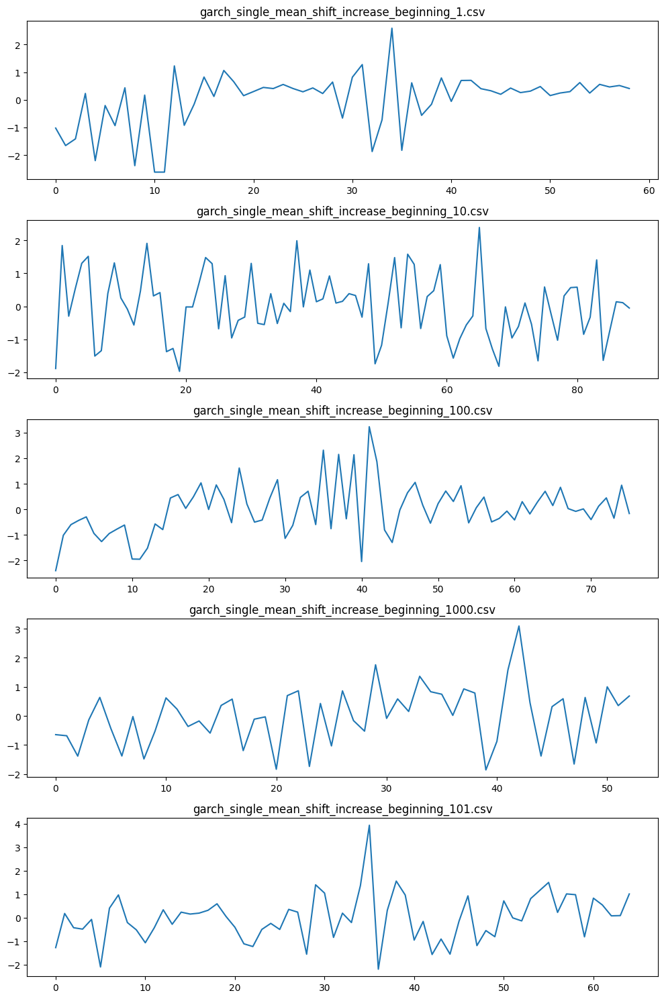

In [ ]:
plot_combinations("garch_mean_shift_single_increase_beginning_short")

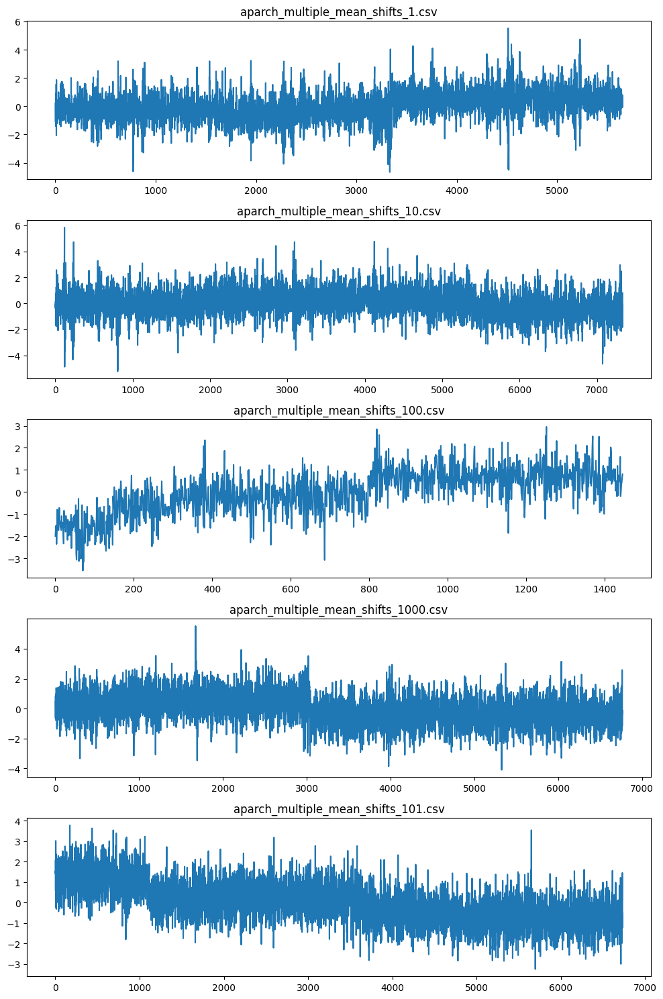

In [ ]:
plot_combinations("aparch_mean_shift_multi_long")

In [ ]:
import shutil
folder_aparch_mean_shift_multi_long = "aparch_mean_shift_multi_long"
shutil.make_archive(folder_aparch_mean_shift_multi_long, 'zip', folder_aparch_mean_shift_multi_long)
from google.colab import files
files.download("aparch_mean_shift_multi_long.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
folders = [f for f in glob.glob("aparch_mean_shift*") if os.path.isdir(f)]

print(f"{len(folders)} klasör bulundu ve zipleniyor...")

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

21 klasör bulundu ve zipleniyor...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Volatility + Variance Shift:

In [ ]:

def generate_volatility_with_variance_shift_dataset(
    folder,
    model='garch',   # ARCH, GARCH, EGARCH, APARCH gibi modeller
    count=5,
    length_range=(300, 500),
    anomaly_type='single',
    location="middle",
    direction=None
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)

        # Volatility serisi üret
        base_df = ts.generate_volatility(kind=model)
        p, d, q = base_df.attrs.get("order", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        # Anomali ekleme
        if anomaly_type == 'single':
            sign = 1 if direction == 'increase' else -1
            df, _ = ts.generate_variance_shift(
                base_df, signs=[sign], location=location, num_breaks=1, return_debug=True
            )
            label = f"{model}_single_variance_shift_{direction}_{location}"
            loc = location
        elif anomaly_type == 'multiple':
            num_breaks = np.random.randint(2, 4)
            random_signs = list(np.random.choice([-1, 1], size=num_breaks))
            df, _ = ts.generate_variance_shift(
                base_df, num_breaks=num_breaks, signs=random_signs, return_debug=True
            )
            label = f"{model}_multiple_variance_shifts"
            loc = 0
        else:
            raise ValueError("Invalid anomaly_type")

        # Çıktıyı kaydet
        df["label"] = label
        filename = f"{label}_{i+1}.csv"
        df.to_csv(os.path.join(folder, filename), index=False)

        # Noktalar ve büyüklükler
        break_points = df['variance_shift_points'].iloc[0]
        magnitudes = df['variance_shift_magnitude'].iloc[0]
        if isinstance(magnitudes, (float, int)):
            location_variance_pts = [(int(break_points[0]), float(magnitudes))]
        else:
            location_variance_pts = [(int(bp), float(mag)) for bp, mag in zip(break_points, magnitudes)]

        # Metadata kaydı
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            base_series=model,
            order=f"({p},{d},{q})",
            base_coefs=str(coefs),
            volatility=1,
            variance_shift_increase=1 if anomaly_type == 'single' and direction == 'increase' else 0,
            variance_shift_decrease=1 if anomaly_type == 'single' and direction == 'decrease' else 0,
            multi_variance_shift=1 if anomaly_type == 'multiple' else 0,
            location_variance_shift=loc,
            location_variance_pts=location_variance_pts
        )
        metadata.append(record)

    # Metadata dosyaları kaydet
    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=4)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")


In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}

locations = ['beginning', 'middle', 'end']
volatility_models = ['arch', 'garch', 'egarch', 'aparch']

for model in volatility_models:
    for size_label, length_range in length_ranges.items():
        for loc in locations:
            for direction in ['increase', 'decrease']:
                folder = f"{model}_variance_shift_single_{direction}_{loc}_{size_label}"
                generate_volatility_with_variance_shift_dataset(
                    folder=folder,
                    model=model,
                    count=1000,
                    length_range=length_range,
                    anomaly_type='single',
                    location=loc,
                    direction=direction
                )

        # Multiple variance shift (direction yok)
        folder = f"{model}_variance_shift_multi_{size_label}"
        generate_volatility_with_variance_shift_dataset(
            folder=folder,
            model=model,
            count=1000,
            length_range=length_range,
            anomaly_type='multiple'
        )

1000 'arch_single_variance_shift_increase_beginning' series saved in 'arch_variance_shift_single_increase_beginning_short' with metadata.
1000 'arch_single_variance_shift_decrease_beginning' series saved in 'arch_variance_shift_single_decrease_beginning_short' with metadata.
1000 'arch_single_variance_shift_increase_middle' series saved in 'arch_variance_shift_single_increase_middle_short' with metadata.
1000 'arch_single_variance_shift_decrease_middle' series saved in 'arch_variance_shift_single_decrease_middle_short' with metadata.
1000 'arch_single_variance_shift_increase_end' series saved in 'arch_variance_shift_single_increase_end_short' with metadata.
1000 'arch_single_variance_shift_decrease_end' series saved in 'arch_variance_shift_single_decrease_end_short' with metadata.
1000 'arch_multiple_variance_shifts' series saved in 'arch_variance_shift_multi_short' with metadata.
1000 'arch_single_variance_shift_increase_beginning' series saved in 'arch_variance_shift_single_increase_

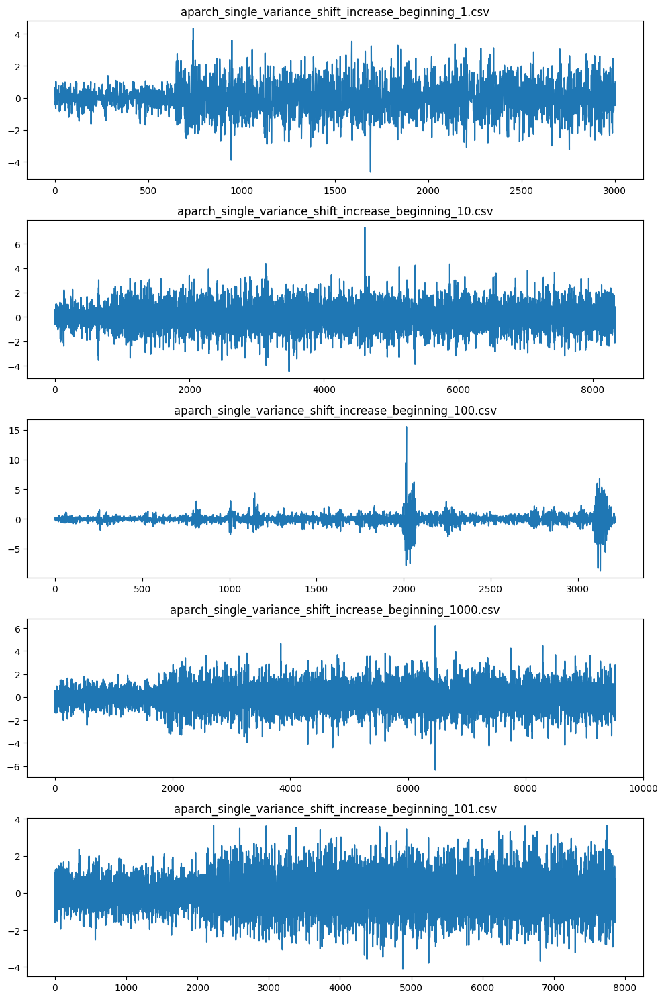

In [ ]:
plot_combinations("aparch_variance_shift_single_increase_beginning_long")

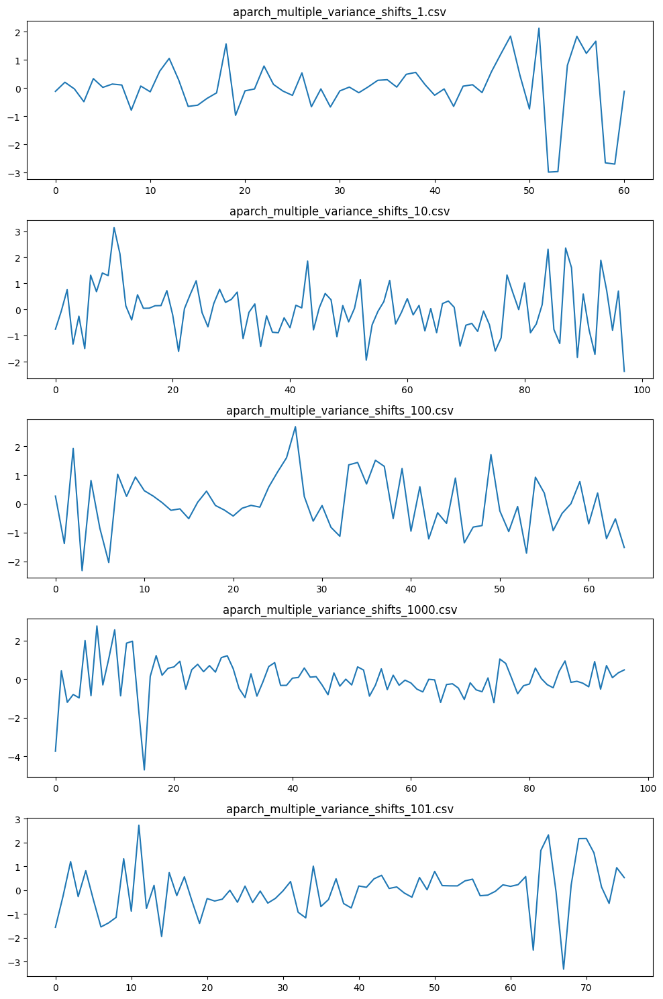

In [ ]:
plot_combinations("aparch_variance_shift_multi_short")

In [ ]:
import shutil
folder_aparch_variance_shift_multi_short = "aparch_variance_shift_multi_short"
shutil.make_archive(folder_aparch_variance_shift_multi_short, 'zip', folder_aparch_variance_shift_multi_short)
from google.colab import files
files.download("aparch_variance_shift_multi_short.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
folders = [f for f in glob.glob("arch_variance_shift*") if os.path.isdir(f)]

print(f"{len(folders)} klasör bulundu ve zipleniyor...")

for folder in folders:
    zip_name = f"{folder}.zip"
    shutil.make_archive(folder, 'zip', folder)
    files.download(zip_name)

21 klasör bulundu ve zipleniyor...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Volatility + Trend Shift:

# 3 COMBINATIONS:

### Stochastic Trend + Point Anomaly + Collective Anomaly:

In [ ]:
def generate_stochastic_with_point_and_collective_anomalies_dataset(
    folder,
    kind='rw',
    count=5,
    length_range=(300, 500),
    point_type='single',
    collective_type='single',
    location_point="middle",
    location_collective="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    trend_label_map = {
        'rw': 'stochastic_trend_rw',
        'rwd': 'stochastic_trend_rwd',
        'ari': 'stochastic_trend_ari',
        'ima': 'stochastic_trend_ima',
        'arima': 'stochastic_trend_arima'
    }

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)

        # base stochastic trend
        base_df = ts.generate_stochastic_trend(kind=kind)
        p, d, q = base_df.attrs.get("pdq", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        # point anomaly
        if point_type == 'single':
            loc_point = location_point if location_point else np.random.choice(['beginning', 'middle', 'end'])
            df = ts.generate_point_anomaly(base_df, location=loc_point)
            is_multi_point_anomaly = 0
        elif point_type == 'multiple':
            df = ts.generate_point_anomalies(base_df)
            loc_point = 0
            is_multi_point_anomaly = 1
        else:
            raise ValueError("Invalid point_type")

        # collective anomaly
        if collective_type == 'single':
            loc_collective = location_collective if location_collective else np.random.choice(['beginning', 'middle', 'end'])
            df = ts.generate_collective_anomalies(df, num_anomalies=1, location=loc_collective)
            is_multi_collective_anomaly = 0
        elif collective_type == 'multiple':
            df = ts.generate_collective_anomalies(df, num_anomalies=np.random.randint(2, 5))
            loc_collective = 0
            is_multi_collective_anomaly = 1
        else:
            raise ValueError("Invalid collective_type")


        label_parts = [kind, "point", point_type]
        if point_type == 'single':
            label_parts.append(loc_point)
        label_parts += ["collective", collective_type]
        if collective_type == 'single':
            label_parts.append(loc_collective)

        label = "_".join(str(p) for p in label_parts if p is not None)
        filename = f"{label}_{i+1}.csv"

        df['label'] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            point_anomaly=1,
            collective_anomaly=1,
            location_point=loc_point if point_type == 'single' else 0,
            location_collective=loc_collective if collective_type == 'single' else 0,
            is_multi_point_anomaly=is_multi_point_anomaly,
            is_multi_collective_anomaly=is_multi_collective_anomaly,
            stoc_params=f"({p},{d},{q})",
            stoc_coef=str(coefs),
            **{trend_label_map[kind]: 1}
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "all_series.pkl"), "wb") as f:
        pickle.dump(metadata, f)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")


In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
types = ['rw', 'rwd', 'ari', 'ima', 'arima']
point_types = ['single', 'multiple']
collective_types = ['single', 'multiple']

for kind in types:
    for size_label, length_range in length_ranges.items():
        for point_type in point_types:
            for collective_type in collective_types:

                #her ikisi de single
                if point_type == 'single' and collective_type == 'single':
                    for loc_point in locations:
                        for loc_collective in locations:
                            folder = f"{kind}_pt_{point_type}_{loc_point}_ct_{collective_type}_{loc_collective}_{size_label}"
                            generate_stochastic_with_point_and_collective_anomalies_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                point_type=point_type,
                                collective_type=collective_type,
                                location_point=loc_point,
                                location_collective=loc_collective
                            )

                # point single, collective multiple
                elif point_type == 'single' and collective_type == 'multiple':
                    for loc_point in locations:
                        folder = f"{kind}_pt_{point_type}_{loc_point}_ct_{collective_type}_{size_label}"
                        generate_stochastic_with_point_and_collective_anomalies_dataset(
                            folder=folder,
                            kind=kind,
                            count=5,
                            length_range=length_range,
                            point_type=point_type,
                            collective_type=collective_type,
                            location_point=loc_point
                        )

                # point multiple, collective single
                elif point_type == 'multiple' and collective_type == 'single':
                    for loc_collective in locations:
                        folder = f"{kind}_pt_{point_type}_ct_{collective_type}_{loc_collective}_{size_label}"
                        generate_stochastic_with_point_and_collective_anomalies_dataset(
                            folder=folder,
                            kind=kind,
                            count=5,
                            length_range=length_range,
                            point_type=point_type,
                            collective_type=collective_type,
                            location_collective=loc_collective
                        )

                # ikisi de multiple
                else:
                    folder = f"{kind}_pt_{point_type}_ct_{collective_type}_{size_label}"
                    generate_stochastic_with_point_and_collective_anomalies_dataset(
                        folder=folder,
                        kind=kind,
                        count=5,
                        length_range=length_range,
                        point_type=point_type,
                        collective_type=collective_type
                    )

5 'rw_point_single_beginning_collective_single_beginning' series saved in 'rw_pt_single_beginning_ct_single_beginning_short' with metadata.
5 'rw_point_single_beginning_collective_single_middle' series saved in 'rw_pt_single_beginning_ct_single_middle_short' with metadata.
5 'rw_point_single_beginning_collective_single_end' series saved in 'rw_pt_single_beginning_ct_single_end_short' with metadata.
5 'rw_point_single_middle_collective_single_beginning' series saved in 'rw_pt_single_middle_ct_single_beginning_short' with metadata.
5 'rw_point_single_middle_collective_single_middle' series saved in 'rw_pt_single_middle_ct_single_middle_short' with metadata.
5 'rw_point_single_middle_collective_single_end' series saved in 'rw_pt_single_middle_ct_single_end_short' with metadata.
5 'rw_point_single_end_collective_single_beginning' series saved in 'rw_pt_single_end_ct_single_beginning_short' with metadata.
5 'rw_point_single_end_collective_single_middle' series saved in 'rw_pt_single_end_ct_

In [ ]:
generate_stochastic_with_point_and_collective_anomalies_dataset(
    folder="rw_pt_single_middle_ct_single_end_long",
    kind="rw",
    count=5,
    length_range=(1000, 10000),
    point_type="single",
    collective_type="single",
    location_point="middle",
    location_collective="end"
)

5 'rw_point_single_middle_collective_single_end' series saved in 'rw_pt_single_middle_ct_single_end_long' with metadata.


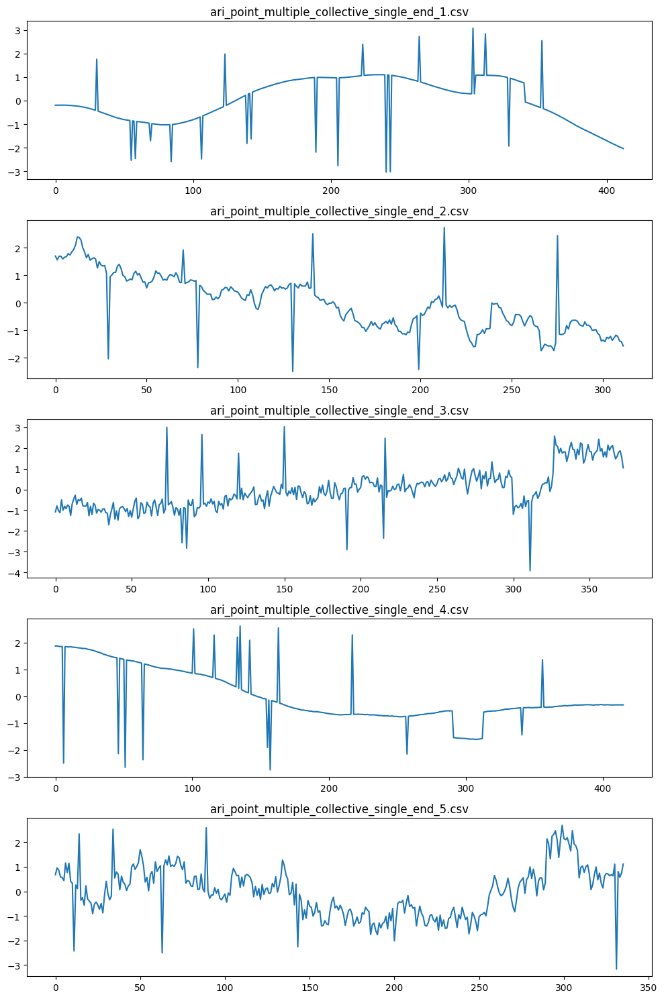

In [ ]:
plot_combinations("ari_pt_multiple_ct_single_end_medium")

In [ ]:

folder_ari_pt_multiple_ct_single_end_medium = "ari_pt_multiple_ct_single_end_medium"
shutil.make_archive(folder_ari_pt_multiple_ct_single_end_medium, 'zip', folder_ari_pt_multiple_ct_single_end_medium)
from google.colab import files
files.download("ari_pt_multiple_ct_single_end_medium.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import re
import pandas as pd

def parse_indices(value):
    """Boşluk veya virgülle ayrılmış indeksleri listeye çevirir."""
    if pd.isna(value):
        return []
    if isinstance(value, str):
        return [int(x) for x in re.findall(r'\d+', value)]
    elif isinstance(value, int):
        return [value]
    elif isinstance(value, list):
        return value
    return []

In [ ]:

def enhanced_plot_combinations(folder, n=5):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()

        if 'data' in df.columns:
            ax = plt.subplot(n, 1, i + 1)
            ax.plot(df['data'], color='black')

            # Nokta anomalileri (kırmızı daire)
            if 'point_anom_location' in df.columns:
                points = parse_indices(df['point_anom_location'].iloc[0])
                ax.scatter(points, df['data'].iloc[points], color='red', s=40, marker='o', label='Point Anomaly')

            # Toplu anomaliler (turuncu arka plan)
            if 'collect_anom_start' in df.columns and 'collect_anom_end' in df.columns:
                starts = parse_indices(df['collect_anom_start'].iloc[0])
                ends = parse_indices(df['collect_anom_end'].iloc[0])
                for j, (s, e) in enumerate(zip(starts, ends)):
                    label = 'Collective Anomaly' if j == 0 else None
                    ax.axvspan(s, e, color='orange', alpha=0.3, label=label)

            ax.set_title(fname)
            ax.legend(loc='upper right')

    plt.tight_layout()
    plt.show()

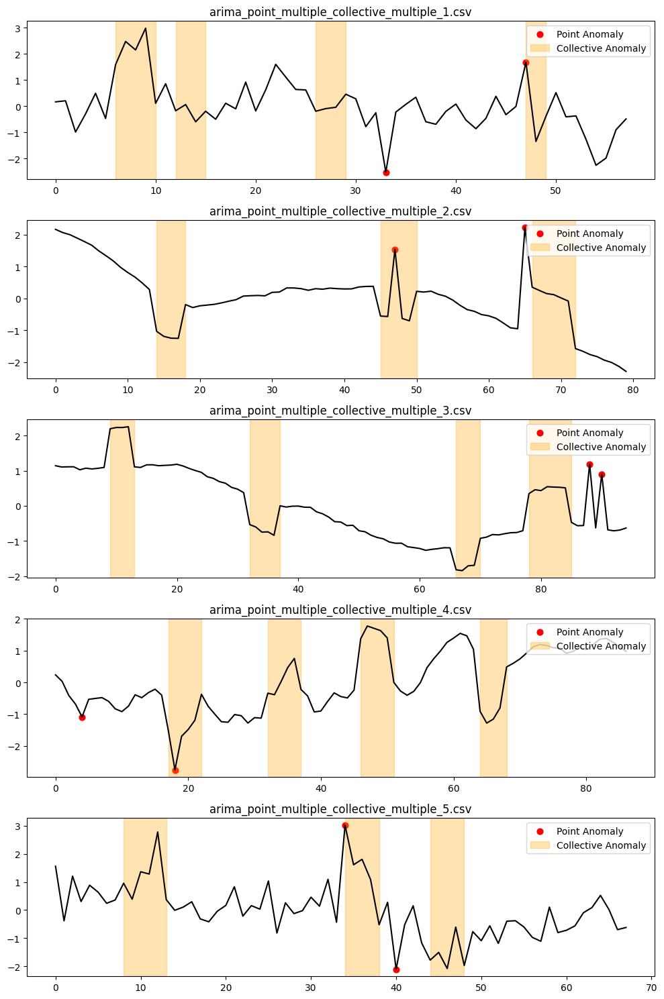

In [ ]:
enhanced_plot_combinations("arima_pt_multiple_ct_multiple_short")

### Stochastic Trend + Point Anomaly + Mean Shift:

In [ ]:
def generate_stochastic_with_point_and_mean_shift_dataset(
    folder,
    kind='rw',
    count=5,
    length_range=(300, 500),
    point_type='single',
    mean_shift_type='single',
    shift_type='increase',
    location_point="middle",
    location_mean="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    trend_label_map = {
        'rw': 'stochastic_trend_rw',
        'rwd': 'stochastic_trend_rwd',
        'ari': 'stochastic_trend_ari',
        'ima': 'stochastic_trend_ima',
        'arima': 'stochastic_trend_arima'
    }

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_stochastic_trend(kind=kind)
        p, d, q = base_df.attrs.get("pdq", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        # Point anomaly
        if point_type == 'single':
            df = ts.generate_point_anomaly(base_df, location=location_point)
            is_multi_point_anomaly = 0
        elif point_type == 'multiple':
            df = ts.generate_point_anomalies(base_df)
            location_point = 0
            is_multi_point_anomaly = 1
        else:
            raise ValueError("Invalid point_type")

        # Mean shift
        if mean_shift_type == 'single':
            sign = 1 if shift_type == 'increase' else -1
            df, _ = ts.generate_mean_shift(df, signs=[sign], location=location_mean, num_breaks=1, return_debug=True)
            is_multi_mean_shift = 0
            shift_type_increase = 1 if shift_type == "increase" else 0
            shift_type_decrease = 1 if shift_type == "decrease" else 0
            loc_mean = location_mean
        elif mean_shift_type == 'multiple':
            num_breaks = np.random.randint(2, 4)
            signs = list(np.random.choice([-1, 1], size=num_breaks))
            df, _ = ts.generate_mean_shift(df, num_breaks=num_breaks, signs=signs, return_debug=True)
            is_multi_mean_shift = 1
            shift_type_increase = 0
            shift_type_decrease = 0
            loc_mean = "NA"
        else:
            raise ValueError("Invalid mean_shift_type")

        # Label
        label_parts = [kind, "point", point_type]
        if point_type == 'single':
            label_parts.append(location_point)
        label_parts += ["mean", mean_shift_type]
        if mean_shift_type == 'single':
            label_parts += [shift_type, location_mean]

        label = "_".join(str(p) for p in label_parts)
        filename = f"{label}_{i+1}.csv"
        df["label"] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        # Metadata
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            point_anomaly=1,
            mean_shift=1,
            shift_type_increase=shift_type_increase,
            shift_type_decrease=shift_type_decrease,
            location_point=location_point if point_type == 'single' else 0,
            location_mean_shift=loc_mean,
            is_multi_point_anomaly=is_multi_point_anomaly,
            is_multi_mean_shift=is_multi_mean_shift,
            stoc_params=f"({p},{d},{q})",
            stoc_coef=str(coefs),
            **{trend_label_map[kind]: 1}
        )
        metadata.append(record)

    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "all_series.pkl"), "wb") as f:
        pickle.dump(metadata, f)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")

In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
types = ['rw', 'rwd', 'ari', 'ima', 'arima']
point_types = ['single', 'multiple']
shift_types = ['increase', 'decrease']

for kind in types:
    for size_label, length_range in length_ranges.items():
        for point_type in point_types:

            # SINGLE MEAN SHIFT
            for shift_type in shift_types:
                if point_type == 'single':
                    for loc_point in locations:
                        for loc_mean in locations:
                            folder = f"{kind}_pt_{point_type}_{loc_point}_ms_single_{shift_type}_{loc_mean}_{size_label}"
                            generate_stochastic_with_point_and_mean_shift_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                point_type=point_type,
                                mean_shift_type="single",
                                shift_type=shift_type,
                                location_point=loc_point,
                                location_mean=loc_mean
                            )
                else:  # point multiple
                    for loc_mean in locations:
                        folder = f"{kind}_pt_{point_type}_ms_single_{shift_type}_{loc_mean}_{size_label}"
                        generate_stochastic_with_point_and_mean_shift_dataset(
                            folder=folder,
                            kind=kind,
                            count=5,
                            length_range=length_range,
                            point_type=point_type,
                            mean_shift_type="single",
                            shift_type=shift_type,
                            location_mean=loc_mean
                        )

            # MULTIPLE MEAN SHIFT (konum ve shift tipi bilinemez)
            if point_type == 'single':
                for loc_point in locations:
                    folder = f"{kind}_pt_{point_type}_{loc_point}_ms_multiple_{size_label}"
                    generate_stochastic_with_point_and_mean_shift_dataset(
                        folder=folder,
                        kind=kind,
                        count=5,
                        length_range=length_range,
                        point_type=point_type,
                        mean_shift_type="multiple",
                        location_point=loc_point
                    )
            else:
                folder = f"{kind}_pt_{point_type}_ms_multiple_{size_label}"
                generate_stochastic_with_point_and_mean_shift_dataset(
                    folder=folder,
                    kind=kind,
                    count=5,
                    length_range=length_range,
                    point_type=point_type,
                    mean_shift_type="multiple"
                )

5 'rw_point_single_beginning_mean_single_increase_beginning' series saved in 'rw_pt_single_beginning_ms_single_increase_beginning_short' with metadata.
5 'rw_point_single_beginning_mean_single_increase_middle' series saved in 'rw_pt_single_beginning_ms_single_increase_middle_short' with metadata.
5 'rw_point_single_beginning_mean_single_increase_end' series saved in 'rw_pt_single_beginning_ms_single_increase_end_short' with metadata.
5 'rw_point_single_middle_mean_single_increase_beginning' series saved in 'rw_pt_single_middle_ms_single_increase_beginning_short' with metadata.
5 'rw_point_single_middle_mean_single_increase_middle' series saved in 'rw_pt_single_middle_ms_single_increase_middle_short' with metadata.
5 'rw_point_single_middle_mean_single_increase_end' series saved in 'rw_pt_single_middle_ms_single_increase_end_short' with metadata.
5 'rw_point_single_end_mean_single_increase_beginning' series saved in 'rw_pt_single_end_ms_single_increase_beginning_short' with metadata.
5 

In [ ]:
generate_stochastic_with_point_and_mean_shift_dataset(
    folder="rwd_pt_single_end_ms_single_decrease_beginning_long",
    kind="rwd",
    count=5,
    length_range=(300,500),
    point_type="single",
    mean_shift_type="single",
    shift_type="decrease",
    location_point="end",
    location_mean="beginning"
)

5 'rwd_point_single_end_mean_single_decrease_beginning' series saved in 'rwd_pt_single_end_ms_single_decrease_beginning_long' with metadata.


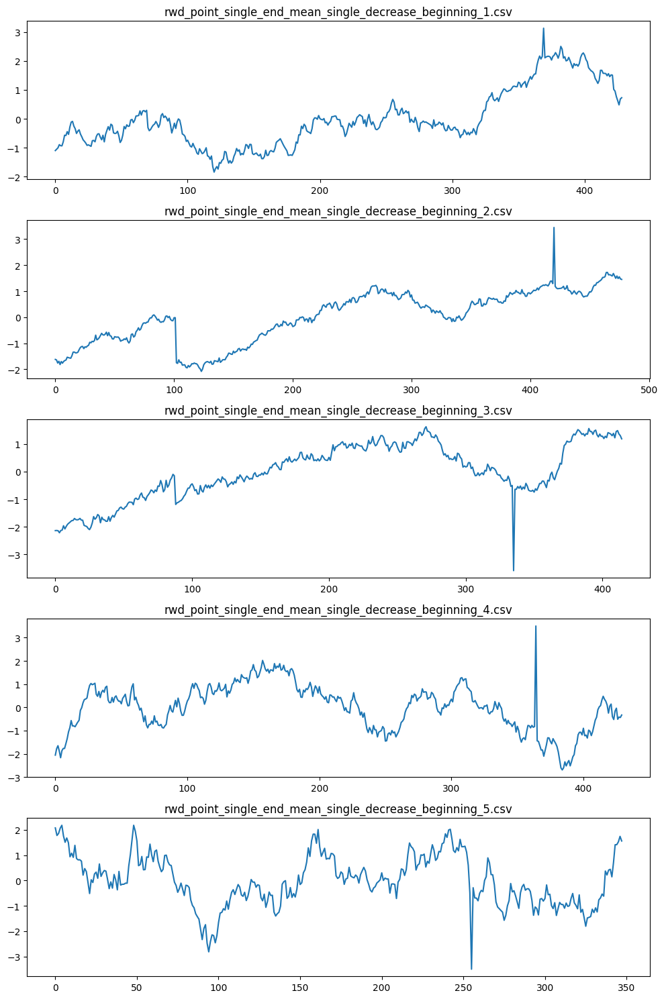

In [ ]:
plot_combinations("rwd_pt_single_end_ms_single_decrease_beginning_medium")

In [ ]:

def parse_indices(value):
    """Boşluk veya virgülle ayrılmış indeksleri listeye çevirir."""
    if pd.isna(value):
        return []
    if isinstance(value, str):
        return [int(x) for x in re.findall(r'\d+', value)]
    elif isinstance(value, int):
        return [value]
    elif isinstance(value, list):
        return value
    return []

def enhanced_plot_point_and_mean_shift(folder, n=5):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()

        ax = plt.subplot(n, 1, i + 1)
        ax.plot(df['data'], color='black')

        # Point Anomaly (kırmızı nokta)
        if 'point_anom_point' in df.columns:
            points = parse_indices(df['point_anom_point'].iloc[0])
            for p in points:
                if 0 <= p < len(df):
                    ax.scatter(p, df['data'].iloc[p], color='red', s=40, marker='o', label='Point Anomaly')

        # Mean Shift (mor bölge)
        if 'mean_shift_point' in df.columns:
            starts = parse_indices(df['mean_shift_point'].iloc[0])
            for j, start in enumerate(starts):
                label = 'Mean Shift' if j == 0 else None
                ax.axvspan(start, len(df), color='purple', alpha=0.2, label=label)

        ax.set_title(fname)
        ax.legend(loc='upper right')

    plt.tight_layout()
    plt.show()

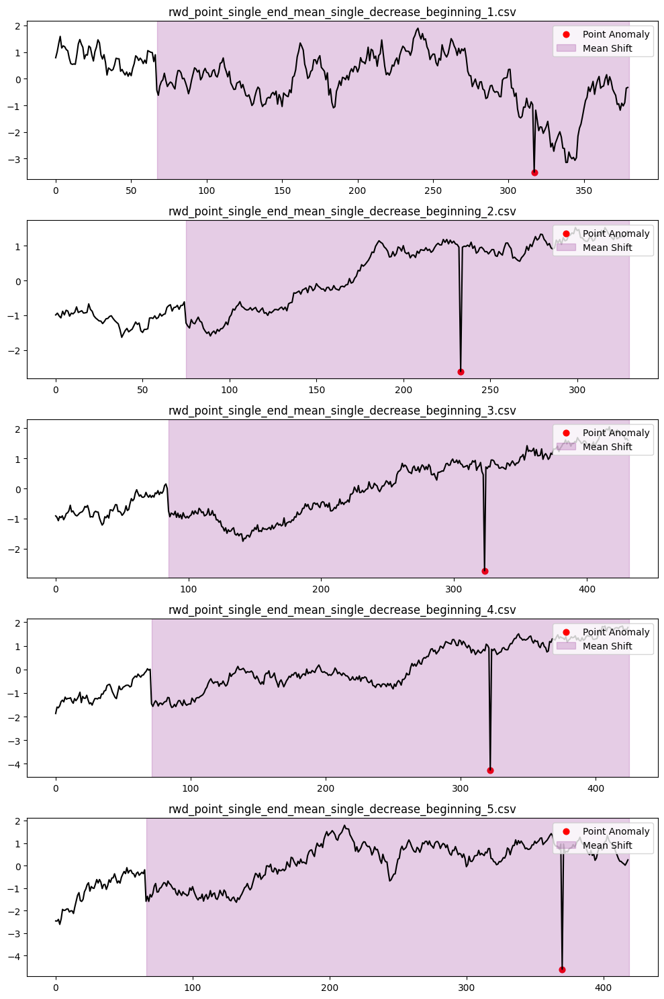

In [ ]:
enhanced_plot_point_and_mean_shift("rwd_pt_single_end_ms_single_decrease_beginning_long")

In [ ]:

folder_rwd_pt_single_end_ms_single_decrease_beginning_medium = "rwd_pt_single_end_ms_single_decrease_beginning_medium"
shutil.make_archive(folder_rwd_pt_single_end_ms_single_decrease_beginning_medium, 'zip', folder_rwd_pt_single_end_ms_single_decrease_beginning_medium)
from google.colab import files
files.download("rwd_pt_single_end_ms_single_decrease_beginning_medium.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Stochastic Trend + Point Anomaly + Variance Shift:

In [ ]:

def generate_stochastic_with_point_and_variance_shift_dataset(
    folder,
    kind='rw',
    count=5,
    length_range=(300, 500),
    point_type='single',
    variance_shift_type='single',
    shift_type='increase',
    location_point="middle",
    location_variance="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    trend_label_map = {
        'rw': 'stochastic_trend_rw',
        'rwd': 'stochastic_trend_rwd',
        'ari': 'stochastic_trend_ari',
        'ima': 'stochastic_trend_ima',
        'arima': 'stochastic_trend_arima'
    }

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_stochastic_trend(kind=kind)
        p, d, q = base_df.attrs.get("pdq", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        # Point anomaly
        if point_type == 'single':
            df = ts.generate_point_anomaly(base_df, location=location_point)
            is_multi_point_anomaly = 0
        elif point_type == 'multiple':
            df = ts.generate_point_anomalies(base_df)
            location_point = 0
            is_multi_point_anomaly = 1
        else:
            raise ValueError("Invalid point_type")

        # Variance shift
        if variance_shift_type == 'single':
            sign = 1 if shift_type == 'increase' else -1
            df = ts.generate_variance_shift(df, signs=[sign], location=location_variance, num_breaks=1)
            is_multi_variance_shift = 0
            shift_type_increase = int(sign == 1)
            shift_type_decrease = int(sign == -1)
            loc_variance = location_variance
        elif variance_shift_type == 'multiple':
            signs = list(np.random.choice([-1, 1], size=2))
            df = ts.generate_variance_shift(df, num_breaks=2, signs=signs)
            is_multi_variance_shift = 1
            shift_type_increase = 0
            shift_type_decrease = 0
            loc_variance = "NA"
        else:
            raise ValueError("Invalid variance_shift_type")

        # Label
        label_parts = [kind, "point", point_type]
        if point_type == 'single':
            label_parts.append(location_point)
        label_parts += ["vs", variance_shift_type]
        if variance_shift_type == 'single':
            label_parts += [shift_type, location_variance]

        label = "_".join(str(p) for p in label_parts)
        filename = f"{label}_{i+1}.csv"
        df["label"] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        # Metadata
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            point_anomaly=1,
            variance_shift=1,
            shift_type_increase=shift_type_increase,
            shift_type_decrease=shift_type_decrease,
            location_point=location_point if point_type == 'single' else 0,
            location_variance_shift=loc_variance,
            is_multi_point_anomaly=is_multi_point_anomaly,
            is_multi_variance_shift=is_multi_variance_shift,
            stoc_params=f"({p},{d},{q})",
            stoc_coef=str(coefs),
            **{trend_label_map[kind]: 1}
        )
        metadata.append(record)

    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "all_series.pkl"), "wb") as f:
        pickle.dump(metadata, f)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")


In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}

locations = ['beginning', 'middle', 'end']
types = ['rw', 'rwd', 'ari', 'ima', 'arima']
point_types = ['single', 'multiple']
shift_types = ['increase', 'decrease']

for kind in types:
    for size_label, length_range in length_ranges.items():
        for point_type in point_types:

            # SINGLE VARIANCE SHIFT
            for shift_type in shift_types:
                if point_type == 'single':
                    for loc_point in locations:
                        for loc_var in locations:
                            folder = f"{kind}_pt_{point_type}_{loc_point}_vs_single_{shift_type}_{loc_var}_{size_label}"
                            generate_stochastic_with_point_and_variance_shift_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                point_type=point_type,
                                variance_shift_type="single",
                                shift_type=shift_type,
                                location_point=loc_point,
                                location_variance=loc_var
                            )
                else:  # point multiple
                    for loc_var in locations:
                        folder = f"{kind}_pt_{point_type}_vs_single_{shift_type}_{loc_var}_{size_label}"
                        generate_stochastic_with_point_and_variance_shift_dataset(
                            folder=folder,
                            kind=kind,
                            count=5,
                            length_range=length_range,
                            point_type=point_type,
                            variance_shift_type="single",
                            shift_type=shift_type,
                            location_variance=loc_var
                        )

            # MULTIPLE VARIANCE SHIFT
            if point_type == 'single':
                for loc_point in locations:
                    folder = f"{kind}_pt_{point_type}_{loc_point}_vs_multiple_{size_label}"
                    generate_stochastic_with_point_and_variance_shift_dataset(
                        folder=folder,
                        kind=kind,
                        count=5,
                        length_range=length_range,
                        point_type=point_type,
                        variance_shift_type="multiple",
                        location_point=loc_point
                    )
            else:
                folder = f"{kind}_pt_{point_type}_vs_multiple_{size_label}"
                generate_stochastic_with_point_and_variance_shift_dataset(
                    folder=folder,
                    kind=kind,
                    count=5,
                    length_range=length_range,
                    point_type=point_type,
                    variance_shift_type="multiple"
                )

5 'rw_point_single_beginning_vs_single_increase_beginning' series saved in 'rw_pt_single_beginning_vs_single_increase_beginning_short' with metadata.
5 'rw_point_single_beginning_vs_single_increase_middle' series saved in 'rw_pt_single_beginning_vs_single_increase_middle_short' with metadata.
5 'rw_point_single_beginning_vs_single_increase_end' series saved in 'rw_pt_single_beginning_vs_single_increase_end_short' with metadata.
5 'rw_point_single_middle_vs_single_increase_beginning' series saved in 'rw_pt_single_middle_vs_single_increase_beginning_short' with metadata.
5 'rw_point_single_middle_vs_single_increase_middle' series saved in 'rw_pt_single_middle_vs_single_increase_middle_short' with metadata.
5 'rw_point_single_middle_vs_single_increase_end' series saved in 'rw_pt_single_middle_vs_single_increase_end_short' with metadata.
5 'rw_point_single_end_vs_single_increase_beginning' series saved in 'rw_pt_single_end_vs_single_increase_beginning_short' with metadata.
5 'rw_point_sing

In [ ]:
generate_stochastic_with_point_and_variance_shift_dataset(
    folder="ari_pt_single_middle_vs_single_decrease_middle_medium",
    kind="ari",
    count=5,
    length_range=(300, 500),
    point_type="single",
    variance_shift_type="single",
    shift_type="decrease",
    location_point="middle",
    location_variance="middle"
)


5 'ari_point_single_middle_vs_single_decrease_middle' series saved in 'ari_pt_single_middle_vs_single_decrease_middle_medium' with metadata.


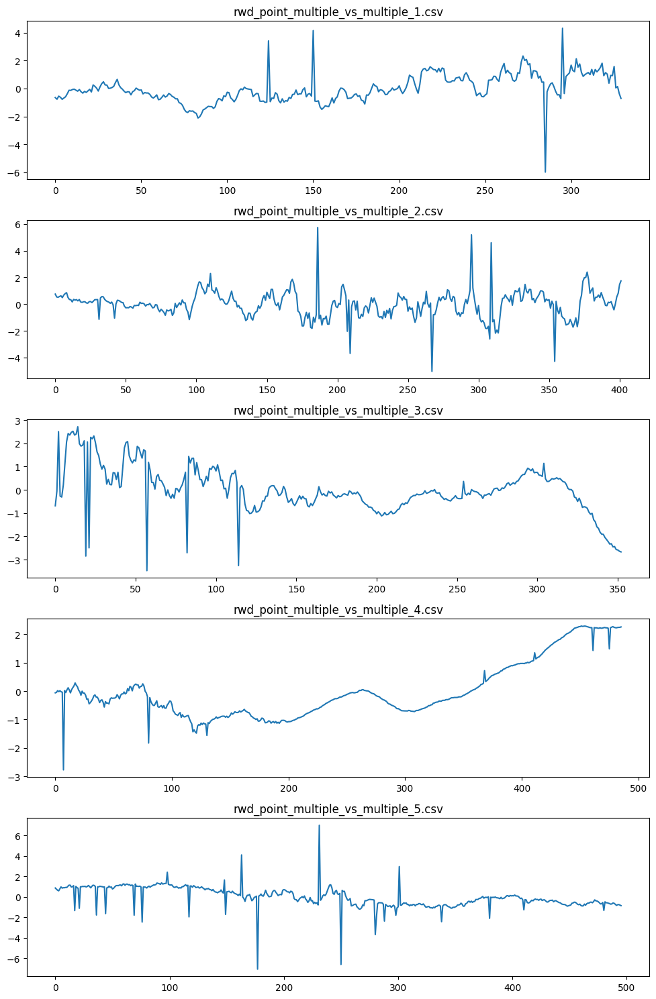

In [ ]:
plot_combinations("rwd_pt_multiple_vs_multiple_medium")

In [ ]:

def parse_indices(value, mode="default"):
    if pd.isna(value):
        return []
    if isinstance(value, str):
        try:
            if mode == "variance":
                # np.int64(120) gibi ifadeleri 120 yap
                value = re.sub(r'np\.int64\((\d+)\)', r'\1', value)
            elif mode == "point":
                # [ 50 170 189] -> [50, 170, 189]
                value = value.replace('[', '').replace(']', '').split()
                return [int(x) for x in value]
            return list(map(int, ast.literal_eval(value)))
        except:
            return []
    elif isinstance(value, list):
        return [int(v) for v in value]
    return []

def enhanced_plot_point_and_variance_shift(folder, n=5):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()

        ax = plt.subplot(n, 1, i + 1)
        ax.plot(df['data'])

        # Point Anomaly
        if 'point_anom_location' in df.columns:
            points = parse_indices(df['point_anom_location'].iloc[0], mode="point")
            for j, p in enumerate(points):
                if 0 <= p < len(df):
                    ax.scatter(p, df['data'].iloc[p], color='red', s=40, marker='o', label='Point Anomaly' if j == 0 else None)

        # Variance Shift (yeşil kesikli çizgi)
        if 'variance_shift_points' in df.columns:
            shifts = parse_indices(df['variance_shift_points'].iloc[0], mode="variance")
            for j, s in enumerate(shifts):
                if 0 <= s < len(df):
                    ax.axvline(s, linestyle='--', color='green', linewidth=2, label='Variance Shift' if j == 0 else None)

        ax.set_title(fname)
        ax.legend(loc='upper right')

    plt.tight_layout()
    plt.show()




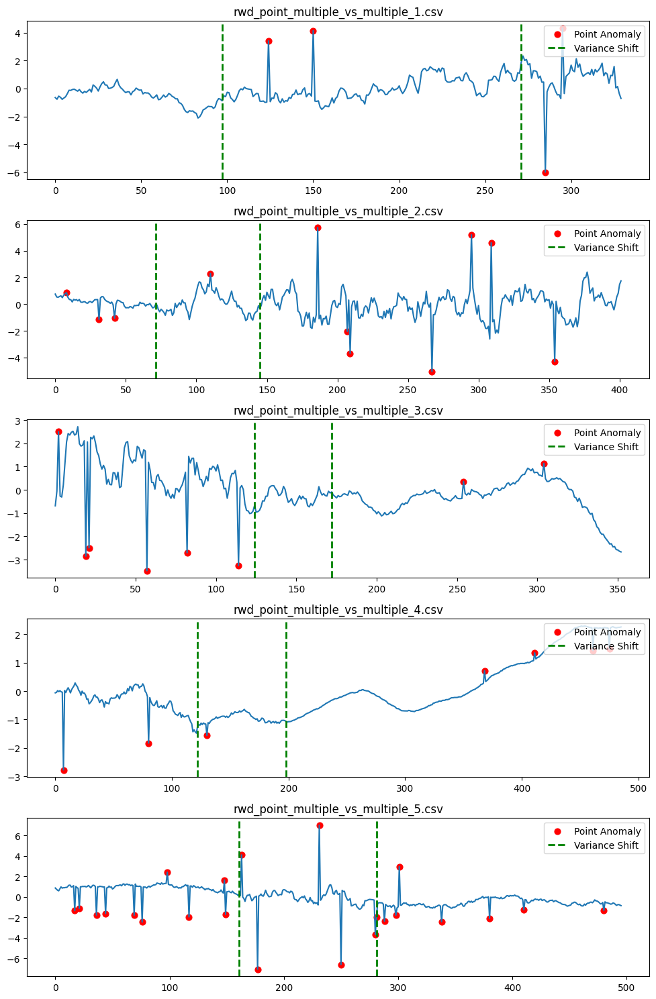

In [ ]:
enhanced_plot_point_and_variance_shift("rwd_pt_multiple_vs_multiple_medium")


In [ ]:
import shutil
folder_rwd_pt_multiple_vs_multiple_medium = "rwd_pt_multiple_vs_multiple_medium"
shutil.make_archive(folder_rwd_pt_multiple_vs_multiple_medium, 'zip', folder_rwd_pt_multiple_vs_multiple_medium)
from google.colab import files
files.download("rwd_pt_multiple_vs_multiple_medium.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Stochastic Trend + Collective Anomaly + Mean Shift:

In [ ]:
def generate_stochastic_with_collective_and_mean_shift_dataset(
    folder,
    kind='rw',
    count=5,
    length_range=(300, 500),
    collective_type='single',
    mean_shift_type='single',
    location_collective="middle",
    location_mean="middle",
    shift_type="increase"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    trend_label_map = {
        'rw': 'stochastic_trend_rw',
        'rwd': 'stochastic_trend_rwd',
        'ari': 'stochastic_trend_ari',
        'ima': 'stochastic_trend_ima',
        'arima': 'stochastic_trend_arima'
    }

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_stochastic_trend(kind=kind)
        p, d, q = base_df.attrs.get("pdq", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        # Collective anomaly
        if collective_type == 'single':
            df = ts.generate_collective_anomalies(base_df, num_anomalies=1, location=location_collective)
            is_multi_collective_anomaly = 0
            loc_collective = location_collective
        elif collective_type == 'multiple':
            df = ts.generate_collective_anomalies(base_df, num_anomalies=np.random.randint(2, 5))
            is_multi_collective_anomaly = 1
            loc_collective = 0
        else:
            raise ValueError("Invalid collective_type")

        # Mean shift
        if mean_shift_type == 'single':
            sign = 1 if shift_type == 'increase' else -1
            df, _ = ts.generate_mean_shift(df, signs=[sign], location=location_mean, num_breaks=1, return_debug=True)
            is_multi_mean_shift = 0
            shift_type_increase = 1 if shift_type == "increase" else 0
            shift_type_decrease = 1 if shift_type == "decrease" else 0
            loc_mean = location_mean
        elif mean_shift_type == 'multiple':
            num_breaks = np.random.randint(2, 4)
            signs = list(np.random.choice([-1, 1], size=num_breaks))
            df, _ = ts.generate_mean_shift(df, num_breaks=num_breaks, signs=signs, return_debug=True)
            is_multi_mean_shift = 1
            shift_type_increase = 0
            shift_type_decrease = 0
            loc_mean = 0
        else:
            raise ValueError("Invalid mean_shift_type")

        # Label
        label_parts = [kind, "collective", collective_type]
        if collective_type == 'single':
            label_parts.append(location_collective)
        label_parts += ["mean", mean_shift_type]
        if mean_shift_type == 'single':
            label_parts += [shift_type, location_mean]

        label = "_".join(str(p) for p in label_parts)
        filename = f"{label}_{i+1}.csv"
        df["label"] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        # Metadata
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            collective_anomaly=1,
            mean_shift=1,
            shift_type_increase=shift_type_increase,
            shift_type_decrease=shift_type_decrease,
            location_collective=loc_collective if collective_type == 'single' else 0,
            location_mean_shift=loc_mean,
            is_multi_collective_anomaly=is_multi_collective_anomaly,
            is_multi_mean_shift=is_multi_mean_shift,
            stoc_params=f"({p},{d},{q})",
            stoc_coef=str(coefs),
            **{trend_label_map[kind]: 1}
        )
        metadata.append(record)

    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "all_series.pkl"), "wb") as f:
        pickle.dump(metadata, f)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")

In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
types = ['rw', 'rwd', 'ari', 'ima', 'arima']
collective_types = ['single', 'multiple']
shift_types = ['increase', 'decrease']

for kind in types:
    for size_label, length_range in length_ranges.items():
        for collective_type in collective_types:

            # SINGLE MEAN SHIFT
            for shift_type in shift_types:
                if collective_type == 'single':
                    for loc_collective in locations:
                        for loc_mean in locations:
                            folder = f"{kind}_ct_{collective_type}_{loc_collective}_ms_single_{shift_type}_{loc_mean}_{size_label}"
                            generate_stochastic_with_collective_and_mean_shift_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                collective_type=collective_type,
                                mean_shift_type="single",
                                shift_type=shift_type,
                                location_collective=loc_collective,
                                location_mean=loc_mean
                            )
                else:
                    for loc_mean in locations:
                        folder = f"{kind}_ct_{collective_type}_ms_single_{shift_type}_{loc_mean}_{size_label}"
                        generate_stochastic_with_collective_and_mean_shift_dataset(
                            folder=folder,
                            kind=kind,
                            count=5,
                            length_range=length_range,
                            collective_type=collective_type,
                            mean_shift_type="single",
                            shift_type=shift_type,
                            location_mean=loc_mean
                        )

            # MULTIPLE MEAN SHIFT
            if collective_type == 'single':
                for loc_collective in locations:
                    folder = f"{kind}_ct_{collective_type}_{loc_collective}_ms_multiple_{size_label}"
                    generate_stochastic_with_collective_and_mean_shift_dataset(
                        folder=folder,
                        kind=kind,
                        count=5,
                        length_range=length_range,
                        collective_type=collective_type,
                        mean_shift_type="multiple",
                        location_collective=loc_collective
                    )
            else:
                folder = f"{kind}_ct_{collective_type}_ms_multiple_{size_label}"
                generate_stochastic_with_collective_and_mean_shift_dataset(
                    folder=folder,
                    kind=kind,
                    count=5,
                    length_range=length_range,
                    collective_type=collective_type,
                    mean_shift_type="multiple"
                )


5 'rw_collective_single_beginning_mean_single_increase_beginning' series saved in 'rw_ct_single_beginning_ms_single_increase_beginning_short' with metadata.
5 'rw_collective_single_beginning_mean_single_increase_middle' series saved in 'rw_ct_single_beginning_ms_single_increase_middle_short' with metadata.
5 'rw_collective_single_beginning_mean_single_increase_end' series saved in 'rw_ct_single_beginning_ms_single_increase_end_short' with metadata.
5 'rw_collective_single_middle_mean_single_increase_beginning' series saved in 'rw_ct_single_middle_ms_single_increase_beginning_short' with metadata.
5 'rw_collective_single_middle_mean_single_increase_middle' series saved in 'rw_ct_single_middle_ms_single_increase_middle_short' with metadata.
5 'rw_collective_single_middle_mean_single_increase_end' series saved in 'rw_ct_single_middle_ms_single_increase_end_short' with metadata.
5 'rw_collective_single_end_mean_single_increase_beginning' series saved in 'rw_ct_single_end_ms_single_increase

In [ ]:
generate_stochastic_with_collective_and_mean_shift_dataset(
    folder="rw_ct_multiple_ms_single_decrease_end_medium",
    kind="rw",
    count=5,
    length_range=(300, 500),
    collective_type="multiple",
    mean_shift_type="single",
    shift_type="decrease",
    location_mean="end"
)

5 'rw_collective_multiple_mean_single_decrease_end' series saved in 'rw_ct_multiple_ms_single_decrease_end_medium' with metadata.


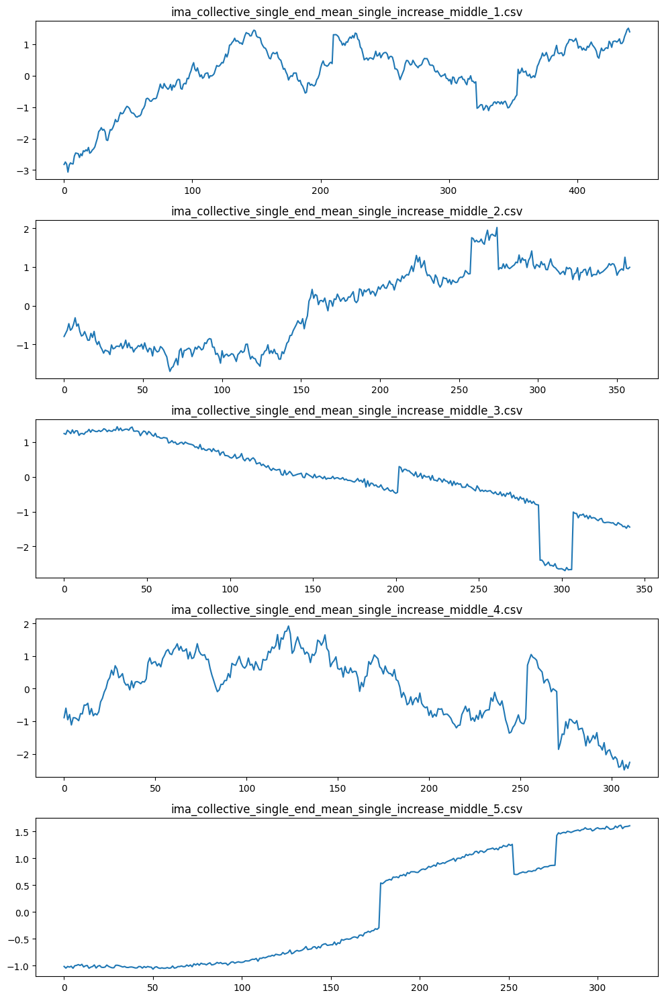

In [ ]:
plot_combinations("ima_ct_single_end_ms_single_increase_middle_medium")

In [ ]:
import shutil
folder_ima_ct_single_end_ms_single_increase_middle_medium = "ima_ct_single_end_ms_single_increase_middle_medium"
shutil.make_archive(folder_ima_ct_single_end_ms_single_increase_middle_medium, 'zip', folder_ima_ct_single_end_ms_single_increase_middle_medium)
from google.colab import files
files.download("ima_ct_single_end_ms_single_increase_middle_medium.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:

def parse_indices(value, mode="default"):
    if pd.isna(value):
        return []

    if isinstance(value, str):
        try:
            # np.int64(120) gibi şeyler
            if mode in ["variance", "mean_shift", "collective"]:
                value = re.sub(r'np\.int64\((\d+)\)', r'\1', value)
            if mode == "point":
                value = value.replace('[', '').replace(']', '').split()
                return [int(x) for x in value]

            return list(map(int, ast.literal_eval(value)))
        except:
            return [int(x) for x in re.findall(r'\d+', value) if len(x) <= 5]

    elif isinstance(value, list):
        return [int(v) for v in value]

    elif isinstance(value, int):
        return [value]
    return []

def enhanced_plot_collective_and_mean_shift(folder, n=5):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()

        ax = plt.subplot(n, 1, i + 1)
        ax.plot(df['data'])

        # Collective Anomaly (turuncu bölge)
        if 'collect_anom_start' in df.columns and 'collect_anom_end' in df.columns:
            starts = parse_indices(df['collect_anom_start'].iloc[0])
            ends = parse_indices(df['collect_anom_end'].iloc[0])
            for j, (s, e) in enumerate(zip(starts, ends)):
                if 0 <= s < len(df) and 0 < e <= len(df):
                    ax.axvspan(s, e, color='orange', alpha=0.3, label='Collective Anomaly' if j == 0 else None)

        # Mean Shift (mor kesikli çizgi)
        if 'mean_shift_point' in df.columns:
            shifts = parse_indices(df['mean_shift_point'].iloc[0], mode="variance")
            for j, s in enumerate(shifts):
                if 0 <= s < len(df):
                    ax.axvline(s, linestyle='--', color='purple', linewidth=2, label='Mean Shift' if j == 0 else None)

        ax.set_title(fname)
        ax.legend(loc='upper right')

    plt.tight_layout()
    plt.show()

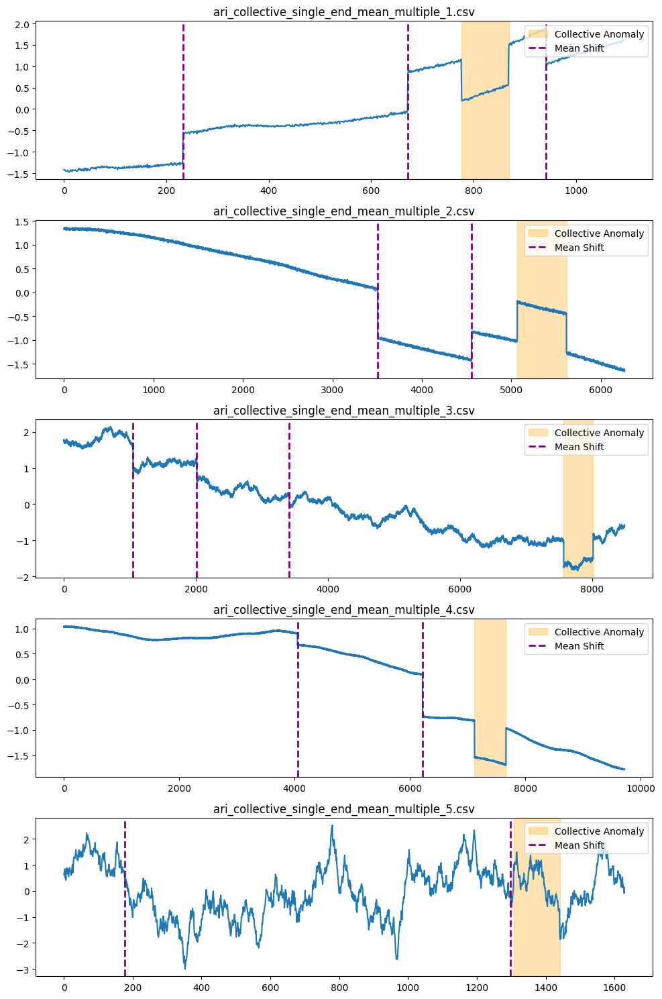

In [ ]:
enhanced_plot_collective_and_mean_shift("ari_ct_single_end_ms_multiple_long")


In [ ]:
import shutil
folder_ari_ct_single_end_ms_multiple_long = "ari_ct_single_end_ms_multiple_long"
shutil.make_archive(folder_ari_ct_single_end_ms_multiple_long, 'zip', folder_ari_ct_single_end_ms_multiple_long)
from google.colab import files
files.download("ari_ct_single_end_ms_multiple_long.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Stochastic Trend + Collective Anomaly + Variance Shift:

In [ ]:
def generate_stochastic_with_collective_and_variance_shift_dataset(
    folder,
    kind='rw',
    count=5,
    length_range=(300, 500),
    collective_type='single',
    variance_shift_type='single',
    shift_type='increase',
    location_collective="middle",
    location_variance="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    trend_label_map = {
        'rw': 'stochastic_trend_rw',
        'rwd': 'stochastic_trend_rwd',
        'ari': 'stochastic_trend_ari',
        'ima': 'stochastic_trend_ima',
        'arima': 'stochastic_trend_arima'
    }

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_stochastic_trend(kind=kind)
        p, d, q = base_df.attrs.get("pdq", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        # Collective anomaly
        if collective_type == 'single':
            df = ts.generate_collective_anomalies(base_df, num_anomalies=1, location=location_collective)
            is_multi_collective_anomaly = 0
            loc_collective = location_collective
        elif collective_type == 'multiple':
            df = ts.generate_collective_anomalies(base_df, num_anomalies=np.random.randint(2, 5))
            is_multi_collective_anomaly = 1
            loc_collective = 0
        else:
            raise ValueError("Invalid collective_type")

        # Variance shift
        if variance_shift_type == 'single':
            sign = 1 if shift_type == 'increase' else -1
            df = ts.generate_variance_shift(df, signs=[sign], location=location_variance, num_breaks=1)
            is_multi_variance_shift = 0
            shift_type_increase = int(sign == 1)
            shift_type_decrease = int(sign == -1)
            loc_variance = location_variance
        elif variance_shift_type == 'multiple':
            signs = list(np.random.choice([-1, 1], size=2))
            df = ts.generate_variance_shift(df, num_breaks=2, signs=signs)
            is_multi_variance_shift = 1
            shift_type_increase = 0
            shift_type_decrease = 0
            loc_variance = "NA"
        else:
            raise ValueError("Invalid variance_shift_type")

        # Label
        label_parts = [kind, "collective", collective_type]
        if collective_type == 'single':
            label_parts.append(location_collective)
        label_parts += ["vs", variance_shift_type]
        if variance_shift_type == 'single':
            label_parts += [shift_type, location_variance]

        label = "_".join(str(p) for p in label_parts)
        filename = f"{label}_{i+1}.csv"
        df["label"] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        # Metadata
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            collective_anomaly=1,
            variance_shift=1,
            shift_type_increase=shift_type_increase,
            shift_type_decrease=shift_type_decrease,
            location_collective=loc_collective if collective_type == 'single' else 0,
            location_variance_shift=loc_variance,
            is_multi_collective_anomaly=is_multi_collective_anomaly,
            is_multi_variance_shift=is_multi_variance_shift,
            stoc_params=f"({p},{d},{q})",
            stoc_coef=str(coefs),
            **{trend_label_map[kind]: 1}
        )
        metadata.append(record)

    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "all_series.pkl"), "wb") as f:
        pickle.dump(metadata, f)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")


In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
types = ['rw', 'rwd', 'ari', 'ima', 'arima']
collective_types = ['single', 'multiple']
shift_types = ['increase', 'decrease']

for kind in types:
    for size_label, length_range in length_ranges.items():
        for collective_type in collective_types:

            # SINGLE VARIANCE SHIFT
            for shift_type in shift_types:
                if collective_type == 'single':
                    for loc_collective in locations:
                        for loc_var in locations:
                            folder = f"{kind}_ct_{collective_type}_{loc_collective}_vs_single_{shift_type}_{loc_var}_{size_label}"
                            generate_stochastic_with_collective_and_variance_shift_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                collective_type=collective_type,
                                variance_shift_type="single",
                                shift_type=shift_type,
                                location_collective=loc_collective,
                                location_variance=loc_var
                            )
                else:
                    for loc_var in locations:
                        folder = f"{kind}_ct_{collective_type}_vs_single_{shift_type}_{loc_var}_{size_label}"
                        generate_stochastic_with_collective_and_variance_shift_dataset(
                            folder=folder,
                            kind=kind,
                            count=5,
                            length_range=length_range,
                            collective_type=collective_type,
                            variance_shift_type="single",
                            shift_type=shift_type,
                            location_variance=loc_var
                        )

            # MULTIPLE VARIANCE SHIFT
            if collective_type == 'single':
                for loc_collective in locations:
                    folder = f"{kind}_ct_{collective_type}_{loc_collective}_vs_multiple_{size_label}"
                    generate_stochastic_with_collective_and_variance_shift_dataset(
                        folder=folder,
                        kind=kind,
                        count=5,
                        length_range=length_range,
                        collective_type=collective_type,
                        variance_shift_type="multiple",
                        location_collective=loc_collective
                    )
            else:
                folder = f"{kind}_ct_{collective_type}_vs_multiple_{size_label}"
                generate_stochastic_with_collective_and_variance_shift_dataset(
                    folder=folder,
                    kind=kind,
                    count=5,
                    length_range=length_range,
                    collective_type=collective_type,
                    variance_shift_type="multiple"
                )


5 'rw_collective_single_beginning_vs_single_increase_beginning' series saved in 'rw_ct_single_beginning_vs_single_increase_beginning_short' with metadata.
5 'rw_collective_single_beginning_vs_single_increase_middle' series saved in 'rw_ct_single_beginning_vs_single_increase_middle_short' with metadata.
5 'rw_collective_single_beginning_vs_single_increase_end' series saved in 'rw_ct_single_beginning_vs_single_increase_end_short' with metadata.
5 'rw_collective_single_middle_vs_single_increase_beginning' series saved in 'rw_ct_single_middle_vs_single_increase_beginning_short' with metadata.
5 'rw_collective_single_middle_vs_single_increase_middle' series saved in 'rw_ct_single_middle_vs_single_increase_middle_short' with metadata.
5 'rw_collective_single_middle_vs_single_increase_end' series saved in 'rw_ct_single_middle_vs_single_increase_end_short' with metadata.
5 'rw_collective_single_end_vs_single_increase_beginning' series saved in 'rw_ct_single_end_vs_single_increase_beginning_sho

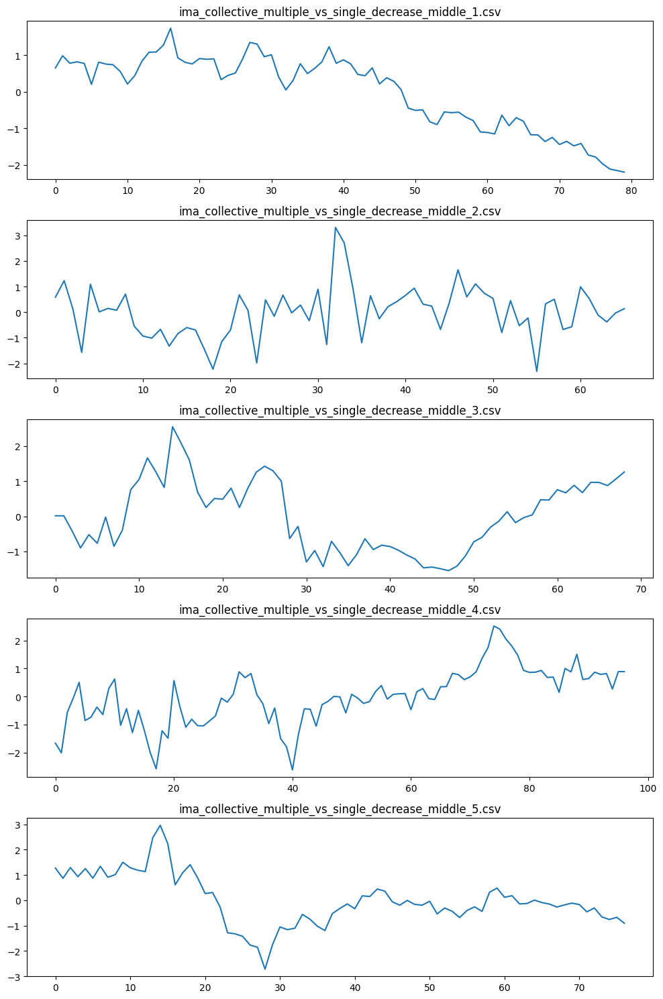

In [ ]:
plot_combinations("ima_ct_multiple_vs_single_decrease_middle_short")

In [ ]:
import re
def parse_indices(value, mode="default"):
    if pd.isna(value):
        return []

    if isinstance(value, str):
        try:
            if mode in ["variance", "mean_shift", "collective"]:
                value = re.sub(r'np\.int64\((\d+)\)', r'\1', value)
            if mode == "point":
                value = value.replace('[', '').replace(']', '').split()
                return [int(x) for x in value]
            return list(map(int, ast.literal_eval(value)))
        except:
            return [int(x) for x in re.findall(r'\d+', value) if len(x) <= 5]
    elif isinstance(value, list):
        return [int(v) for v in value]

    elif isinstance(value, int):
        return [value]
    return []

def enhanced_plot_collective_and_variance_shift(folder, n=5):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()

        ax = plt.subplot(n, 1, i + 1)
        ax.plot(df['data'])

        # Collective Anomaly (turuncu bölge)
        if 'collect_anom_start' in df.columns and 'collect_anom_end' in df.columns:
            starts = parse_indices(df['collect_anom_start'].iloc[0], mode="collective")
            ends = parse_indices(df['collect_anom_end'].iloc[0], mode="collective")
            for j, (s, e) in enumerate(zip(starts, ends)):
                if 0 <= s < len(df) and 0 < e <= len(df):
                    ax.axvspan(s, e, color='orange', alpha=0.3, label='Collective Anomaly' if j == 0 else None)

        # Variance Shift (yeşil kesikli çizgi)
        if 'variance_shift_points' in df.columns:
            shifts = parse_indices(df['variance_shift_points'].iloc[0], mode="variance")
            for j, s in enumerate(shifts):
                if 0 <= s < len(df):
                    ax.axvline(s, linestyle='--', color='green', linewidth=2, label='Variance Shift' if j == 0 else None)

        ax.set_title(fname)
        ax.legend(loc='upper right')

    plt.tight_layout()
    plt.show()

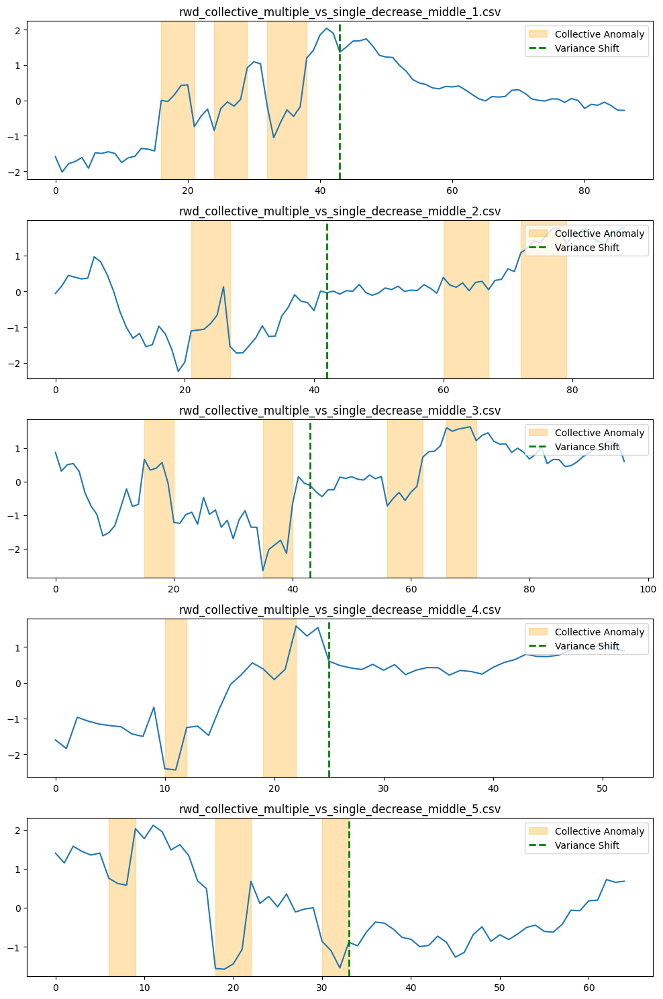

In [ ]:
enhanced_plot_collective_and_variance_shift("rwd_ct_multiple_vs_single_decrease_middle_short")

### Stochastic Trend + Mean Shift + Variance Shift:

In [ ]:
def generate_stochastic_with_mean_and_variance_shift_dataset(
    folder,
    kind='rw',
    count=5,
    length_range=(300, 500),
    mean_shift_type='single',
    variance_shift_type='single',
    shift_type_mean='increase',
    shift_type_variance='increase',
    location_mean="middle",
    location_variance="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    trend_label_map = {
        'rw': 'stochastic_trend_rw',
        'rwd': 'stochastic_trend_rwd',
        'ari': 'stochastic_trend_ari',
        'ima': 'stochastic_trend_ima',
        'arima': 'stochastic_trend_arima'
    }

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_stochastic_trend(kind=kind)
        p, d, q = base_df.attrs.get("pdq", (0, 0, 0))
        coefs = base_df.attrs.get("coefs", [])

        df = base_df

        # Mean shift
        if mean_shift_type == 'single':
            sign_mean = 1 if shift_type_mean == 'increase' else -1
            df, _ = ts.generate_mean_shift(df, signs=[sign_mean], location=location_mean, num_breaks=1, return_debug=True)
            is_multi_mean_shift = 0
            shift_type_increase = int(sign_mean == 1)
            shift_type_decrease = int(sign_mean == -1)
            loc_mean = location_mean
        elif mean_shift_type == 'multiple':
            num_breaks = np.random.randint(2, 4)
            signs = list(np.random.choice([-1, 1], size=num_breaks))
            df, _ = ts.generate_mean_shift(df, num_breaks=num_breaks, signs=signs, return_debug=True)
            is_multi_mean_shift = 1
            shift_type_increase = 0
            shift_type_decrease = 0
            loc_mean = 0
        else:
            raise ValueError("Invalid mean_shift_type")

        # Variance shift
        if variance_shift_type == 'single':
            sign_var = 1 if shift_type_variance == 'increase' else -1
            df = ts.generate_variance_shift(df, signs=[sign_var], location=location_variance, num_breaks=1)
            is_multi_variance_shift = 0
            loc_variance = location_variance
        elif variance_shift_type == 'multiple':
            signs = list(np.random.choice([-1, 1], size=2))
            df = ts.generate_variance_shift(df, num_breaks=2, signs=signs)
            is_multi_variance_shift = 1
            loc_variance = 0
        else:
            raise ValueError("Invalid variance_shift_type")

        # Label oluştur
        label_parts = [kind, "ms", mean_shift_type]
        if mean_shift_type == 'single':
            label_parts += [shift_type_mean, location_mean]
        label_parts += ["vs", variance_shift_type]
        if variance_shift_type == 'single':
            label_parts += [shift_type_variance, location_variance]

        label = "_".join(str(p) for p in label_parts)
        filename = f"{label}_{i+1}.csv"
        df["label"] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        # Metadata
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            mean_shift=1,
            variance_shift=1,
            shift_type_increase=shift_type_increase,
            shift_type_decrease=shift_type_decrease,
            location_mean_shift=loc_mean,
            location_variance_shift=loc_variance,
            is_multi_mean_shift=is_multi_mean_shift,
            is_multi_variance_shift=is_multi_variance_shift,
            stoc_params=f"({p},{d},{q})",
            stoc_coef=str(coefs),
            **{trend_label_map[kind]: 1}
        )
        metadata.append(record)

    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "all_series.pkl"), "wb") as f:
        pickle.dump(metadata, f)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")



In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
types = ['rw', 'rwd', 'ari', 'ima', 'arima']
shift_types = ['increase', 'decrease']

for kind in types:
    for size_label, length_range in length_ranges.items():
        for mean_shift_type in ['single', 'multiple']:
            for variance_shift_type in ['single', 'multiple']:

                # Durum: her ikisi de tekil
                if mean_shift_type == 'single' and variance_shift_type == 'single':
                    for shift_type_mean in shift_types:
                        for shift_type_var in shift_types:
                            for loc_mean in locations:
                                for loc_var in locations:
                                    folder = f"{kind}_ms_single_{shift_type_mean}_{loc_mean}_vs_single_{shift_type_var}_{loc_var}_{size_label}"
                                    generate_stochastic_with_mean_and_variance_shift_dataset(
                                        folder=folder,
                                        kind=kind,
                                        count=5,
                                        length_range=length_range,
                                        mean_shift_type="single",
                                        variance_shift_type="single",
                                        shift_type_mean=shift_type_mean,
                                        shift_type_variance=shift_type_var,
                                        location_mean=loc_mean,
                                        location_variance=loc_var
                                    )

                elif mean_shift_type == 'multiple' and variance_shift_type == 'single':
                    for shift_type_var in shift_types:
                        for loc_var in locations:
                            folder = f"{kind}_ms_multiple_vs_single_{shift_type_var}_{loc_var}_{size_label}"
                            generate_stochastic_with_mean_and_variance_shift_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                mean_shift_type="multiple",
                                variance_shift_type="single",
                                shift_type_variance=shift_type_var,
                                location_variance=loc_var
                            )

                elif mean_shift_type == 'single' and variance_shift_type == 'multiple':
                    for shift_type_mean in shift_types:
                        for loc_mean in locations:
                            folder = f"{kind}_ms_single_{shift_type_mean}_{loc_mean}_vs_multiple_{size_label}"
                            generate_stochastic_with_mean_and_variance_shift_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                mean_shift_type="single",
                                variance_shift_type="multiple",
                                shift_type_mean=shift_type_mean,
                                location_mean=loc_mean
                            )


                else:
                    folder = f"{kind}_ms_multiple_vs_multiple_{size_label}"
                    generate_stochastic_with_mean_and_variance_shift_dataset(
                        folder=folder,
                        kind=kind,
                        count=5,
                        length_range=length_range,
                        mean_shift_type="multiple",
                        variance_shift_type="multiple"
                    )


5 'rw_ms_single_increase_beginning_vs_single_increase_beginning' series saved in 'rw_ms_single_increase_beginning_vs_single_increase_beginning_short' with metadata.
5 'rw_ms_single_increase_beginning_vs_single_increase_middle' series saved in 'rw_ms_single_increase_beginning_vs_single_increase_middle_short' with metadata.
5 'rw_ms_single_increase_beginning_vs_single_increase_end' series saved in 'rw_ms_single_increase_beginning_vs_single_increase_end_short' with metadata.
5 'rw_ms_single_increase_middle_vs_single_increase_beginning' series saved in 'rw_ms_single_increase_middle_vs_single_increase_beginning_short' with metadata.
5 'rw_ms_single_increase_middle_vs_single_increase_middle' series saved in 'rw_ms_single_increase_middle_vs_single_increase_middle_short' with metadata.
5 'rw_ms_single_increase_middle_vs_single_increase_end' series saved in 'rw_ms_single_increase_middle_vs_single_increase_end_short' with metadata.
5 'rw_ms_single_increase_end_vs_single_increase_beginning' serie

In [ ]:

folder_ari_ms_single_increase_beginning_vs_single_decrease_middle_medium = "ari_ms_single_increase_beginning_vs_single_decrease_middle_medium"
shutil.make_archive(folder_ari_ms_single_increase_beginning_vs_single_decrease_middle_medium, 'zip', folder_ari_ms_single_increase_beginning_vs_single_decrease_middle_medium)
from google.colab import files
files.download("ari_ms_single_increase_beginning_vs_single_decrease_middle_medium.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import os
import ast
import re
import pandas as pd
import matplotlib.pyplot as plt

def parse_indices(value, mode="default"):
    if pd.isna(value):
        return []

    if isinstance(value, str):
        try:
            if mode in ["variance", "mean_shift"]:
                # np.int64(120) → 120
                value = re.sub(r'np\.int64\((\d+)\)', r'\1', value)
            return list(map(int, ast.literal_eval(value)))
        except:
            return [int(x) for x in re.findall(r'\d+', value) if len(x) <= 5]

    elif isinstance(value, list):
        return [int(v) for v in value]

    elif isinstance(value, int):
        return [value]

    return []

def enhanced_plot_mean_and_variance_shift(folder, n=5):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()

        ax = plt.subplot(n, 1, i + 1)
        ax.plot(df['data'], color='black', label='Data')

        # Mean Shift (mor kesikli çizgi)
        if 'mean_shift_point' in df.columns:
            shifts = parse_indices(df['mean_shift_point'].iloc[0], mode="mean_shift")
            for j, s in enumerate(shifts):
                if 0 <= s < len(df):
                    ax.axvline(s, linestyle='--', color='purple', linewidth=2, label='Mean Shift' if j == 0 else None)

        # Variance Shift (yeşil kesikli çizgi)
        if 'variance_shift_points' in df.columns:
            shifts = parse_indices(df['variance_shift_points'].iloc[0], mode="variance")
            for j, s in enumerate(shifts):
                if 0 <= s < len(df):
                    ax.axvline(s, linestyle='--', color='green', linewidth=2, label='Variance Shift' if j == 0 else None)

        ax.set_title(fname)
        ax.legend(loc='upper right')

    plt.tight_layout()
    plt.show()

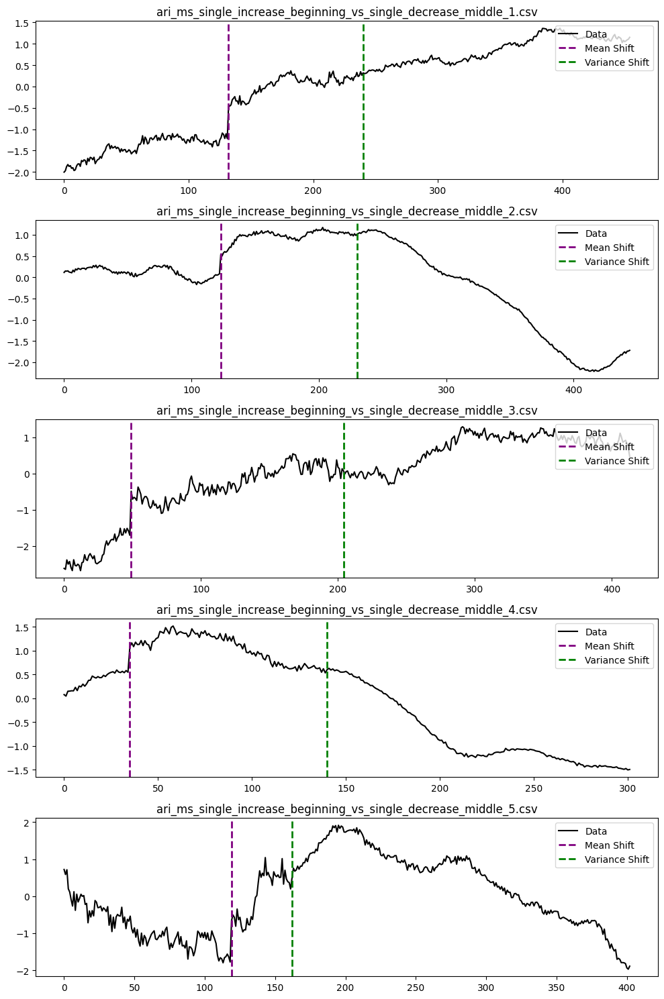

In [ ]:
enhanced_plot_mean_and_variance_shift("ari_ms_single_increase_beginning_vs_single_decrease_middle_medium")

### Volatility + Point Anomaly + Collective Anomaly:

In [ ]:
import os
import numpy as np
import pandas as pd
import pickle

def generate_volatility_with_point_and_collective_anomalies_dataset(
    folder,
    kind='arch',
    count=5,
    length_range=(300, 500),
    point_type='single',
    collective_type='single',
    location_point="middle",
    location_collective="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    vol_label_map = {
        'arch': 'volatility_arch',
        'garch': 'volatility_garch',
        'egarch': 'volatility_egarch',
        'aparch': 'volatility_aparch'
    }

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)

        # base volatility series
        base_df = ts.generate_volatility(kind=kind)
        vol_params = base_df.attrs.get("vol_params", {})

        # point anomaly
        if point_type == 'single':
            loc_point = location_point if location_point else np.random.choice(['beginning', 'middle', 'end'])
            df = ts.generate_point_anomaly(base_df, location=loc_point)
            is_multi_point_anomaly = 0
        elif point_type == 'multiple':
            df = ts.generate_point_anomalies(base_df)
            loc_point = 0
            is_multi_point_anomaly = 1
        else:
            raise ValueError("Invalid point_type")

        # collective anomaly
        if collective_type == 'single':
            loc_collective = location_collective if location_collective else np.random.choice(['beginning', 'middle', 'end'])
            df = ts.generate_collective_anomalies(df, num_anomalies=1, location=loc_collective)
            is_multi_collective_anomaly = 0
        elif collective_type == 'multiple':
            df = ts.generate_collective_anomalies(df, num_anomalies=np.random.randint(2, 5))
            loc_collective = 0
            is_multi_collective_anomaly = 1
        else:
            raise ValueError("Invalid collective_type")

        label_parts = [kind, "point", point_type]
        if point_type == 'single':
            label_parts.append(loc_point)
        label_parts += ["collective", collective_type]
        if collective_type == 'single':
            label_parts.append(loc_collective)

        label = "_".join(str(p) for p in label_parts if p is not None)
        filename = f"{label}_{i+1}.csv"

        df['label'] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            point_anomaly=1,
            collective_anomaly=1,
            location_point=loc_point if point_type == 'single' else 0,
            location_collective=loc_collective if collective_type == 'single' else 0,
            is_multi_point_anomaly=is_multi_point_anomaly,
            is_multi_collective_anomaly=is_multi_collective_anomaly,
            volatility_arch=1 if kind == 'arch' else 0,
            volatility_garch=1 if kind == 'garch' else 0,
            volatility_egarch=1 if kind == 'egarch' else 0,
            volatility_aparch=1 if kind == 'aparch' else 0,
            vol_params=str(vol_params)
        )
        metadata.append(record)

    metadata_df = pd.DataFrame(metadata)
    metadata_df.to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "all_series.pkl"), "wb") as f:
        pickle.dump(metadata, f)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")


In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
vol_types = ['arch', 'garch', 'egarch', 'aparch']
point_types = ['single', 'multiple']
collective_types = ['single', 'multiple']

for kind in vol_types:
    for size_label, length_range in length_ranges.items():
        for point_type in point_types:
            for collective_type in collective_types:

                # her ikisi de single
                if point_type == 'single' and collective_type == 'single':
                    for loc_point in locations:
                        for loc_collective in locations:
                            folder = f"{kind}_pt_{point_type}_{loc_point}_ct_{collective_type}_{loc_collective}_{size_label}"
                            generate_volatility_with_point_and_collective_anomalies_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                point_type=point_type,
                                collective_type=collective_type,
                                location_point=loc_point,
                                location_collective=loc_collective
                            )

                # point single, collective multiple
                elif point_type == 'single' and collective_type == 'multiple':
                    for loc_point in locations:
                        folder = f"{kind}_pt_{point_type}_{loc_point}_ct_{collective_type}_{size_label}"
                        generate_volatility_with_point_and_collective_anomalies_dataset(
                            folder=folder,
                            kind=kind,
                            count=5,
                            length_range=length_range,
                            point_type=point_type,
                            collective_type=collective_type,
                            location_point=loc_point
                        )

                # point multiple, collective single
                elif point_type == 'multiple' and collective_type == 'single':
                    for loc_collective in locations:
                        folder = f"{kind}_pt_{point_type}_ct_{collective_type}_{loc_collective}_{size_label}"
                        generate_volatility_with_point_and_collective_anomalies_dataset(
                            folder=folder,
                            kind=kind,
                            count=5,
                            length_range=length_range,
                            point_type=point_type,
                            collective_type=collective_type,
                            location_collective=loc_collective
                        )

                # ikisi de multiple
                else:
                    folder = f"{kind}_pt_{point_type}_ct_{collective_type}_{size_label}"
                    generate_volatility_with_point_and_collective_anomalies_dataset(
                        folder=folder,
                        kind=kind,
                        count=5,
                        length_range=length_range,
                        point_type=point_type,
                        collective_type=collective_type
                    )


5 'arch_point_single_beginning_collective_single_beginning' series saved in 'arch_pt_single_beginning_ct_single_beginning_short' with metadata.
5 'arch_point_single_beginning_collective_single_middle' series saved in 'arch_pt_single_beginning_ct_single_middle_short' with metadata.
5 'arch_point_single_beginning_collective_single_end' series saved in 'arch_pt_single_beginning_ct_single_end_short' with metadata.
5 'arch_point_single_middle_collective_single_beginning' series saved in 'arch_pt_single_middle_ct_single_beginning_short' with metadata.
5 'arch_point_single_middle_collective_single_middle' series saved in 'arch_pt_single_middle_ct_single_middle_short' with metadata.
5 'arch_point_single_middle_collective_single_end' series saved in 'arch_pt_single_middle_ct_single_end_short' with metadata.
5 'arch_point_single_end_collective_single_beginning' series saved in 'arch_pt_single_end_ct_single_beginning_short' with metadata.
5 'arch_point_single_end_collective_single_middle' series 

In [ ]:
generate_volatility_with_point_and_collective_anomalies_dataset(
    folder="arch_pt_multiple_ct_single_middle_long",
    kind="arch",
    count=5,
    length_range=(1000, 10000),
    point_type="multiple",
    collective_type="single",
    location_collective="middle"
)

5 'arch_point_multiple_collective_single_middle' series saved in 'arch_pt_multiple_ct_single_middle_long' with metadata.


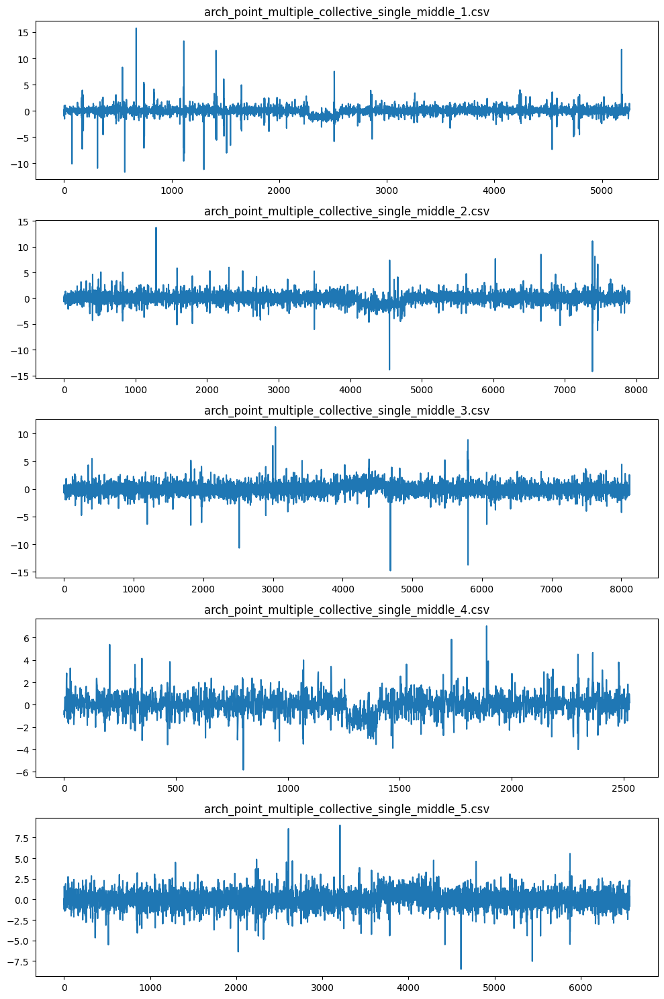

In [ ]:
plot_combinations("arch_pt_multiple_ct_single_middle_long")

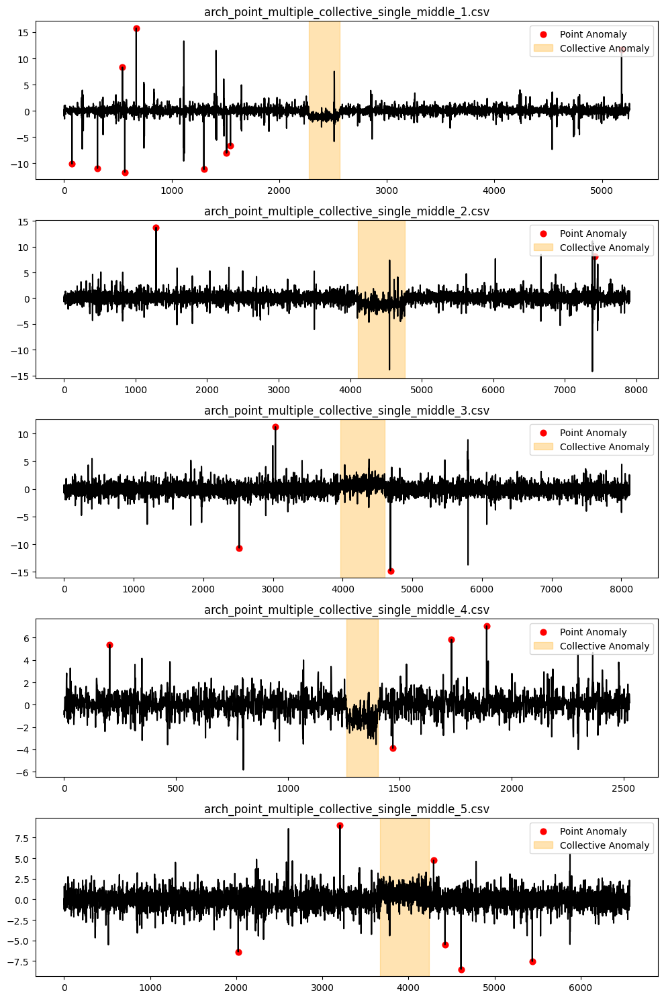

In [ ]:
enhanced_plot_combinations("arch_pt_multiple_ct_single_middle_long")

### Volatility + Point Anomaly + Mean Shift:

In [ ]:
def generate_volatility_with_point_and_mean_shift_dataset(
    folder,
    kind='arch',
    count=5,
    length_range=(300, 500),
    point_type='single',
    mean_shift_type='single',
    shift_type='increase',
    location_point="middle",
    location_mean="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    vol_label_map = {
        'arch': 'volatility_arch',
        'garch': 'volatility_garch',
        'egarch': 'volatility_egarch',
        'aparch': 'volatility_aparch'
    }

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)

        # base volatility series
        base_df = ts.generate_volatility(kind=kind)
        vol_params = base_df.attrs.get("vol_params", {})

        # Point anomaly
        if point_type == 'single':
            df = ts.generate_point_anomaly(base_df, location=location_point)
            is_multi_point_anomaly = 0
        elif point_type == 'multiple':
            df = ts.generate_point_anomalies(base_df)
            location_point = 0
            is_multi_point_anomaly = 1
        else:
            raise ValueError("Invalid point_type")

        # Mean shift
        if mean_shift_type == 'single':
            sign = 1 if shift_type == 'increase' else -1
            df, _ = ts.generate_mean_shift(df, signs=[sign], location=location_mean, num_breaks=1, return_debug=True)
            is_multi_mean_shift = 0
            shift_type_increase = 1 if shift_type == "increase" else 0
            shift_type_decrease = 1 if shift_type == "decrease" else 0
            loc_mean = location_mean
        elif mean_shift_type == 'multiple':
            num_breaks = np.random.randint(2, 4)
            signs = list(np.random.choice([-1, 1], size=num_breaks))
            df, _ = ts.generate_mean_shift(df, num_breaks=num_breaks, signs=signs, return_debug=True)
            is_multi_mean_shift = 1
            shift_type_increase = 0
            shift_type_decrease = 0
            loc_mean = "NA"
        else:
            raise ValueError("Invalid mean_shift_type")

        # Label
        label_parts = [kind, "point", point_type]
        if point_type == 'single':
            label_parts.append(location_point)
        label_parts += ["mean", mean_shift_type]
        if mean_shift_type == 'single':
            label_parts += [shift_type, location_mean]

        label = "_".join(str(p) for p in label_parts)
        filename = f"{label}_{i+1}.csv"
        df["label"] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        # Metadata
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            point_anomaly=1,
            mean_shift=1,
            shift_type_increase=shift_type_increase,
            shift_type_decrease=shift_type_decrease,
            location_point=location_point if point_type == 'single' else 0,
            location_mean_shift=loc_mean,
            is_multi_point_anomaly=is_multi_point_anomaly,
            is_multi_mean_shift=is_multi_mean_shift,
            volatility_arch=1 if kind == 'arch' else 0,
            volatility_garch=1 if kind == 'garch' else 0,
            volatility_egarch=1 if kind == 'egarch' else 0,
            volatility_aparch=1 if kind == 'aparch' else 0,
            vol_params=str(vol_params)
        )
        metadata.append(record)

    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "all_series.pkl"), "wb") as f:
        pickle.dump(metadata, f)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")



In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
vol_types = ['arch', 'garch', 'egarch', 'aparch']
point_types = ['single', 'multiple']
shift_types = ['increase', 'decrease']

for kind in vol_types:
    for size_label, length_range in length_ranges.items():
        for point_type in point_types:

            # SINGLE MEAN SHIFT
            for shift_type in shift_types:
                if point_type == 'single':
                    for loc_point in locations:
                        for loc_mean in locations:
                            folder = f"{kind}_pt_{point_type}_{loc_point}_ms_single_{shift_type}_{loc_mean}_{size_label}"
                            generate_volatility_with_point_and_mean_shift_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                point_type=point_type,
                                mean_shift_type="single",
                                shift_type=shift_type,
                                location_point=loc_point,
                                location_mean=loc_mean
                            )
                else:  # point multiple
                    for loc_mean in locations:
                        folder = f"{kind}_pt_{point_type}_ms_single_{shift_type}_{loc_mean}_{size_label}"
                        generate_volatility_with_point_and_mean_shift_dataset(
                            folder=folder,
                            kind=kind,
                            count=5,
                            length_range=length_range,
                            point_type=point_type,
                            mean_shift_type="single",
                            shift_type=shift_type,
                            location_mean=loc_mean
                        )

            # MULTIPLE MEAN SHIFT (konum ve shift tipi bilinemez)
            if point_type == 'single':
                for loc_point in locations:
                    folder = f"{kind}_pt_{point_type}_{loc_point}_ms_multiple_{size_label}"
                    generate_volatility_with_point_and_mean_shift_dataset(
                        folder=folder,
                        kind=kind,
                        count=5,
                        length_range=length_range,
                        point_type=point_type,
                        mean_shift_type="multiple",
                        location_point=loc_point
                    )
            else:
                folder = f"{kind}_pt_{point_type}_ms_multiple_{size_label}"
                generate_volatility_with_point_and_mean_shift_dataset(
                    folder=folder,
                    kind=kind,
                    count=5,
                    length_range=length_range,
                    point_type=point_type,
                    mean_shift_type="multiple"
                )


5 'arch_point_single_beginning_mean_single_increase_beginning' series saved in 'arch_pt_single_beginning_ms_single_increase_beginning_short' with metadata.
5 'arch_point_single_beginning_mean_single_increase_middle' series saved in 'arch_pt_single_beginning_ms_single_increase_middle_short' with metadata.
5 'arch_point_single_beginning_mean_single_increase_end' series saved in 'arch_pt_single_beginning_ms_single_increase_end_short' with metadata.
5 'arch_point_single_middle_mean_single_increase_beginning' series saved in 'arch_pt_single_middle_ms_single_increase_beginning_short' with metadata.
5 'arch_point_single_middle_mean_single_increase_middle' series saved in 'arch_pt_single_middle_ms_single_increase_middle_short' with metadata.
5 'arch_point_single_middle_mean_single_increase_end' series saved in 'arch_pt_single_middle_ms_single_increase_end_short' with metadata.
5 'arch_point_single_end_mean_single_increase_beginning' series saved in 'arch_pt_single_end_ms_single_increase_beginn

In [ ]:
generate_volatility_with_point_and_mean_shift_dataset(
    folder="egarch_pt_single_beginning_ms_single_increase_end_medium",
    kind="egarch",
    count=5,
    length_range=(300, 500),
    point_type="single",
    mean_shift_type="single",
    shift_type="increase",
    location_point="beginning",
    location_mean="end"
)

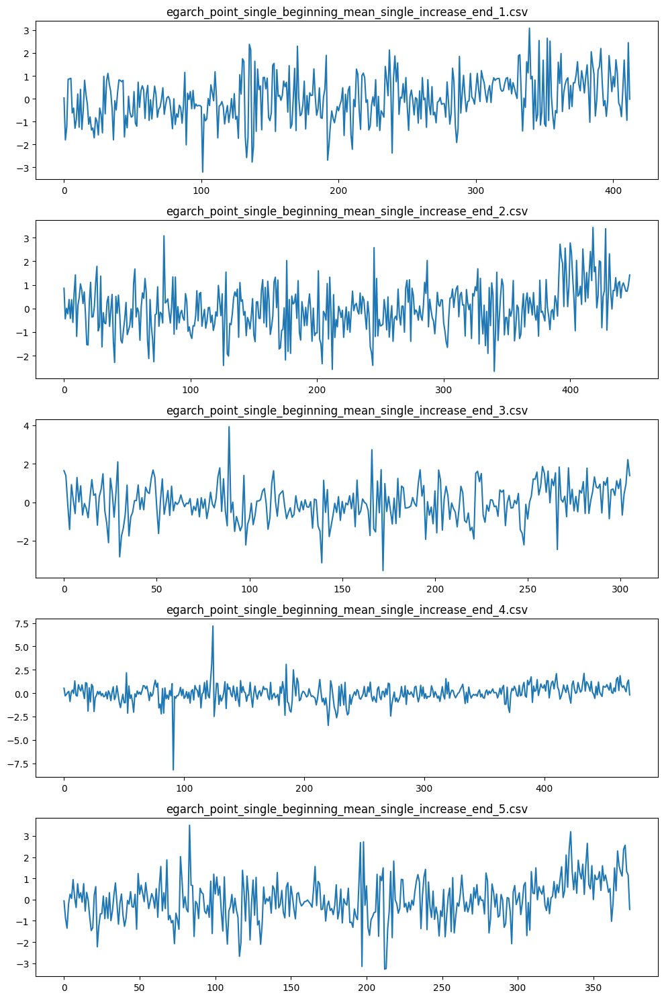

In [ ]:
plot_combinations("egarch_pt_single_beginning_ms_single_increase_end_medium")

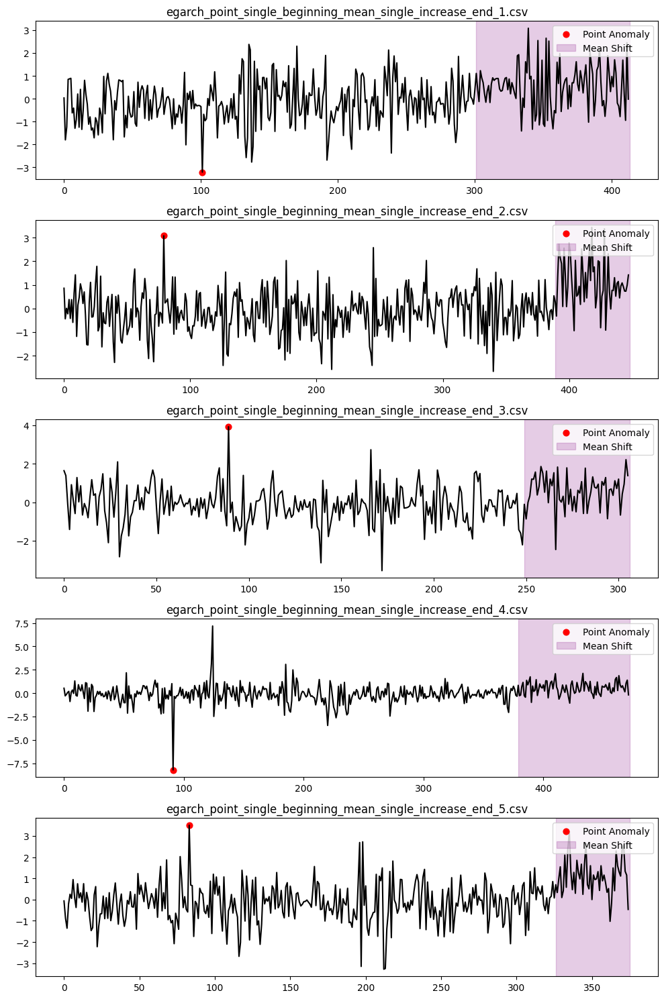

In [ ]:
enhanced_plot_point_and_mean_shift("egarch_pt_single_beginning_ms_single_increase_end_medium")

### Volatility + Point Anomaly + Variance Shift:

In [ ]:
def generate_volatility_with_point_and_variance_shift_dataset(
    folder,
    kind='arch',
    count=5,
    length_range=(300, 500),
    point_type='single',
    variance_shift_type='single',
    shift_type='increase',
    location_point="middle",
    location_variance="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    vol_label_map = {
        'arch': 'volatility_arch',
        'garch': 'volatility_garch',
        'egarch': 'volatility_egarch',
        'aparch': 'volatility_aparch'
    }

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_volatility(kind=kind)
        vol_params = base_df.attrs.get("vol_params", {})

        # Point anomaly
        if point_type == 'single':
            df = ts.generate_point_anomaly(base_df, location=location_point)
            is_multi_point_anomaly = 0
        elif point_type == 'multiple':
            df = ts.generate_point_anomalies(base_df)
            location_point = 0
            is_multi_point_anomaly = 1
        else:
            raise ValueError("Invalid point_type")

        # Variance shift
        if variance_shift_type == 'single':
            sign = 1 if shift_type == 'increase' else -1
            df = ts.generate_variance_shift(df, signs=[sign], location=location_variance, num_breaks=1)
            is_multi_variance_shift = 0
            shift_type_increase = int(sign == 1)
            shift_type_decrease = int(sign == -1)
            loc_variance = location_variance
        elif variance_shift_type == 'multiple':
            signs = list(np.random.choice([-1, 1], size=2))
            df = ts.generate_variance_shift(df, num_breaks=2, signs=signs)
            is_multi_variance_shift = 1
            shift_type_increase = 0
            shift_type_decrease = 0
            loc_variance = "NA"
        else:
            raise ValueError("Invalid variance_shift_type")

        # Label
        label_parts = [kind, "point", point_type]
        if point_type == 'single':
            label_parts.append(location_point)
        label_parts += ["vs", variance_shift_type]
        if variance_shift_type == 'single':
            label_parts += [shift_type, location_variance]

        label = "_".join(str(p) for p in label_parts)
        filename = f"{label}_{i+1}.csv"
        df["label"] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        # Metadata
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            point_anomaly=1,
            variance_shift=1,
            shift_type_increase=shift_type_increase,
            shift_type_decrease=shift_type_decrease,
            location_point=location_point if point_type == 'single' else 0,
            location_variance_shift=loc_variance,
            is_multi_point_anomaly=is_multi_point_anomaly,
            is_multi_variance_shift=is_multi_variance_shift,
            volatility_arch=1 if kind == 'arch' else 0,
            volatility_garch=1 if kind == 'garch' else 0,
            volatility_egarch=1 if kind == 'egarch' else 0,
            volatility_aparch=1 if kind == 'aparch' else 0,
            vol_params=str(vol_params)
        )
        metadata.append(record)

    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "all_series.pkl"), "wb") as f:
        pickle.dump(metadata, f)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")



In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}

locations = ['beginning', 'middle', 'end']
vol_types = ['arch', 'garch', 'egarch', 'aparch']
point_types = ['single', 'multiple']
shift_types = ['increase', 'decrease']

for kind in vol_types:
    for size_label, length_range in length_ranges.items():
        for point_type in point_types:

            # SINGLE VARIANCE SHIFT
            for shift_type in shift_types:
                if point_type == 'single':
                    for loc_point in locations:
                        for loc_var in locations:
                            folder = f"{kind}_pt_{point_type}_{loc_point}_vs_single_{shift_type}_{loc_var}_{size_label}"
                            generate_volatility_with_point_and_variance_shift_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                point_type=point_type,
                                variance_shift_type="single",
                                shift_type=shift_type,
                                location_point=loc_point,
                                location_variance=loc_var
                            )
                else:  # point multiple
                    for loc_var in locations:
                        folder = f"{kind}_pt_{point_type}_vs_single_{shift_type}_{loc_var}_{size_label}"
                        generate_volatility_with_point_and_variance_shift_dataset(
                            folder=folder,
                            kind=kind,
                            count=5,
                            length_range=length_range,
                            point_type=point_type,
                            variance_shift_type="single",
                            shift_type=shift_type,
                            location_variance=loc_var
                        )

            # MULTIPLE VARIANCE SHIFT
            if point_type == 'single':
                for loc_point in locations:
                    folder = f"{kind}_pt_{point_type}_{loc_point}_vs_multiple_{size_label}"
                    generate_volatility_with_point_and_variance_shift_dataset(
                        folder=folder,
                        kind=kind,
                        count=5,
                        length_range=length_range,
                        point_type=point_type,
                        variance_shift_type="multiple",
                        location_point=loc_point
                    )
            else:
                folder = f"{kind}_pt_{point_type}_vs_multiple_{size_label}"
                generate_volatility_with_point_and_variance_shift_dataset(
                    folder=folder,
                    kind=kind,
                    count=5,
                    length_range=length_range,
                    point_type=point_type,
                    variance_shift_type="multiple"
                )


5 'arch_point_single_beginning_vs_single_increase_beginning' series saved in 'arch_pt_single_beginning_vs_single_increase_beginning_short' with metadata.
5 'arch_point_single_beginning_vs_single_increase_middle' series saved in 'arch_pt_single_beginning_vs_single_increase_middle_short' with metadata.
5 'arch_point_single_beginning_vs_single_increase_end' series saved in 'arch_pt_single_beginning_vs_single_increase_end_short' with metadata.
5 'arch_point_single_middle_vs_single_increase_beginning' series saved in 'arch_pt_single_middle_vs_single_increase_beginning_short' with metadata.
5 'arch_point_single_middle_vs_single_increase_middle' series saved in 'arch_pt_single_middle_vs_single_increase_middle_short' with metadata.
5 'arch_point_single_middle_vs_single_increase_end' series saved in 'arch_pt_single_middle_vs_single_increase_end_short' with metadata.
5 'arch_point_single_end_vs_single_increase_beginning' series saved in 'arch_pt_single_end_vs_single_increase_beginning_short' wit

In [ ]:
generate_volatility_with_point_and_variance_shift_dataset(
    folder="egarch_pt_multiple_vs_single_increase_end_long",
    kind="egarch",
    count=5,
    length_range=(1000, 10000),
    point_type="multiple",
    variance_shift_type="single",
    shift_type="increase",
    location_variance="end"
)

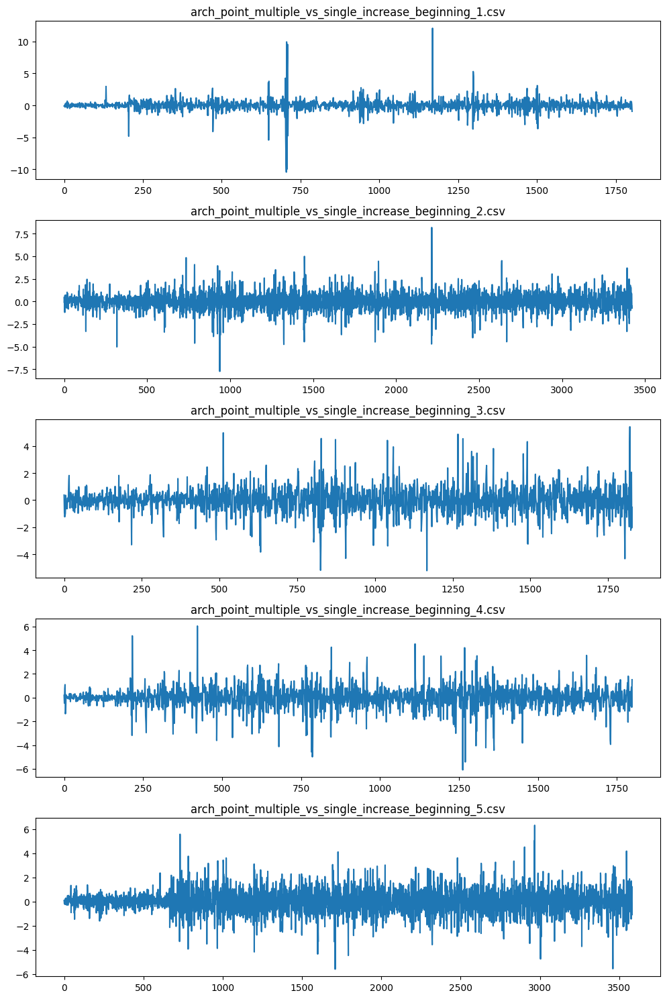

In [ ]:
plot_combinations("arch_pt_multiple_vs_single_increase_beginning_long")

In [ ]:
import os
import ast
import re
import pandas as pd
import matplotlib.pyplot as plt

def parse_indices(value, mode="default"):
    if pd.isna(value):
        return []
    if isinstance(value, str):
        try:
            if mode == "variance":
                value = re.sub(r'np\.int64\((\d+)\)', r'\1', value)
            elif mode == "point":
                value = value.replace('[', '').replace(']', '').split()
                return [int(x) for x in value]
            return list(map(int, ast.literal_eval(value)))
        except:
            return []
    elif isinstance(value, list):
        return [int(v) for v in value]
    return []

def enhanced_plot_point_and_variance_shift(folder, n=5):
    files = sorted([f for f in os.listdir(folder) if f.endswith('.csv') and f != 'metadata.csv'])[:n]

    plt.figure(figsize=(10, 3 * n))
    for i, fname in enumerate(files):
        df = pd.read_csv(os.path.join(folder, fname))
        df.columns = df.columns.str.strip()

        ax = plt.subplot(n, 1, i + 1)
        ax.plot(df['data'], label='Data')

        # Noktasal anomali (kırmızı nokta)
        if 'point_anom_location' in df.columns:
            points = parse_indices(df['point_anom_location'].iloc[0], mode="point")
            for j, p in enumerate(points):
                if 0 <= p < len(df):
                    ax.scatter(p, df['data'].iloc[p], color='red', s=40, marker='o', label='Point Anomaly' if j == 0 else None)

        # Varyans kayması (yeşil kesikli çizgi)
        if 'variance_shift_points' in df.columns:
            shifts = parse_indices(df['variance_shift_points'].iloc[0], mode="variance")
            for j, s in enumerate(shifts):
                if 0 <= s < len(df):
                    ax.axvline(s, linestyle='--', color='green', linewidth=2, label='Variance Shift' if j == 0 else None)

        ax.set_title(fname)
        ax.legend(loc='upper right')

    plt.tight_layout()
    plt.show()


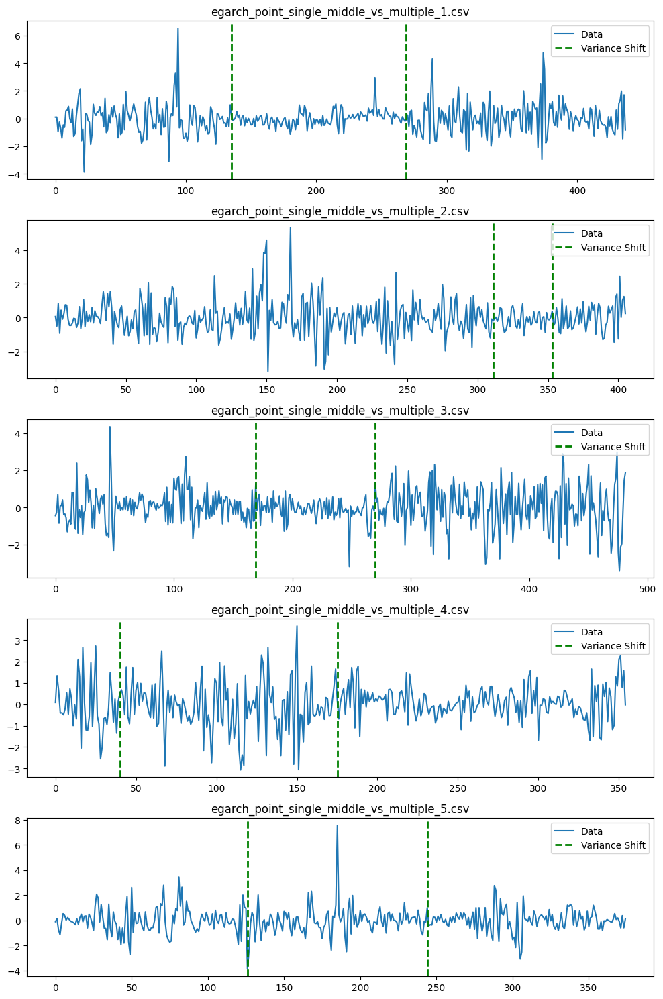

In [ ]:
enhanced_plot_point_and_variance_shift("egarch_pt_single_middle_vs_multiple_medium")

### Volatility + Collective Anomaly + Mean Shift:

In [ ]:
def generate_volatility_with_collective_and_mean_shift_dataset(
    folder,
    kind='arch',
    count=5,
    length_range=(300, 500),
    collective_type='single',
    mean_shift_type='single',
    location_collective="middle",
    location_mean="middle",
    shift_type="increase"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    vol_label_map = {
        'arch': 'volatility_arch',
        'garch': 'volatility_garch',
        'egarch': 'volatility_egarch',
        'aparch': 'volatility_aparch'
    }

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_volatility(kind=kind)
        vol_params = base_df.attrs.get("vol_params", {})

        # Collective anomaly
        if collective_type == 'single':
            df = ts.generate_collective_anomalies(base_df, num_anomalies=1, location=location_collective)
            is_multi_collective_anomaly = 0
            loc_collective = location_collective
        elif collective_type == 'multiple':
            df = ts.generate_collective_anomalies(base_df, num_anomalies=np.random.randint(2, 5))
            is_multi_collective_anomaly = 1
            loc_collective = 0
        else:
            raise ValueError("Invalid collective_type")

        # Mean shift
        if mean_shift_type == 'single':
            sign = 1 if shift_type == 'increase' else -1
            df, _ = ts.generate_mean_shift(df, signs=[sign], location=location_mean, num_breaks=1, return_debug=True)
            is_multi_mean_shift = 0
            shift_type_increase = 1 if shift_type == "increase" else 0
            shift_type_decrease = 1 if shift_type == "decrease" else 0
            loc_mean = location_mean
        elif mean_shift_type == 'multiple':
            num_breaks = np.random.randint(2, 4)
            signs = list(np.random.choice([-1, 1], size=num_breaks))
            df, _ = ts.generate_mean_shift(df, num_breaks=num_breaks, signs=signs, return_debug=True)
            is_multi_mean_shift = 1
            shift_type_increase = 0
            shift_type_decrease = 0
            loc_mean = 0
        else:
            raise ValueError("Invalid mean_shift_type")

        # Label
        label_parts = [kind, "collective", collective_type]
        if collective_type == 'single':
            label_parts.append(location_collective)
        label_parts += ["mean", mean_shift_type]
        if mean_shift_type == 'single':
            label_parts += [shift_type, location_mean]

        label = "_".join(str(p) for p in label_parts)
        filename = f"{label}_{i+1}.csv"
        df["label"] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        # Metadata
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            collective_anomaly=1,
            mean_shift=1,
            shift_type_increase=shift_type_increase,
            shift_type_decrease=shift_type_decrease,
            location_collective=loc_collective if collective_type == 'single' else 0,
            location_mean_shift=loc_mean,
            is_multi_collective_anomaly=is_multi_collective_anomaly,
            is_multi_mean_shift=is_multi_mean_shift,
            volatility_arch=1 if kind == 'arch' else 0,
            volatility_garch=1 if kind == 'garch' else 0,
            volatility_egarch=1 if kind == 'egarch' else 0,
            volatility_aparch=1 if kind == 'aparch' else 0,
            vol_params=str(vol_params)
        )
        metadata.append(record)

    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "all_series.pkl"), "wb") as f:
        pickle.dump(metadata, f)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")



In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
types = ['arch', 'garch', 'egarch', 'aparch']
collective_types = ['single', 'multiple']
shift_types = ['increase', 'decrease']

for kind in types:
    for size_label, length_range in length_ranges.items():
        for collective_type in collective_types:

            # SINGLE MEAN SHIFT
            for shift_type in shift_types:
                if collective_type == 'single':
                    for loc_collective in locations:
                        for loc_mean in locations:
                            folder = f"{kind}_ct_{collective_type}_{loc_collective}_ms_single_{shift_type}_{loc_mean}_{size_label}"
                            generate_volatility_with_collective_and_mean_shift_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                collective_type=collective_type,
                                mean_shift_type="single",
                                shift_type=shift_type,
                                location_collective=loc_collective,
                                location_mean=loc_mean
                            )
                else:
                    for loc_mean in locations:
                        folder = f"{kind}_ct_{collective_type}_ms_single_{shift_type}_{loc_mean}_{size_label}"
                        generate_volatility_with_collective_and_mean_shift_dataset(
                            folder=folder,
                            kind=kind,
                            count=5,
                            length_range=length_range,
                            collective_type=collective_type,
                            mean_shift_type="single",
                            shift_type=shift_type,
                            location_mean=loc_mean
                        )

            # MULTIPLE MEAN SHIFT
            if collective_type == 'single':
                for loc_collective in locations:
                    folder = f"{kind}_ct_{collective_type}_{loc_collective}_ms_multiple_{size_label}"
                    generate_volatility_with_collective_and_mean_shift_dataset(
                        folder=folder,
                        kind=kind,
                        count=5,
                        length_range=length_range,
                        collective_type=collective_type,
                        mean_shift_type="multiple",
                        location_collective=loc_collective
                    )
            else:
                folder = f"{kind}_ct_{collective_type}_ms_multiple_{size_label}"
                generate_volatility_with_collective_and_mean_shift_dataset(
                    folder=folder,
                    kind=kind,
                    count=5,
                    length_range=length_range,
                    collective_type=collective_type,
                    mean_shift_type="multiple"
                )



5 'arch_collective_single_beginning_mean_single_increase_beginning' series saved in 'arch_ct_single_beginning_ms_single_increase_beginning_short' with metadata.
5 'arch_collective_single_beginning_mean_single_increase_middle' series saved in 'arch_ct_single_beginning_ms_single_increase_middle_short' with metadata.
5 'arch_collective_single_beginning_mean_single_increase_end' series saved in 'arch_ct_single_beginning_ms_single_increase_end_short' with metadata.
5 'arch_collective_single_middle_mean_single_increase_beginning' series saved in 'arch_ct_single_middle_ms_single_increase_beginning_short' with metadata.
5 'arch_collective_single_middle_mean_single_increase_middle' series saved in 'arch_ct_single_middle_ms_single_increase_middle_short' with metadata.
5 'arch_collective_single_middle_mean_single_increase_end' series saved in 'arch_ct_single_middle_ms_single_increase_end_short' with metadata.
5 'arch_collective_single_end_mean_single_increase_beginning' series saved in 'arch_ct_s

In [ ]:
generate_volatility_with_collective_and_mean_shift_dataset(
    folder="garch_ct_single_beginning_ms_single_increase_middle_long",
    kind="garch",
    count=5,
    length_range=(1000, 10000),
    collective_type="single",
    mean_shift_type="single",
    shift_type="increase",
    location_collective="beginning",
    location_mean="middle"
)

5 'garch_collective_single_beginning_mean_single_increase_middle' series saved in 'garch_ct_single_beginning_ms_single_increase_middle_long' with metadata.


In [ ]:
import shutil
folder_garch_ct_single_beginning_ms_single_increase_middle_long = "garch_ct_single_beginning_ms_single_increase_middle_long"
shutil.make_archive(folder_garch_ct_single_beginning_ms_single_increase_middle_long, 'zip', folder_garch_ct_single_beginning_ms_single_increase_middle_long)
from google.colab import files
files.download("garch_ct_single_beginning_ms_single_increase_middle_long.zip")

FileNotFoundError: [Errno 2] No such file or directory: 'garch_ct_single_beginning_ms_single_increase_middle_long'

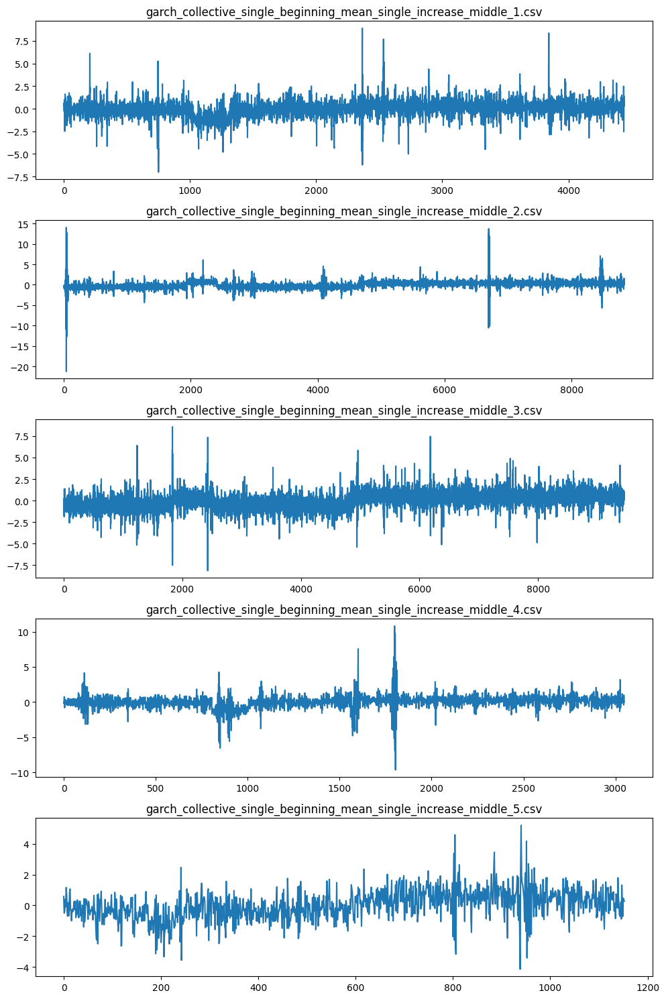

In [ ]:
plot_combinations("garch_ct_single_beginning_ms_single_increase_middle_long")

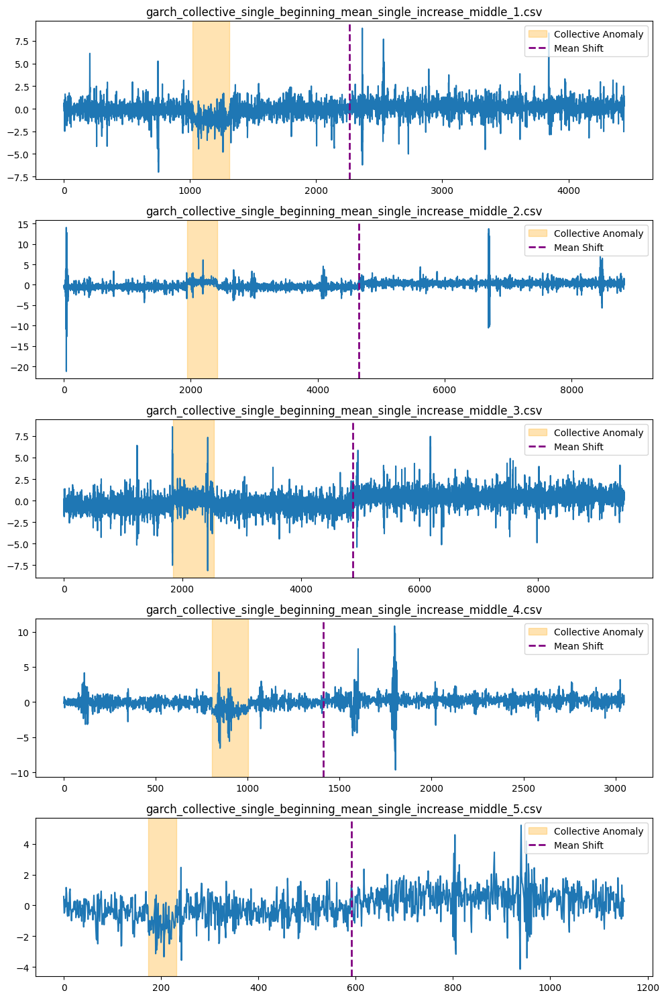

In [ ]:
enhanced_plot_collective_and_mean_shift("garch_ct_single_beginning_ms_single_increase_middle_long")

### Volatility + Collective Anomaly + Variance Shift:

In [ ]:
import os
import numpy as np
import pandas as pd
import pickle


def generate_volatility_with_collective_and_variance_shift_dataset(
    folder,
    kind='arch',
    count=5,
    length_range=(300, 500),
    collective_type='single',
    variance_shift_type='single',
    shift_type='increase',
    location_collective="middle",
    location_variance="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    vol_label_map = {
        'arch': 'volatility_arch',
        'garch': 'volatility_garch',
        'egarch': 'volatility_egarch',
        'aparch': 'volatility_aparch'
    }

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_volatility(kind=kind)
        vol_params = base_df.attrs.get("vol_params", {})

        # Collective anomaly
        if collective_type == 'single':
            df = ts.generate_collective_anomalies(base_df, num_anomalies=1, location=location_collective)
            is_multi_collective_anomaly = 0
            loc_collective = location_collective
        elif collective_type == 'multiple':
            df = ts.generate_collective_anomalies(base_df, num_anomalies=np.random.randint(2, 5))
            is_multi_collective_anomaly = 1
            loc_collective = 0
        else:
            raise ValueError("Invalid collective_type")

        # Variance shift
        if variance_shift_type == 'single':
            sign = 1 if shift_type == 'increase' else -1
            df = ts.generate_variance_shift(df, signs=[sign], location=location_variance, num_breaks=1)
            is_multi_variance_shift = 0
            shift_type_increase = int(sign == 1)
            shift_type_decrease = int(sign == -1)
            loc_variance = location_variance
        elif variance_shift_type == 'multiple':
            signs = list(np.random.choice([-1, 1], size=2))
            df = ts.generate_variance_shift(df, num_breaks=2, signs=signs)
            is_multi_variance_shift = 1
            shift_type_increase = 0
            shift_type_decrease = 0
            loc_variance = "NA"
        else:
            raise ValueError("Invalid variance_shift_type")

        # Label
        label_parts = [kind, "collective", collective_type]
        if collective_type == 'single':
            label_parts.append(location_collective)
        label_parts += ["vs", variance_shift_type]
        if variance_shift_type == 'single':
            label_parts += [shift_type, location_variance]

        label = "_".join(str(p) for p in label_parts)
        filename = f"{label}_{i+1}.csv"
        df["label"] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        # Metadata
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            collective_anomaly=1,
            variance_shift=1,
            shift_type_increase=shift_type_increase,
            shift_type_decrease=shift_type_decrease,
            location_collective=loc_collective if collective_type == 'single' else 0,
            location_variance_shift=loc_variance,
            is_multi_collective_anomaly=is_multi_collective_anomaly,
            is_multi_variance_shift=is_multi_variance_shift,
            volatility_arch=1 if kind == 'arch' else 0,
            volatility_garch=1 if kind == 'garch' else 0,
            volatility_egarch=1 if kind == 'egarch' else 0,
            volatility_aparch=1 if kind == 'aparch' else 0,
            vol_params=str(vol_params)
        )
        metadata.append(record)

    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "all_series.pkl"), "wb") as f:
        pickle.dump(metadata, f)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")


In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
volatility_types = ['arch', 'garch', 'egarch', 'aparch']
collective_types = ['single', 'multiple']
shift_types = ['increase', 'decrease']

# Uyarlandığı fonksiyon: generate_volatility_with_collective_and_variance_shift_dataset
for kind in volatility_types:
    for size_label, length_range in length_ranges.items():
        for collective_type in collective_types:

            # SINGLE VARIANCE SHIFT
            for shift_type in shift_types:
                if collective_type == 'single':
                    for loc_collective in locations:
                        for loc_var in locations:
                            folder = f"{kind}_ct_{collective_type}_{loc_collective}_vs_single_{shift_type}_{loc_var}_{size_label}"
                            generate_volatility_with_collective_and_variance_shift_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                collective_type=collective_type,
                                variance_shift_type="single",
                                shift_type=shift_type,
                                location_collective=loc_collective,
                                location_variance=loc_var
                            )
                else:
                    for loc_var in locations:
                        folder = f"{kind}_ct_{collective_type}_vs_single_{shift_type}_{loc_var}_{size_label}"
                        generate_volatility_with_collective_and_variance_shift_dataset(
                            folder=folder,
                            kind=kind,
                            count=5,
                            length_range=length_range,
                            collective_type=collective_type,
                            variance_shift_type="single",
                            shift_type=shift_type,
                            location_variance=loc_var
                        )

            # MULTIPLE VARIANCE SHIFT
            if collective_type == 'single':
                for loc_collective in locations:
                    folder = f"{kind}_ct_{collective_type}_{loc_collective}_vs_multiple_{size_label}"
                    generate_volatility_with_collective_and_variance_shift_dataset(
                        folder=folder,
                        kind=kind,
                        count=5,
                        length_range=length_range,
                        collective_type=collective_type,
                        variance_shift_type="multiple",
                        location_collective=loc_collective
                    )
            else:
                folder = f"{kind}_ct_{collective_type}_vs_multiple_{size_label}"
                generate_volatility_with_collective_and_variance_shift_dataset(
                    folder=folder,
                    kind=kind,
                    count=5,
                    length_range=length_range,
                    collective_type=collective_type,
                    variance_shift_type="multiple"
                )


5 'arch_collective_single_beginning_vs_single_increase_beginning' series saved in 'arch_ct_single_beginning_vs_single_increase_beginning_short' with metadata.
5 'arch_collective_single_beginning_vs_single_increase_middle' series saved in 'arch_ct_single_beginning_vs_single_increase_middle_short' with metadata.
5 'arch_collective_single_beginning_vs_single_increase_end' series saved in 'arch_ct_single_beginning_vs_single_increase_end_short' with metadata.
5 'arch_collective_single_middle_vs_single_increase_beginning' series saved in 'arch_ct_single_middle_vs_single_increase_beginning_short' with metadata.
5 'arch_collective_single_middle_vs_single_increase_middle' series saved in 'arch_ct_single_middle_vs_single_increase_middle_short' with metadata.
5 'arch_collective_single_middle_vs_single_increase_end' series saved in 'arch_ct_single_middle_vs_single_increase_end_short' with metadata.
5 'arch_collective_single_end_vs_single_increase_beginning' series saved in 'arch_ct_single_end_vs_s

In [ ]:
generate_volatility_with_collective_and_variance_shift_dataset(
    folder="egarch_ct_single_middle_vs_single_decrease_end_medium",
    kind="egarch",
    count=5,
    length_range=(300, 500),
    collective_type="single",
    variance_shift_type="single",
    shift_type="decrease",
    location_collective="middle",
    location_variance="end"
)



5 'egarch_collective_single_middle_vs_single_decrease_end' series saved in 'egarch_ct_single_middle_vs_single_decrease_end_medium' with metadata.


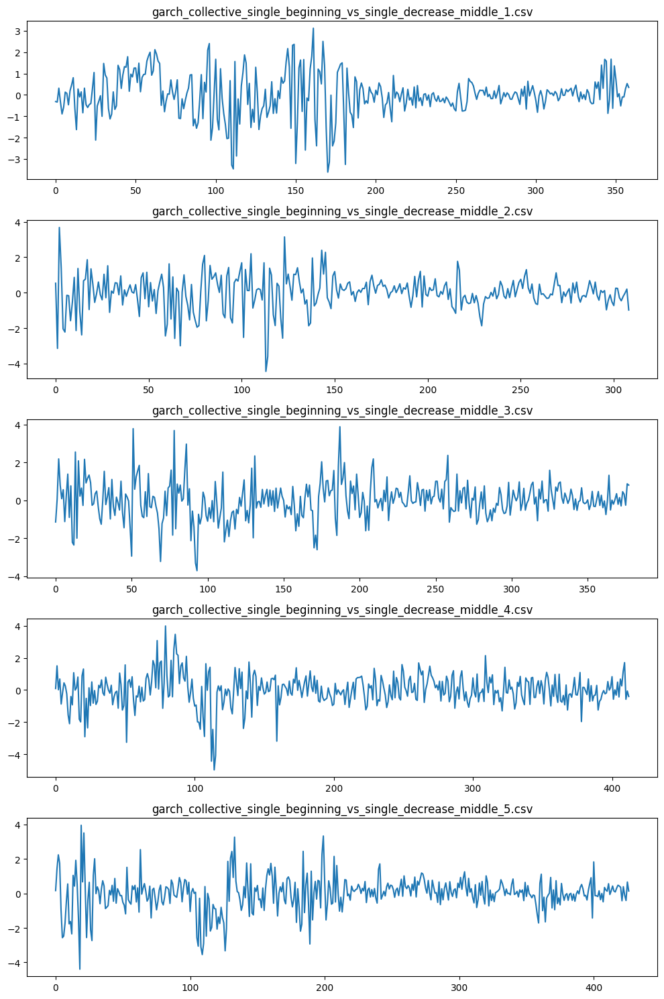

In [ ]:
plot_combinations("garch_ct_single_beginning_vs_single_decrease_middle_medium")

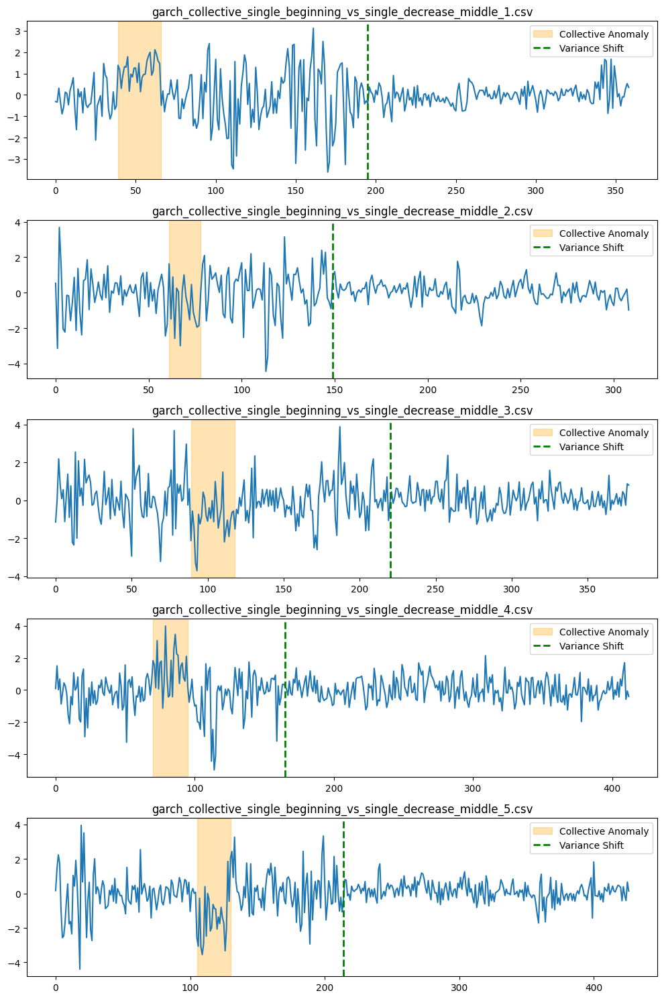

In [ ]:
enhanced_plot_collective_and_variance_shift("garch_ct_single_beginning_vs_single_decrease_middle_medium")

In [ ]:
import shutil
folder_garch_ct_single_beginning_vs_single_decrease_middle_medium = "garch_ct_single_beginning_vs_single_decrease_middle_medium"
shutil.make_archive(folder_garch_ct_single_beginning_vs_single_decrease_middle_medium, 'zip', folder_garch_ct_single_beginning_vs_single_decrease_middle_medium)
from google.colab import files
files.download("garch_ct_single_beginning_vs_single_decrease_middle_medium.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Volatility + Mean Shift + Variance Shift:

In [ ]:
def generate_volatility_with_mean_and_variance_shift_dataset(
    folder,
    kind='arch',
    count=5,
    length_range=(300, 500),
    mean_shift_type='single',
    variance_shift_type='single',
    shift_type_mean='increase',
    shift_type_variance='increase',
    location_mean="middle",
    location_variance="middle"
):
    os.makedirs(folder, exist_ok=True)
    metadata = []

    vol_label_map = {
        'arch': 'volatility_arch',
        'garch': 'volatility_garch',
        'egarch': 'volatility_egarch',
        'aparch': 'volatility_aparch'
    }

    for i in range(count):
        length = np.random.randint(*length_range)
        ts = TimeSeriesGenerator(length=length)
        base_df = ts.generate_volatility(kind=kind)
        vol_params = base_df.attrs.get("vol_params", {})

        df = base_df

        # Mean shift
        if mean_shift_type == 'single':
            sign_mean = 1 if shift_type_mean == 'increase' else -1
            df, _ = ts.generate_mean_shift(df, signs=[sign_mean], location=location_mean, num_breaks=1, return_debug=True)
            is_multi_mean_shift = 0
            shift_type_increase = int(sign_mean == 1)
            shift_type_decrease = int(sign_mean == -1)
            loc_mean = location_mean
        elif mean_shift_type == 'multiple':
            num_breaks = np.random.randint(2, 4)
            signs = list(np.random.choice([-1, 1], size=num_breaks))
            df, _ = ts.generate_mean_shift(df, num_breaks=num_breaks, signs=signs, return_debug=True)
            is_multi_mean_shift = 1
            shift_type_increase = 0
            shift_type_decrease = 0
            loc_mean = 0
        else:
            raise ValueError("Invalid mean_shift_type")

        # Variance shift
        if variance_shift_type == 'single':
            sign_var = 1 if shift_type_variance == 'increase' else -1
            df = ts.generate_variance_shift(df, signs=[sign_var], location=location_variance, num_breaks=1)
            is_multi_variance_shift = 0
            loc_variance = location_variance
        elif variance_shift_type == 'multiple':
            signs = list(np.random.choice([-1, 1], size=2))
            df = ts.generate_variance_shift(df, num_breaks=2, signs=signs)
            is_multi_variance_shift = 1
            loc_variance = 0
        else:
            raise ValueError("Invalid variance_shift_type")

        # Label oluştur
        label_parts = [kind, "ms", mean_shift_type]
        if mean_shift_type == 'single':
            label_parts += [shift_type_mean, location_mean]
        label_parts += ["vs", variance_shift_type]
        if variance_shift_type == 'single':
            label_parts += [shift_type_variance, location_variance]

        label = "_".join(str(p) for p in label_parts)
        filename = f"{label}_{i+1}.csv"
        df["label"] = label
        df.to_csv(os.path.join(folder, filename), index=False)

        # Metadata
        record = create_metadata_record(
            filename=filename,
            length=length,
            label=label,
            mean_shift=1,
            variance_shift=1,
            shift_type_increase=shift_type_increase,
            shift_type_decrease=shift_type_decrease,
            location_mean_shift=loc_mean,
            location_variance_shift=loc_variance,
            is_multi_mean_shift=is_multi_mean_shift,
            is_multi_variance_shift=is_multi_variance_shift,
            volatility_arch=1 if kind == 'arch' else 0,
            volatility_garch=1 if kind == 'garch' else 0,
            volatility_egarch=1 if kind == 'egarch' else 0,
            volatility_aparch=1 if kind == 'aparch' else 0,
            vol_params=str(vol_params)
        )
        metadata.append(record)

    pd.DataFrame(metadata).to_csv(os.path.join(folder, "metadata.csv"), index=False)
    with open(os.path.join(folder, "all_series.pkl"), "wb") as f:
        pickle.dump(metadata, f)

    print(f"{count} '{label}' series saved in '{folder}' with metadata.")


In [ ]:
length_ranges = {
    "short": (50, 100),
    "medium": (300, 500),
    "long": (1000, 10000)
}
locations = ['beginning', 'middle', 'end']
volatility_types = ['arch', 'garch', 'egarch', 'aparch']
shift_types = ['increase', 'decrease']

for kind in volatility_types:
    for size_label, length_range in length_ranges.items():
        for mean_shift_type in ['single', 'multiple']:
            for variance_shift_type in ['single', 'multiple']:

                # Durum: her ikisi de tekil
                if mean_shift_type == 'single' and variance_shift_type == 'single':
                    for shift_type_mean in shift_types:
                        for shift_type_var in shift_types:
                            for loc_mean in locations:
                                for loc_var in locations:
                                    folder = f"{kind}_ms_single_{shift_type_mean}_{loc_mean}_vs_single_{shift_type_var}_{loc_var}_{size_label}"
                                    generate_volatility_with_mean_and_variance_shift_dataset(
                                        folder=folder,
                                        kind=kind,
                                        count=5,
                                        length_range=length_range,
                                        mean_shift_type="single",
                                        variance_shift_type="single",
                                        shift_type_mean=shift_type_mean,
                                        shift_type_variance=shift_type_var,
                                        location_mean=loc_mean,
                                        location_variance=loc_var
                                    )

                elif mean_shift_type == 'multiple' and variance_shift_type == 'single':
                    for shift_type_var in shift_types:
                        for loc_var in locations:
                            folder = f"{kind}_ms_multiple_vs_single_{shift_type_var}_{loc_var}_{size_label}"
                            generate_volatility_with_mean_and_variance_shift_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                mean_shift_type="multiple",
                                variance_shift_type="single",
                                shift_type_variance=shift_type_var,
                                location_variance=loc_var
                            )

                elif mean_shift_type == 'single' and variance_shift_type == 'multiple':
                    for shift_type_mean in shift_types:
                        for loc_mean in locations:
                            folder = f"{kind}_ms_single_{shift_type_mean}_{loc_mean}_vs_multiple_{size_label}"
                            generate_volatility_with_mean_and_variance_shift_dataset(
                                folder=folder,
                                kind=kind,
                                count=5,
                                length_range=length_range,
                                mean_shift_type="single",
                                variance_shift_type="multiple",
                                shift_type_mean=shift_type_mean,
                                location_mean=loc_mean
                            )

                else:
                    folder = f"{kind}_ms_multiple_vs_multiple_{size_label}"
                    generate_volatility_with_mean_and_variance_shift_dataset(
                        folder=folder,
                        kind=kind,
                        count=5,
                        length_range=length_range,
                        mean_shift_type="multiple",
                        variance_shift_type="multiple"
                    )


5 'arch_ms_single_increase_beginning_vs_single_increase_beginning' series saved in 'arch_ms_single_increase_beginning_vs_single_increase_beginning_short' with metadata.
5 'arch_ms_single_increase_beginning_vs_single_increase_middle' series saved in 'arch_ms_single_increase_beginning_vs_single_increase_middle_short' with metadata.
5 'arch_ms_single_increase_beginning_vs_single_increase_end' series saved in 'arch_ms_single_increase_beginning_vs_single_increase_end_short' with metadata.
5 'arch_ms_single_increase_middle_vs_single_increase_beginning' series saved in 'arch_ms_single_increase_middle_vs_single_increase_beginning_short' with metadata.
5 'arch_ms_single_increase_middle_vs_single_increase_middle' series saved in 'arch_ms_single_increase_middle_vs_single_increase_middle_short' with metadata.
5 'arch_ms_single_increase_middle_vs_single_increase_end' series saved in 'arch_ms_single_increase_middle_vs_single_increase_end_short' with metadata.
5 'arch_ms_single_increase_end_vs_single

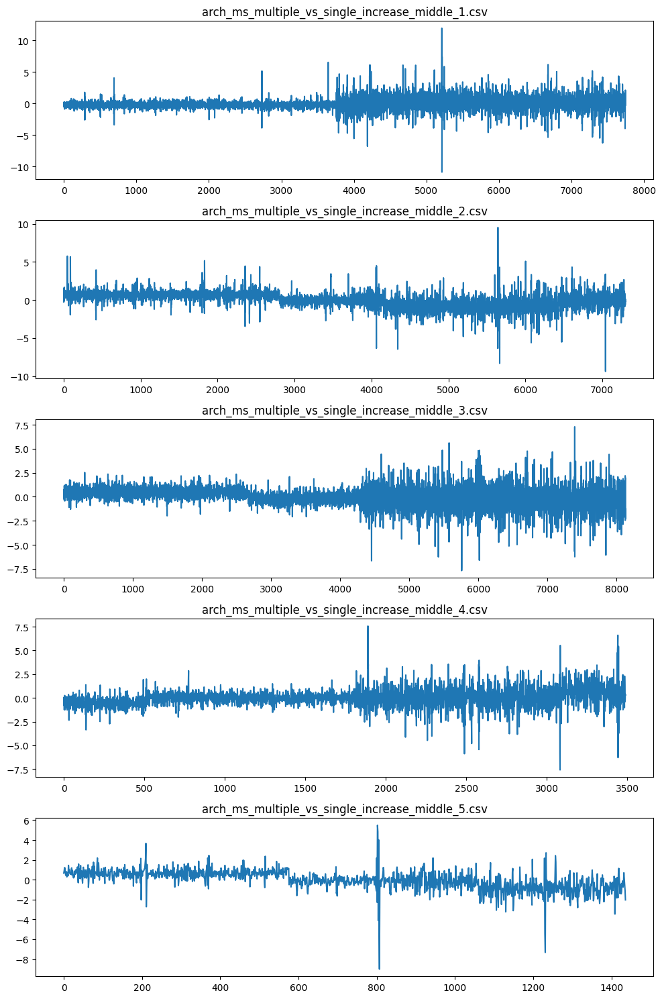

In [ ]:
plot_combinations("arch_ms_multiple_vs_single_increase_middle_long")

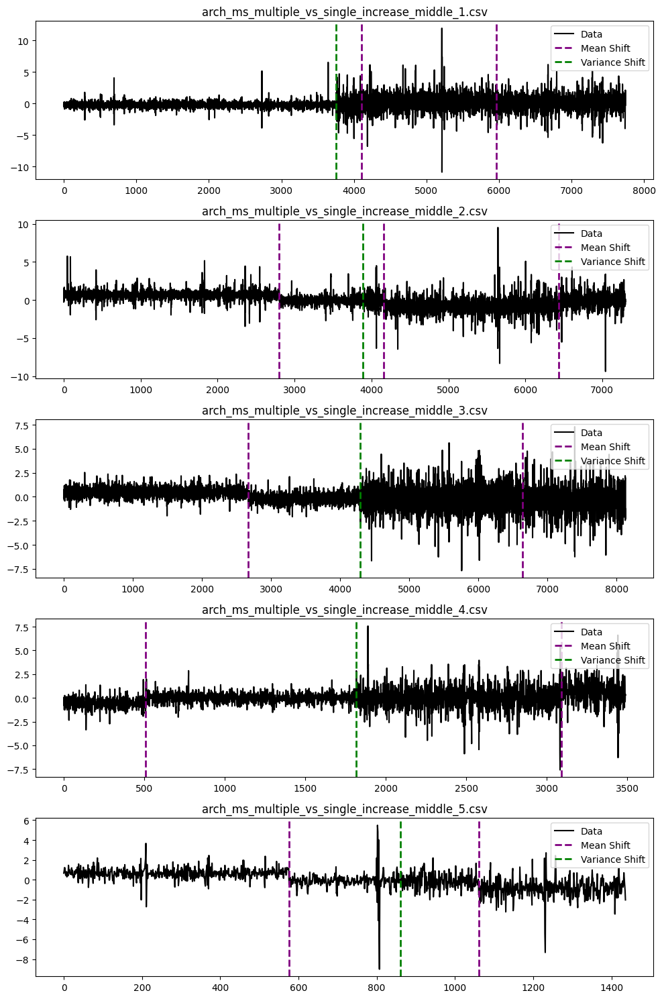

In [ ]:
enhanced_plot_mean_and_variance_shift("arch_ms_multiple_vs_single_increase_middle_long")

In [ ]:

folder_arch_ms_multiple_vs_single_increase_middle_long = "arch_ms_multiple_vs_single_increase_middle_long"
shutil.make_archive(folder_arch_ms_multiple_vs_single_increase_middle_long, 'zip', folder_arch_ms_multiple_vs_single_increase_middle_long)
from google.colab import files
files.download("arch_ms_multiple_vs_single_increase_middle_long.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

##Github

In [1]:
!git config --global user.name "Pelin Erkaya"
!git config --global user.email "pelinerkaya2000@gmail.com"

In [2]:
!git clone https://github.com/PelinErkaya/1001Pelin.git
%cd /content/1001Pelin

Cloning into '1001Pelin'...
/content/1001Pelin


In [3]:
!cp -r /content/*.ipynb /content/1001Pelin/

cp: cannot stat '/content/*.ipynb': No such file or directory
